In [ ]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

In [1]:
import tensorflow as tf
from tensorflow.keras import layers, Model

from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, Callback
import time
from tensorflow.keras.utils import plot_model
import numpy as np
from sklearn.model_selection import KFold
import os
import glob

2025-09-20 18:47:32.682700: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1758394052.877927      36 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1758394052.933588      36 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


In [2]:
import os
import tensorflow as tf
import numpy as np
import glob

BASE_PATH = "/kaggle/input/dataset/new_data"

# Define folders for train, validation, and test
TRAIN_IMAGES_DIR = os.path.join(BASE_PATH, "train", "images")
TRAIN_MASKS_DIR = os.path.join(BASE_PATH, "train", "GT_TE")

VAL_IMAGES_DIR = os.path.join(BASE_PATH, "valid", "images")
VAL_MASKS_DIR = os.path.join(BASE_PATH, "valid", "GT_TE")

TEST_IMAGES_DIR = os.path.join(BASE_PATH, "test", "images")
TEST_MASKS_DIR = os.path.join(BASE_PATH, "test", "GT_TE")

# Check if files are loaded correctly
print("Train images:", len(os.listdir(TRAIN_IMAGES_DIR)))
print("Train masks:", len(os.listdir(TRAIN_MASKS_DIR)))
print("Validation images:", len(os.listdir(VAL_IMAGES_DIR)))
print("Validation masks:", len(os.listdir(VAL_MASKS_DIR)))
print("Test images:", len(os.listdir(TEST_IMAGES_DIR)))
print("Test masks:", len(os.listdir(TEST_MASKS_DIR)))

IMG_HEIGHT = 256
IMG_WIDTH = 256


def load_image(image_path, mask_path):
    """Load and preprocess a single image-mask pair"""
    # Load image
    image = tf.io.read_file(image_path)
    image = tf.image.decode_bmp(image, channels=3)  # decode as RGB
    image = tf.image.rgb_to_grayscale(image)        # convert to grayscale
    image = tf.image.resize(image, [IMG_HEIGHT, IMG_WIDTH])
    image = tf.cast(image, tf.float32) / 255.0

    # Load mask
    mask = tf.io.read_file(mask_path)
    mask = tf.image.decode_bmp(mask, channels=3)
    mask = tf.image.rgb_to_grayscale(mask)
    mask = tf.image.resize(mask, [IMG_HEIGHT, IMG_WIDTH])
    mask = tf.cast(mask, tf.float32) / 255.0
    mask = tf.where(mask > 0.5, 1.0, 0.0)  # binarize

    return image, mask


def create_dataset(image_dir, mask_dir, batch_size=8, shuffle=True):
    """Create tf.data dataset for training, validation, or testing"""
    image_paths = sorted(glob.glob(os.path.join(image_dir, "*.bmp")))
    mask_paths = sorted(glob.glob(os.path.join(mask_dir, "*.bmp")))

    print(f"Found {len(image_paths)} images and {len(mask_paths)} masks in {image_dir}")

    dataset = tf.data.Dataset.from_tensor_slices((image_paths, mask_paths))
    dataset = dataset.map(load_image, num_parallel_calls=tf.data.AUTOTUNE)

    if shuffle:
        dataset = dataset.shuffle(buffer_size=100)

    return dataset.batch(batch_size).prefetch(tf.data.AUTOTUNE)



BATCH_SIZE = 16
train_dataset = create_dataset(TRAIN_IMAGES_DIR, TRAIN_MASKS_DIR, batch_size=BATCH_SIZE)
val_dataset = create_dataset(VAL_IMAGES_DIR, VAL_MASKS_DIR, batch_size=BATCH_SIZE, shuffle=False)
test_dataset = create_dataset(TEST_IMAGES_DIR, TEST_MASKS_DIR, batch_size=1, shuffle=False)


Train images: 995
Train masks: 995
Validation images: 25
Validation masks: 25
Test images: 25
Test masks: 25
Found 995 images and 995 masks in /kaggle/input/dataset/new_data/train/images


I0000 00:00:1758394072.209761      36 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 15513 MB memory:  -> device: 0, name: Tesla P100-PCIE-16GB, pci bus id: 0000:00:04.0, compute capability: 6.0


Found 25 images and 25 masks in /kaggle/input/dataset/new_data/valid/images
Found 25 images and 25 masks in /kaggle/input/dataset/new_data/test/images


In [3]:
import tensorflow as tf
from tensorflow.keras import layers, Model

class ChannelAttentionBridge(layers.Layer):
    def __init__(self, c_list, split_att="fc", name="CAB", **kwargs):
        super(ChannelAttentionBridge, self).__init__(name=name, **kwargs)
        self.split_att = split_att
        self.c_list = c_list
        c_list_sum = sum(c_list)

        # Shared Conv1D for local info fusion
        self.conv1d = layers.Conv1D(1, kernel_size=3, padding="same", use_bias=False)

        # Fully connected per stage for global info fusion
        if split_att == "fc":
            self.fc_layers = [
                layers.Dense(c, activation="sigmoid") for c in c_list
            ]
        else:  # alternative: Conv1D
            self.fc_layers = [
                layers.Conv1D(c, kernel_size=1, activation="sigmoid")
                for c in c_list
            ]

    def call(self, features):
        # features = [t1, t2, t3, t4, t5]
        pooled = [tf.reduce_mean(f, axis=[1, 2], keepdims=True) for f in features]  # GAP
        pooled = [tf.squeeze(f, axis=[1, 2]) for f in pooled]  # (B, C)

        concat = tf.concat(pooled, axis=-1)  # (B, sum(C))

        # Local fusion with Conv1D
        concat_exp = tf.expand_dims(concat, axis=1)  # (B, 1, sumC)
        att = self.conv1d(concat_exp)  # (B, 1, 1)
        att = tf.squeeze(att, axis=1)  # (B, sumC)

        # Global fusion per stage
        out_features = []
        for i, (f, fc) in enumerate(zip(features, self.fc_layers)):
            att_i = fc(att)  # (B, Ci)
            att_i = tf.reshape(att_i, [-1, 1, 1, self.c_list[i]])
            att_i = tf.broadcast_to(att_i, tf.shape(f))
            out_features.append(f * att_i + f)  # apply attention + residual

        return out_features


In [4]:
from tensorflow.keras import layers, models

# ------------------ U-Net with CAB ------------------
def unet_with_channel_attention(input_shape=(256,256,1)):
    inputs = layers.Input(input_shape, name="input_layer")

    # ----- Encoder -----
    c1 = layers.Conv2D(64, 3, activation='relu', padding='same', name="enc_c1a")(inputs)
    c1 = layers.Conv2D(64, 3, activation='relu', padding='same', name="enc_c1b")(c1)
    p1 = layers.MaxPooling2D((2, 2), name="pool1")(c1)

    c2 = layers.Conv2D(128, 3, activation='relu', padding='same', name="enc_c2a")(p1)
    c2 = layers.Conv2D(128, 3, activation='relu', padding='same', name="enc_c2b")(c2)
    p2 = layers.MaxPooling2D((2, 2), name="pool2")(c2)

    c3 = layers.Conv2D(256, 3, activation='relu', padding='same', name="enc_c3a")(p2)
    c3 = layers.Conv2D(256, 3, activation='relu', padding='same', name="enc_c3b")(c3)
    p3 = layers.MaxPooling2D((2, 2), name="pool3")(c3)

    c4 = layers.Conv2D(512, 3, activation='relu', padding='same', name="enc_c4a")(p3)
    c4 = layers.Conv2D(512, 3, activation='relu', padding='same', name="enc_c4b")(c4)
    p4 = layers.MaxPooling2D((2, 2), name="pool4")(c4)

    # ----- Bottleneck -----
    bn = layers.Conv2D(1024, 3, activation='relu', padding='same', name="bottleneck1")(p4)
    bn = layers.Conv2D(1024, 3, activation='relu', padding='same', name="bottleneck2")(bn)

    # ----- Channel Attention Bridge -----
    cab = ChannelAttentionBridge([64, 128, 256, 512, 1024])
    c1, c2, c3, c4, bn = cab([c1, c2, c3, c4, bn])  # apply CAB

    # ----- Decoder -----
    u6 = layers.Conv2DTranspose(512, 2, strides=(2, 2), padding='same', name="up6")(bn)
    u6 = layers.concatenate([u6, c4], axis=3, name="concat6")
    c6 = layers.Conv2D(512, 3, activation='relu', padding='same', name="dec_c6a")(u6)
    c6 = layers.Conv2D(512, 3, activation='relu', padding='same', name="dec_c6b")(c6)

    u7 = layers.Conv2DTranspose(256, 2, strides=(2, 2), padding='same', name="up7")(c6)
    u7 = layers.concatenate([u7, c3], axis=3, name="concat7")
    c7 = layers.Conv2D(256, 3, activation='relu', padding='same', name="dec_c7a")(u7)
    c7 = layers.Conv2D(256, 3, activation='relu', padding='same', name="dec_c7b")(c7)

    u8 = layers.Conv2DTranspose(128, 2, strides=(2, 2), padding='same', name="up8")(c7)
    u8 = layers.concatenate([u8, c2], axis=3, name="concat8")
    c8 = layers.Conv2D(128, 3, activation='relu', padding='same', name="dec_c8a")(u8)
    c8 = layers.Conv2D(128, 3, activation='relu', padding='same', name="dec_c8b")(c8)

    u9 = layers.Conv2DTranspose(64, 2, strides=(2, 2), padding='same', name="up9")(c8)
    u9 = layers.concatenate([u9, c1], axis=3, name="concat9")
    c9 = layers.Conv2D(64, 3, activation='relu', padding='same', name="dec_c9a")(u9)
    c9 = layers.Conv2D(64, 3, activation='relu', padding='same', name="dec_c9b")(c9)

    outputs = layers.Conv2D(1, 1, activation='sigmoid', name="output_layer")(c9)

    model = models.Model(inputs=inputs, outputs=outputs, name="UNet_with_CAB")
    return model

# ---------------- Test ----------------
model = unet_with_channel_attention(input_shape=(256,256,1))
model.summary()


Model: "UNet_with_CAB"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c1a (Conv2D)    │ (None, 256, 256,  │        640 │ input_layer[0][0] │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c1b (Conv2D)    │ (None, 256, 256,  │     36,928 │ enc_c1a[0][0]     │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1               │ (None, 128, 128,  │          0 │ enc_c1b[0][0]     │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c2a (Conv2D)    │ (None, 128, 128,  │     73,856 │ pool1[0][0]       │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c2b (Conv2D)    │ (None, 128, 128,  │    147,584 │ enc_c2a[0][0]     │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool2               │ (None, 64, 64,    │          0 │ enc_c2b[0][0]     │
│ (MaxPooling2D)      │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c3a (Conv2D)    │ (None, 64, 64,    │    295,168 │ pool2[0][0]       │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c3b (Conv2D)    │ (None, 64, 64,    │    590,080 │ enc_c3a[0][0]     │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool3               │ (None, 32, 32,    │          0 │ enc_c3b[0][0]     │
│ (MaxPooling2D)      │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c4a (Conv2D)    │ (None, 32, 32,    │  1,180,160 │ pool3[0][0]       │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c4b (Conv2D)    │ (None, 32, 32,    │  2,359,808 │ enc_c4a[0][0]     │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool4               │ (None, 16, 16,    │          0 │ enc_c4b[0][0]     │
│ (MaxPooling2D)      │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bottleneck1         │ (None, 16, 16,    │  4,719,616 │ pool4[0][0]       │
│ (Conv2D)            │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bottleneck2         │ (None, 16, 16,    │  9,438,208 │ bottleneck1[0][0] │
│ (Conv2D)            │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ CAB                 │ [(None, 256, 256, │      9,920 │ enc_c1b[0][0],    │
│ (ChannelAttentionB… │ 64), (None, 128,  │            │ enc_c2b[0][0],    │
│                     │ 128, 128), (None, │            │ enc_c3b[0][0],    │
│                     │ 64, 64, 256),     │            │ enc_c4b[0][0],  

 Total params: 31,040,513 (118.41 MB)

 Trainable params: 31,040,513 (118.41 MB)

 Non-trainable params: 0 (0.00 B)

In [5]:
def dice_coefficient(y_true, y_pred, smooth=1e-6):
    y_true_f = tf.keras.backend.flatten(y_true)
    y_pred_f = tf.keras.backend.flatten(y_pred)
    intersection = tf.reduce_sum(y_true_f * y_pred_f)
    return (2. * intersection + smooth) / (tf.reduce_sum(y_true_f) + tf.reduce_sum(y_pred_f) + smooth)

def iou_metric(y_true, y_pred, smooth=1e-6):
    y_true_f = tf.keras.backend.flatten(y_true)
    y_pred_f = tf.keras.backend.flatten(y_pred)
    intersection = tf.reduce_sum(y_true_f * y_pred_f)
    union = tf.reduce_sum(y_true_f) + tf.reduce_sum(y_pred_f) - intersection
    return (intersection + smooth) / (union + smooth)

def bce_dice_loss(y_true, y_pred):
    bce = tf.keras.losses.BinaryCrossentropy()(y_true, y_pred)
    dice_loss = 1 - dice_coefficient(y_true, y_pred)
    return bce + dice_loss

In [6]:
# -------------------------
# Image loader
# -------------------------
def load_only_image(image_path):
    img = tf.io.read_file(image_path)
    img = tf.image.decode_bmp(img, channels=3)   # decode as RGB
    img = tf.image.resize(img, [256, 256])
    img = tf.image.rgb_to_grayscale(img)         # convert to 1 channel
    img = tf.cast(img, tf.float32) / 255.0
    return img

def load_image(image_path, mask_path):
    img = load_only_image(image_path)
    mask = load_only_image(mask_path)
    return img, mask


In [7]:
# -------------------------
# Attention map visualizer callback
# -------------------------
class AttentionMapLogger(Callback):
    def __init__(self, sample_image, every_n_epochs=5, save_dir="attention_maps"):
        super().__init__()
        self.sample_image = tf.expand_dims(sample_image, axis=0)  # add batch dim
        self.every_n_epochs = every_n_epochs
        self.save_dir = save_dir
        os.makedirs(save_dir, exist_ok=True)

    def save_attention_maps(self, feature_maps, stage_name, epoch):
        # feature_maps: tensor of shape (1, H, W, C)
        fmap = feature_maps[0]  # remove batch
        fmap_mean = tf.reduce_mean(fmap, axis=-1)  # collapse channels -> (H,W)
        fmap_min = tf.reduce_min(fmap_mean)
        fmap_max = tf.reduce_max(fmap_mean)
        fmap_norm = (fmap_mean - fmap_min) / (fmap_max - fmap_min + 1e-6)

        plt.figure(figsize=(5,5))
        plt.imshow(fmap_norm, cmap='jet')
        plt.axis('off')
        plt.title(f"{stage_name} Epoch {epoch}")
        plt.savefig(os.path.join(self.save_dir, f"{stage_name}_epoch{epoch}.png"))
        plt.close()
    def on_epoch_end(self, epoch, logs=None):
        if (epoch + 1) % self.every_n_epochs != 0:
            return

        # Run the model on the sample image and fetch attention maps
        # Assumes your model returns a list of attention feature maps as second output
        # Or that you have a model subclass which exposes encoder/decoder feature maps
        attention_features = self.model.get_attention_features(self.sample_image)  # custom function

        for i, fmap in enumerate(attention_features):
            stage_name = f"stage_{i+1}"
            self.save_attention_maps(fmap, stage_name, epoch + 1)





In [8]:
import matplotlib.pyplot as plt
import time
from sklearn.model_selection import KFold
import numpy as np
import glob
import tensorflow as tf
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint


--- Fold 1 ---
Epoch 1/300


I0000 00:00:1758394115.770283      95 service.cc:148] XLA service 0x7cf614002440 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1758394115.771125      95 service.cc:156]   StreamExecutor device (0): Tesla P100-PCIE-16GB, Compute Capability 6.0
I0000 00:00:1758394116.957292      95 cuda_dnn.cc:529] Loaded cuDNN version 90300
I0000 00:00:1758394138.990623      95 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


 99/100 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step - accuracy: 0.8721 - dice_coefficient: 0.1900 - iou_metric: 0.1063 - loss: 1.2939

E0000 00:00:1758394161.819450      95 gpu_timer.cc:82] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1758394162.078604      95 gpu_timer.cc:82] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.


100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 356ms/step - accuracy: 0.8721 - dice_coefficient: 0.1907 - iou_metric: 0.1068 - loss: 1.2918

E0000 00:00:1758394186.132834      95 gpu_timer.cc:82] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1758394186.366272      95 gpu_timer.cc:82] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1758394186.985006      95 gpu_timer.cc:82] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1758394187.241201      95 gpu_timer.cc:82] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.


100/100 ━━━━━━━━━━━━━━━━━━━━ 89s 542ms/step - accuracy: 0.8721 - dice_coefficient: 0.1914 - iou_metric: 0.1073 - loss: 1.2899 - val_accuracy: 0.8317 - val_dice_coefficient: 0.5793 - val_iou_metric: 0.4094 - val_loss: 0.6252
Epoch 2/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 234ms/step - accuracy: 0.8234 - dice_coefficient: 0.5935 - iou_metric: 0.4241 - loss: 0.6215 - val_accuracy: 0.8572 - val_dice_coefficient: 0.6179 - val_iou_metric: 0.4495 - val_loss: 0.5708
Epoch 3/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 233ms/step - accuracy: 0.8336 - dice_coefficient: 0.6561 - iou_metric: 0.4894 - loss: 0.5375 - val_accuracy: 0.8487 - val_dice_coefficient: 0.6484 - val_iou_metric: 0.4814 - val_loss: 0.5051
Epoch 4/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 231ms/step - accuracy: 0.8424 - dice_coefficient: 0.7134 - iou_metric: 0.5556 - loss: 0.4523 - val_accuracy: 0.8518 - val_dice_coefficient: 0.7132 - val_iou_metric: 0.5567 - val_loss: 0.4409
Epoch 5/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step - accuracy: 0

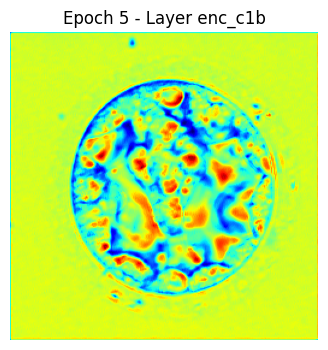

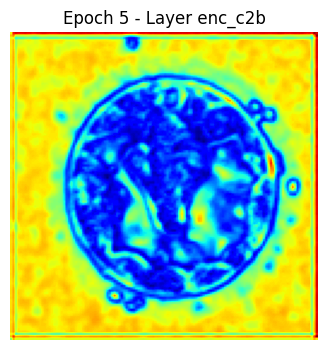

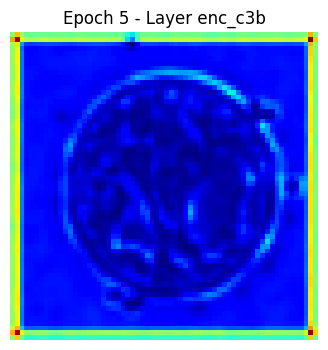

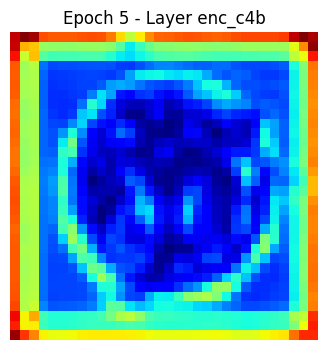

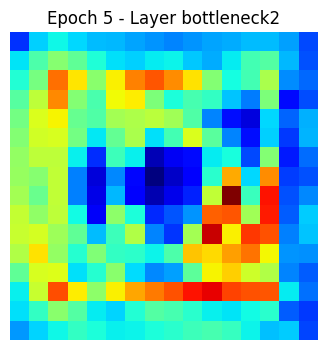

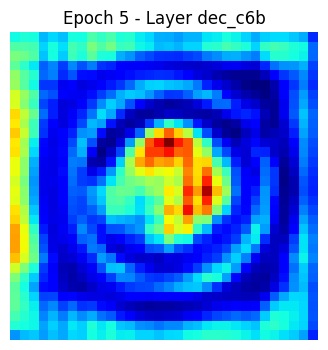

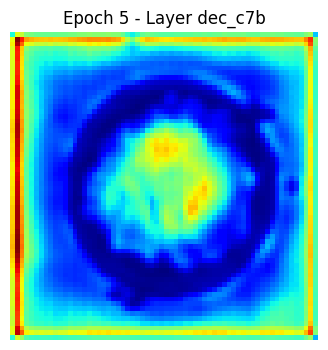

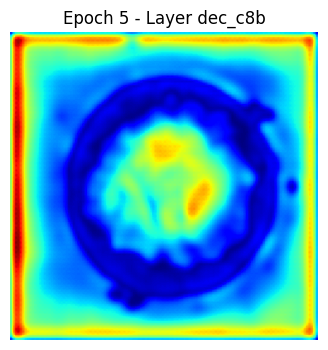

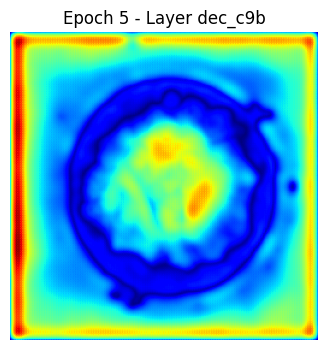

100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 236ms/step - accuracy: 0.8456 - dice_coefficient: 0.7462 - iou_metric: 0.5958 - loss: 0.4022 - val_accuracy: 0.8570 - val_dice_coefficient: 0.7060 - val_iou_metric: 0.5478 - val_loss: 0.4313
Epoch 6/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 231ms/step - accuracy: 0.8486 - dice_coefficient: 0.7581 - iou_metric: 0.6112 - loss: 0.3830 - val_accuracy: 0.8574 - val_dice_coefficient: 0.7142 - val_iou_metric: 0.5578 - val_loss: 0.4153
Epoch 7/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 231ms/step - accuracy: 0.8502 - dice_coefficient: 0.7738 - iou_metric: 0.6322 - loss: 0.3568 - val_accuracy: 0.8618 - val_dice_coefficient: 0.7418 - val_iou_metric: 0.5923 - val_loss: 0.3880
Epoch 8/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 232ms/step - accuracy: 0.8532 - dice_coefficient: 0.7892 - iou_metric: 0.6524 - loss: 0.3340 - val_accuracy: 0.8545 - val_dice_coefficient: 0.7539 - val_iou_metric: 0.6077 - val_loss: 0.3787
Epoch 9/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 231ms/step - accuracy: 

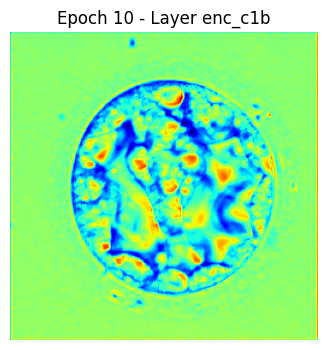

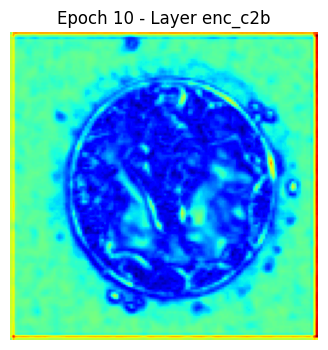

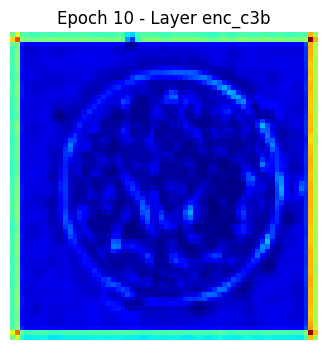

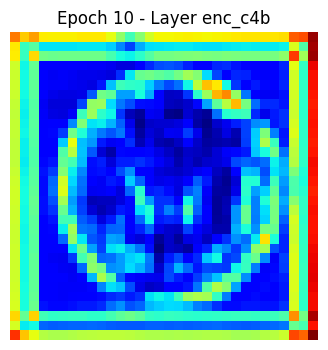

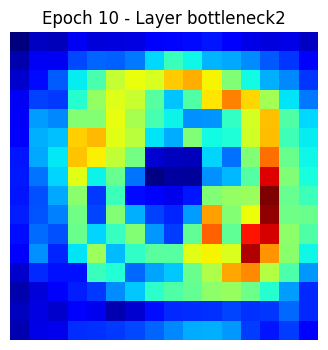

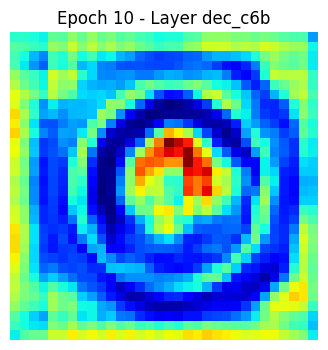

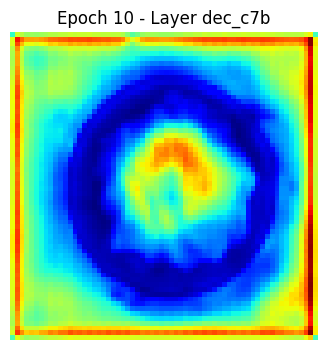

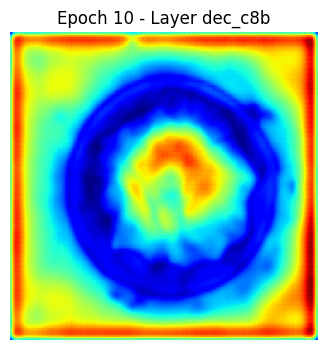

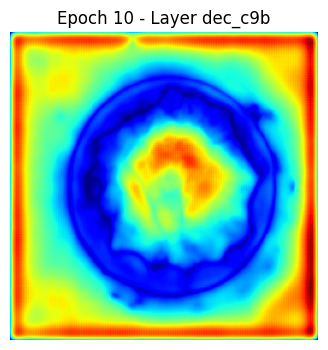

100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 239ms/step - accuracy: 0.8545 - dice_coefficient: 0.8108 - iou_metric: 0.6827 - loss: 0.3022 - val_accuracy: 0.8589 - val_dice_coefficient: 0.7792 - val_iou_metric: 0.6417 - val_loss: 0.3566
Epoch 11/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 231ms/step - accuracy: 0.8564 - dice_coefficient: 0.8204 - iou_metric: 0.6962 - loss: 0.2864 - val_accuracy: 0.8548 - val_dice_coefficient: 0.7828 - val_iou_metric: 0.6464 - val_loss: 0.3613
Epoch 12/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 231ms/step - accuracy: 0.8568 - dice_coefficient: 0.8257 - iou_metric: 0.7039 - loss: 0.2794 - val_accuracy: 0.8590 - val_dice_coefficient: 0.7880 - val_iou_metric: 0.6536 - val_loss: 0.3392
Epoch 13/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 219ms/step - accuracy: 0.8579 - dice_coefficient: 0.8334 - iou_metric: 0.7154 - loss: 0.2649 - val_accuracy: 0.8631 - val_dice_coefficient: 0.7874 - val_iou_metric: 0.6531 - val_loss: 0.3451
Epoch 14/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 231ms/step - accura

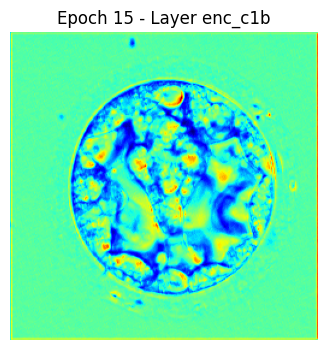

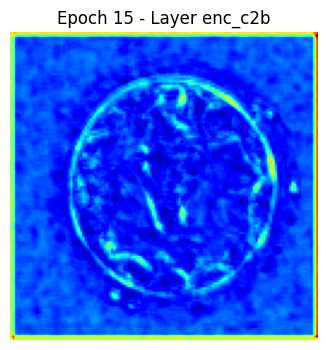

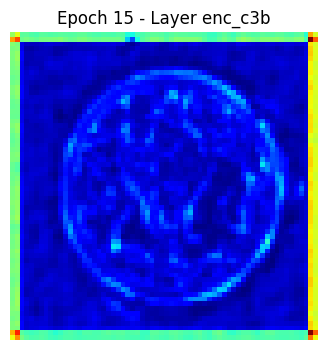

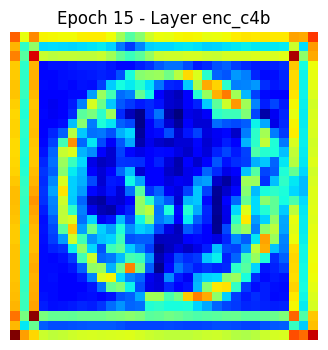

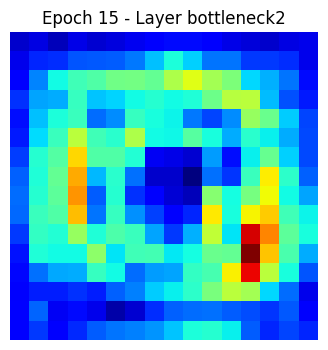

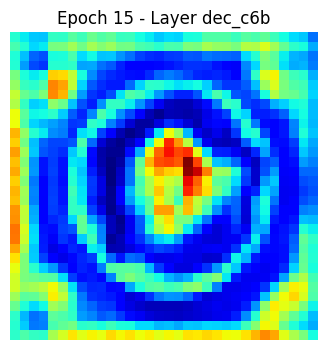

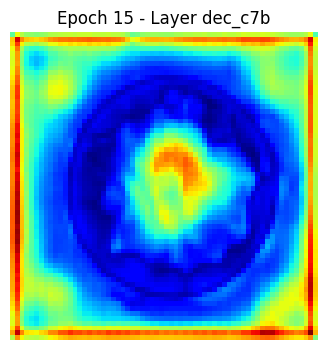

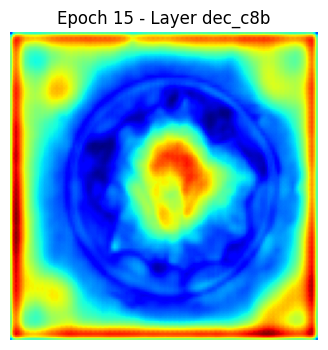

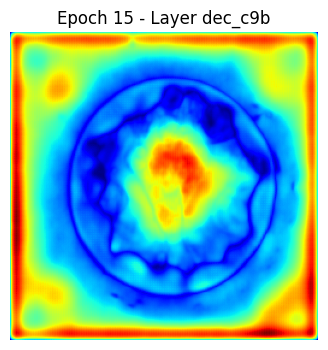

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 226ms/step - accuracy: 0.8590 - dice_coefficient: 0.8435 - iou_metric: 0.7301 - loss: 0.2545 - val_accuracy: 0.8592 - val_dice_coefficient: 0.7837 - val_iou_metric: 0.6476 - val_loss: 0.3424
Epoch 16/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 219ms/step - accuracy: 0.8607 - dice_coefficient: 0.8535 - iou_metric: 0.7452 - loss: 0.2357 - val_accuracy: 0.8614 - val_dice_coefficient: 0.7906 - val_iou_metric: 0.6569 - val_loss: 0.3398
Epoch 17/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 231ms/step - accuracy: 0.8610 - dice_coefficient: 0.8558 - iou_metric: 0.7489 - loss: 0.2320 - val_accuracy: 0.8639 - val_dice_coefficient: 0.8016 - val_iou_metric: 0.6726 - val_loss: 0.3352
Epoch 18/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 219ms/step - accuracy: 0.8620 - dice_coefficient: 0.8644 - iou_metric: 0.7620 - loss: 0.2192 - val_accuracy: 0.8686 - val_dice_coefficient: 0.7941 - val_iou_metric: 0.6625 - val_loss: 0.3430
Epoch 19/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 219ms/step - accura

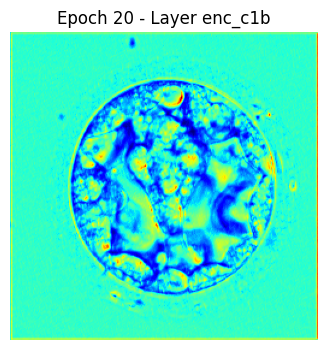

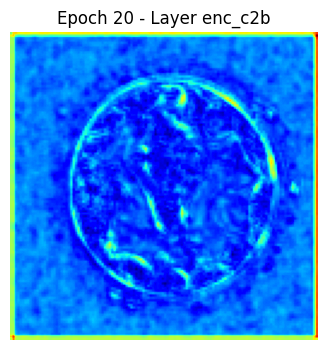

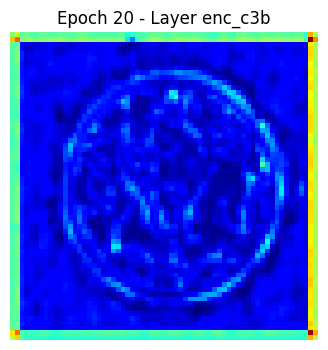

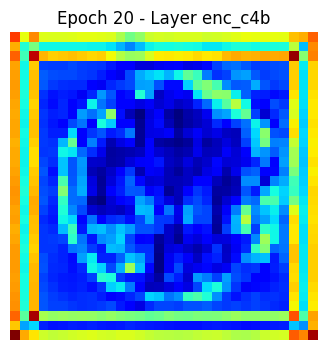

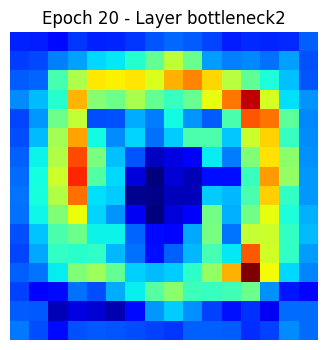

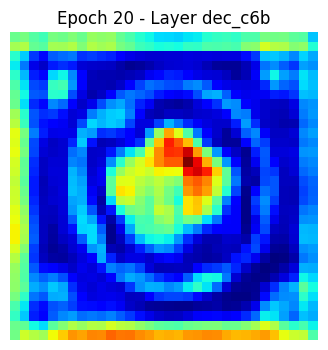

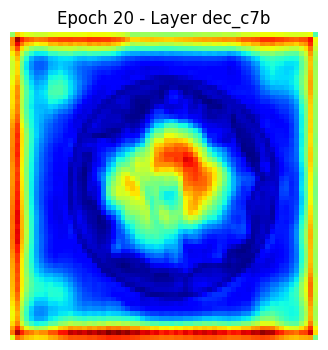

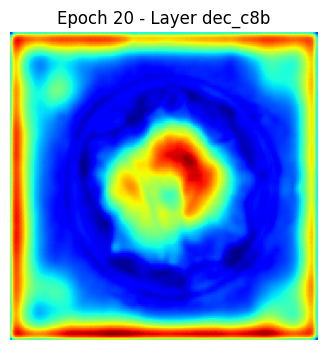

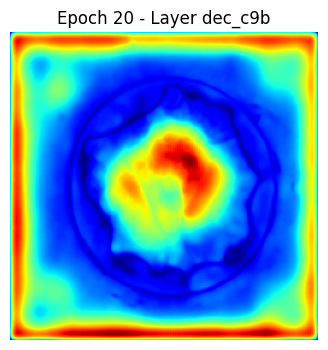

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 226ms/step - accuracy: 0.8640 - dice_coefficient: 0.8692 - iou_metric: 0.7694 - loss: 0.2091 - val_accuracy: 0.8637 - val_dice_coefficient: 0.7924 - val_iou_metric: 0.6596 - val_loss: 0.3452
Epoch 21/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 219ms/step - accuracy: 0.8639 - dice_coefficient: 0.8800 - iou_metric: 0.7864 - loss: 0.1935 - val_accuracy: 0.8669 - val_dice_coefficient: 0.7719 - val_iou_metric: 0.6316 - val_loss: 0.3404
Epoch 22/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 219ms/step - accuracy: 0.8644 - dice_coefficient: 0.8787 - iou_metric: 0.7844 - loss: 0.1938 - val_accuracy: 0.8645 - val_dice_coefficient: 0.8008 - val_iou_metric: 0.6713 - val_loss: 0.3343
Epoch 23/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 219ms/step - accuracy: 0.8661 - dice_coefficient: 0.8874 - iou_metric: 0.7981 - loss: 0.1808 - val_accuracy: 0.8669 - val_dice_coefficient: 0.7808 - val_iou_metric: 0.6439 - val_loss: 0.3441
Epoch 24/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 231ms/step - accura

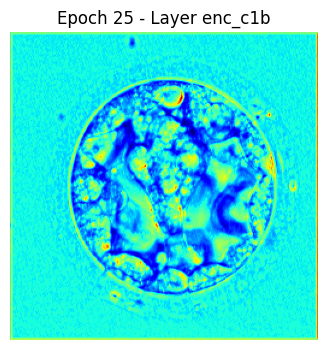

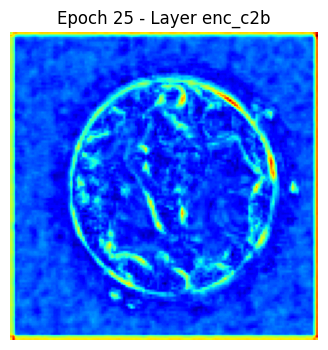

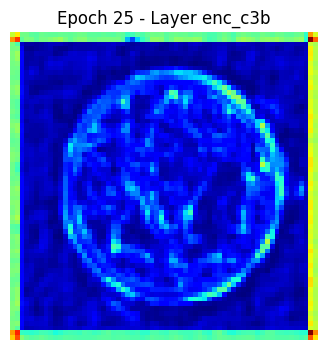

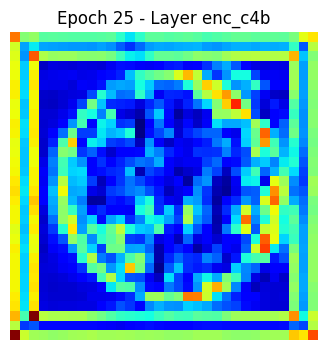

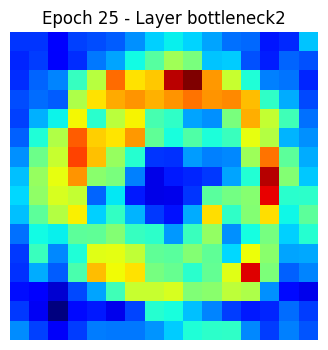

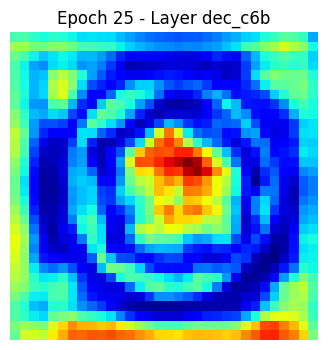

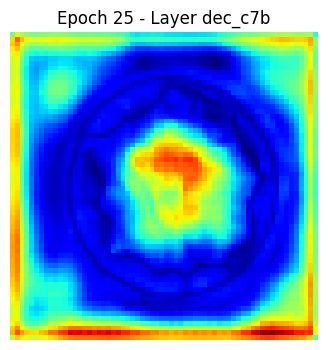

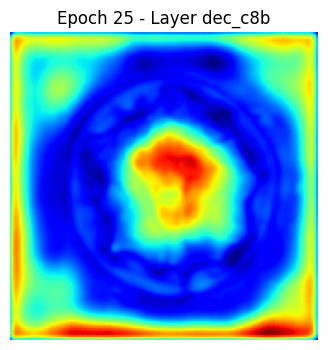

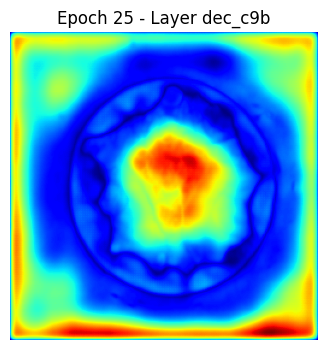

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 226ms/step - accuracy: 0.8673 - dice_coefficient: 0.8950 - iou_metric: 0.8105 - loss: 0.1662 - val_accuracy: 0.8626 - val_dice_coefficient: 0.7921 - val_iou_metric: 0.6592 - val_loss: 0.3494
Epoch 26/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 219ms/step - accuracy: 0.8671 - dice_coefficient: 0.8977 - iou_metric: 0.8149 - loss: 0.1617 - val_accuracy: 0.8647 - val_dice_coefficient: 0.8019 - val_iou_metric: 0.6731 - val_loss: 0.3393
Epoch 27/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 232ms/step - accuracy: 0.8678 - dice_coefficient: 0.9087 - iou_metric: 0.8332 - loss: 0.1456 - val_accuracy: 0.8617 - val_dice_coefficient: 0.8134 - val_iou_metric: 0.6889 - val_loss: 0.3347
Epoch 28/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 219ms/step - accuracy: 0.8685 - dice_coefficient: 0.9110 - iou_metric: 0.8369 - loss: 0.1418 - val_accuracy: 0.8606 - val_dice_coefficient: 0.8020 - val_iou_metric: 0.6729 - val_loss: 0.3504
Epoch 29/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accura

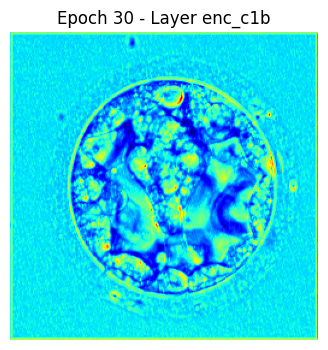

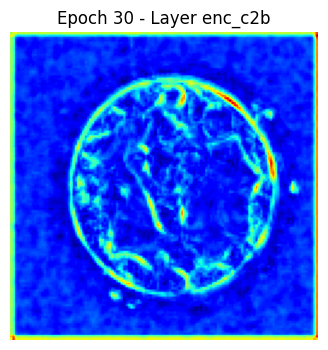

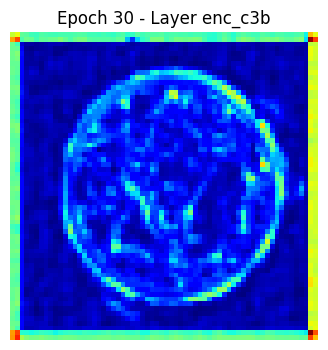

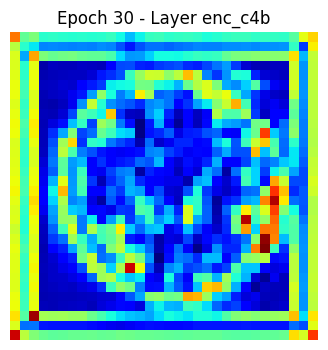

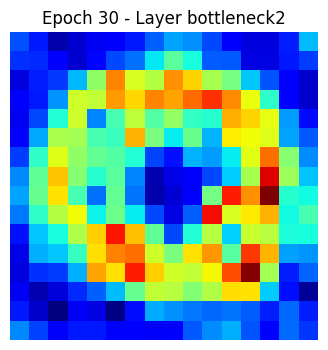

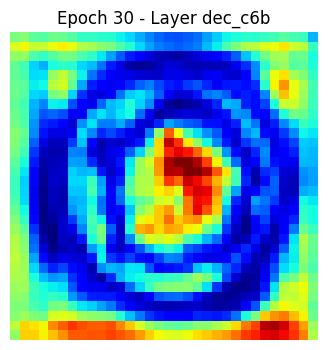

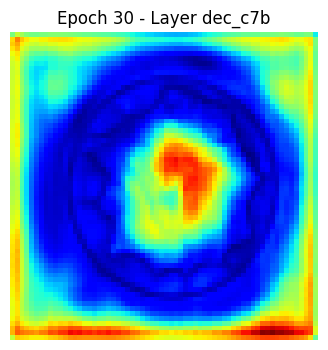

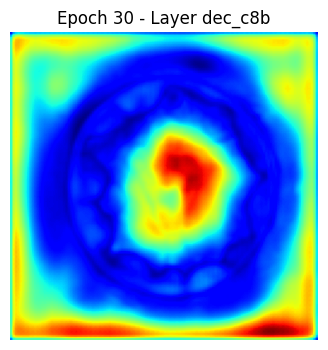

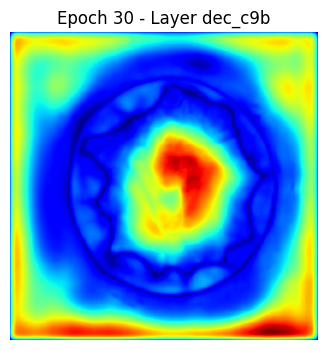

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 226ms/step - accuracy: 0.8692 - dice_coefficient: 0.9140 - iou_metric: 0.8422 - loss: 0.1372 - val_accuracy: 0.8652 - val_dice_coefficient: 0.8057 - val_iou_metric: 0.6782 - val_loss: 0.3406
Epoch 31/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 219ms/step - accuracy: 0.8696 - dice_coefficient: 0.9176 - iou_metric: 0.8480 - loss: 0.1309 - val_accuracy: 0.8659 - val_dice_coefficient: 0.8016 - val_iou_metric: 0.6727 - val_loss: 0.3505
Epoch 32/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 219ms/step - accuracy: 0.8692 - dice_coefficient: 0.9211 - iou_metric: 0.8541 - loss: 0.1259 - val_accuracy: 0.8687 - val_dice_coefficient: 0.7999 - val_iou_metric: 0.6706 - val_loss: 0.3738
Epoch 33/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 219ms/step - accuracy: 0.8699 - dice_coefficient: 0.9225 - iou_metric: 0.8565 - loss: 0.1235 - val_accuracy: 0.8646 - val_dice_coefficient: 0.7999 - val_iou_metric: 0.6699 - val_loss: 0.3605
Epoch 34/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 231ms/step - accura

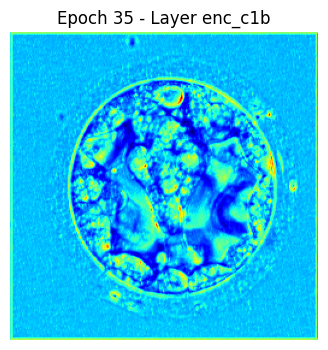

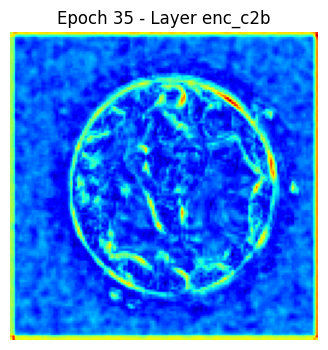

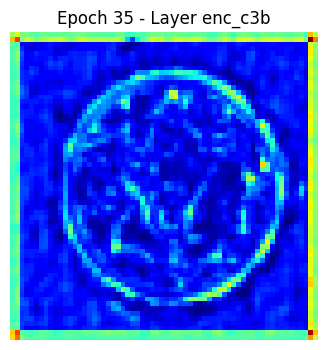

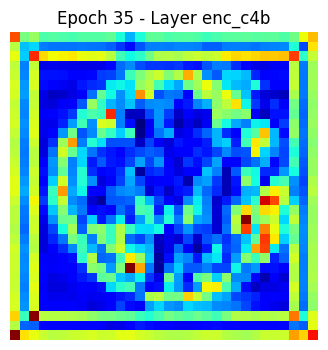

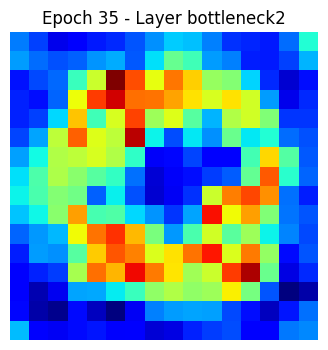

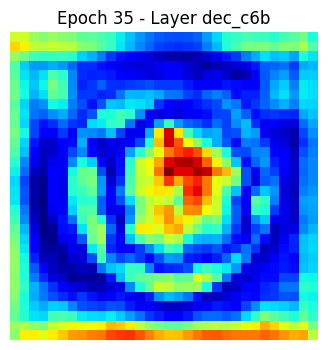

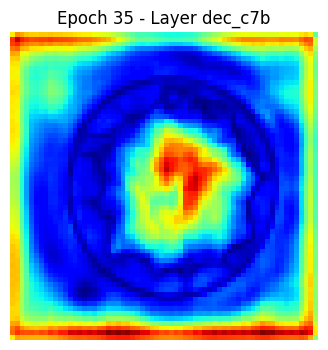

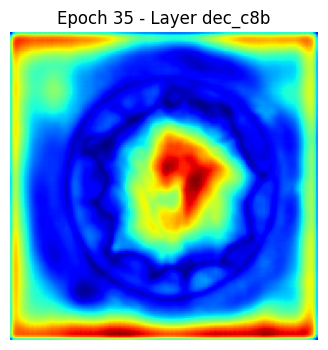

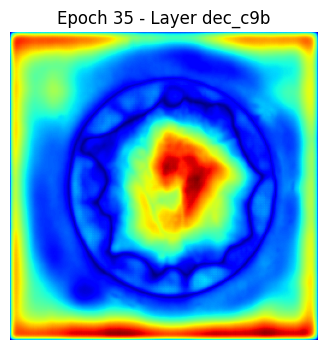

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 226ms/step - accuracy: 0.8700 - dice_coefficient: 0.9271 - iou_metric: 0.8644 - loss: 0.1156 - val_accuracy: 0.8607 - val_dice_coefficient: 0.8120 - val_iou_metric: 0.6871 - val_loss: 0.3436
Epoch 36/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 0.8701 - dice_coefficient: 0.9223 - iou_metric: 0.8561 - loss: 0.1224 - val_accuracy: 0.8655 - val_dice_coefficient: 0.8132 - val_iou_metric: 0.6894 - val_loss: 0.3837
Epoch 37/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 0.8702 - dice_coefficient: 0.9333 - iou_metric: 0.8751 - loss: 0.1055 - val_accuracy: 0.8636 - val_dice_coefficient: 0.8101 - val_iou_metric: 0.6848 - val_loss: 0.3728
Epoch 38/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 0.8706 - dice_coefficient: 0.9354 - iou_metric: 0.8789 - loss: 0.1023 - val_accuracy: 0.8629 - val_dice_coefficient: 0.8133 - val_iou_metric: 0.6892 - val_loss: 0.3739
Epoch 39/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 219ms/step - accura

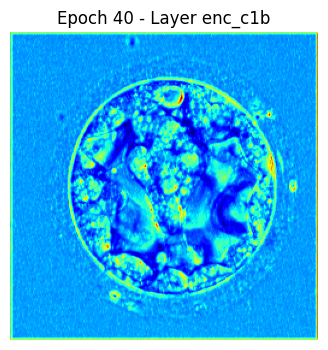

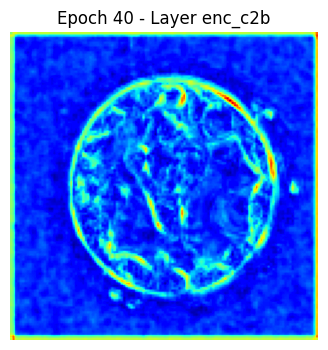

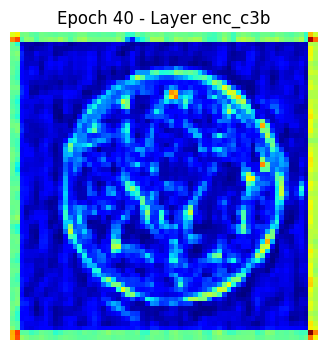

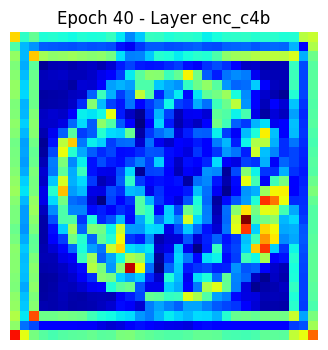

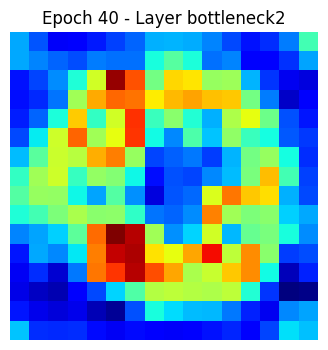

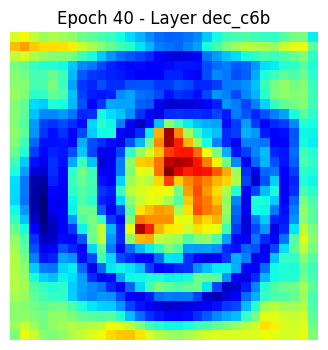

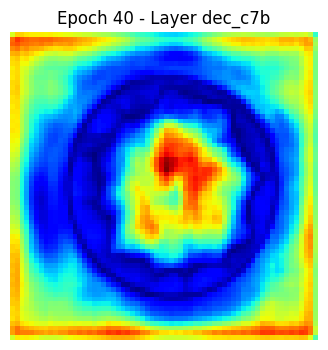

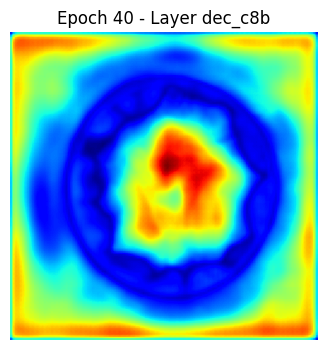

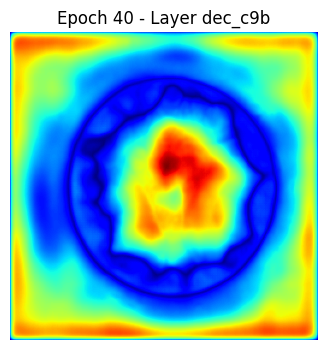

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 226ms/step - accuracy: 0.8720 - dice_coefficient: 0.9399 - iou_metric: 0.8867 - loss: 0.0947 - val_accuracy: 0.8682 - val_dice_coefficient: 0.8114 - val_iou_metric: 0.6871 - val_loss: 0.4140
Epoch 41/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 0.8712 - dice_coefficient: 0.9438 - iou_metric: 0.8937 - loss: 0.0887 - val_accuracy: 0.8678 - val_dice_coefficient: 0.8130 - val_iou_metric: 0.6892 - val_loss: 0.3991
Epoch 42/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 231ms/step - accuracy: 0.8718 - dice_coefficient: 0.9470 - iou_metric: 0.8995 - loss: 0.0833 - val_accuracy: 0.8659 - val_dice_coefficient: 0.8186 - val_iou_metric: 0.6971 - val_loss: 0.3992
Epoch 43/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 231ms/step - accuracy: 0.8720 - dice_coefficient: 0.9489 - iou_metric: 0.9029 - loss: 0.0806 - val_accuracy: 0.8642 - val_dice_coefficient: 0.8217 - val_iou_metric: 0.7013 - val_loss: 0.4010
Epoch 44/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 232ms/step - accura

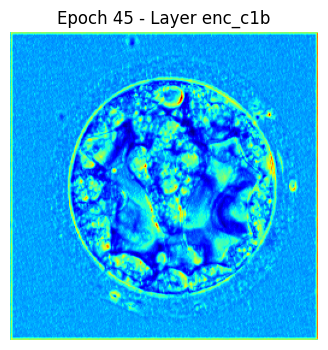

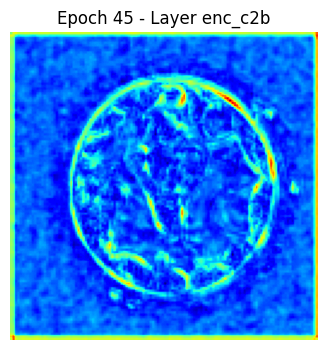

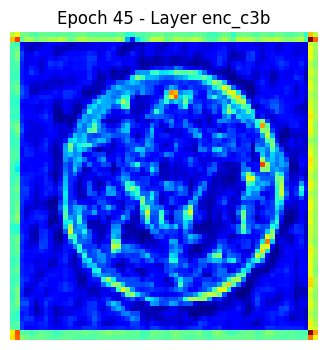

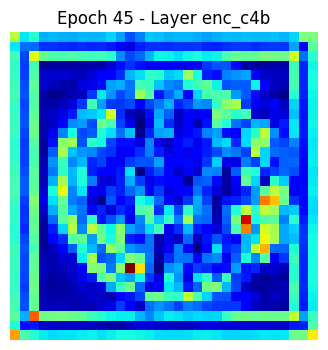

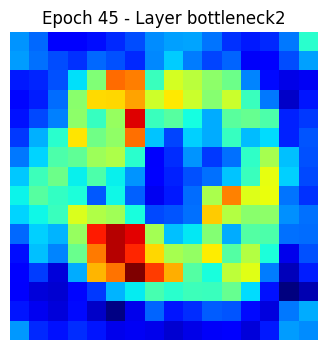

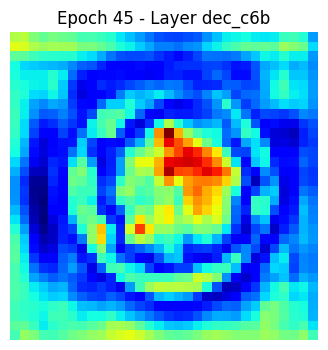

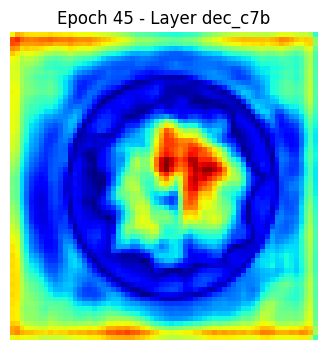

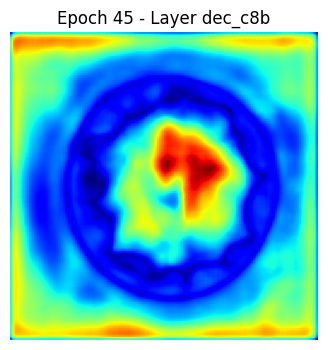

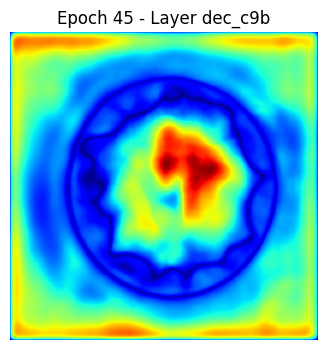

100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 239ms/step - accuracy: 0.8734 - dice_coefficient: 0.9538 - iou_metric: 0.9117 - loss: 0.0728 - val_accuracy: 0.8646 - val_dice_coefficient: 0.8249 - val_iou_metric: 0.7059 - val_loss: 0.4015
Epoch 46/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 231ms/step - accuracy: 0.8726 - dice_coefficient: 0.9549 - iou_metric: 0.9137 - loss: 0.0709 - val_accuracy: 0.8657 - val_dice_coefficient: 0.8255 - val_iou_metric: 0.7070 - val_loss: 0.4014
Epoch 47/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 219ms/step - accuracy: 0.8739 - dice_coefficient: 0.9572 - iou_metric: 0.9180 - loss: 0.0670 - val_accuracy: 0.8670 - val_dice_coefficient: 0.8237 - val_iou_metric: 0.7044 - val_loss: 0.4131
Epoch 48/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 0.8731 - dice_coefficient: 0.9593 - iou_metric: 0.9218 - loss: 0.0640 - val_accuracy: 0.8655 - val_dice_coefficient: 0.8243 - val_iou_metric: 0.7054 - val_loss: 0.4223
Epoch 49/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 219ms/step - accura

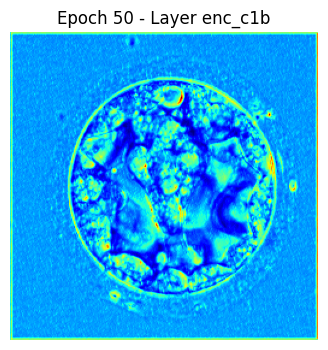

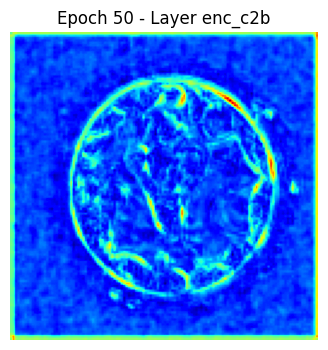

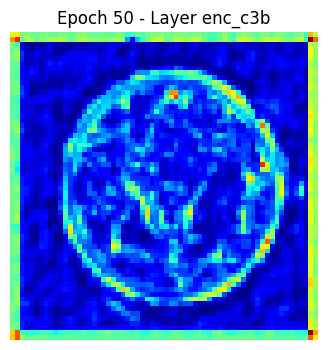

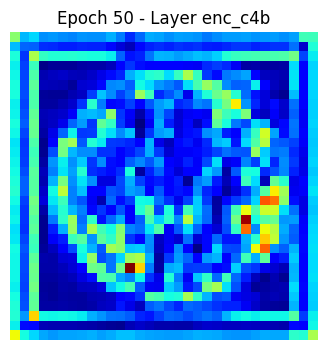

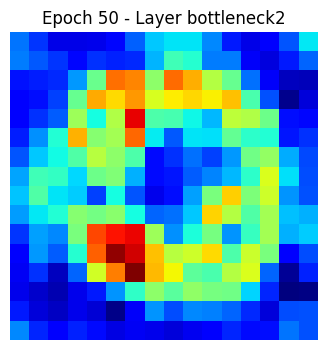

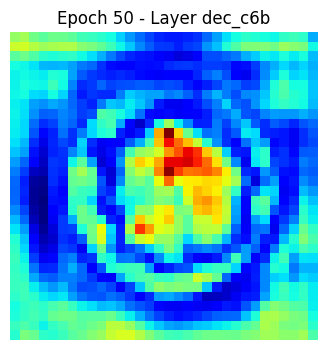

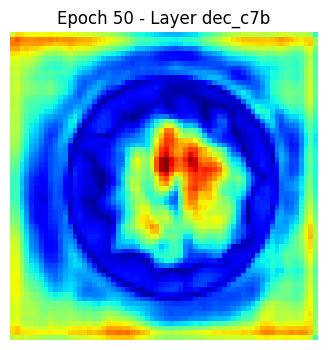

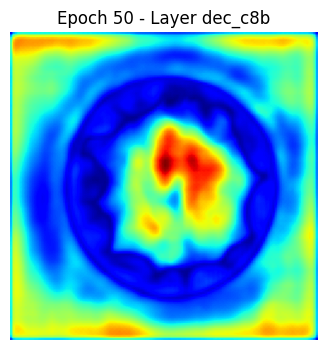

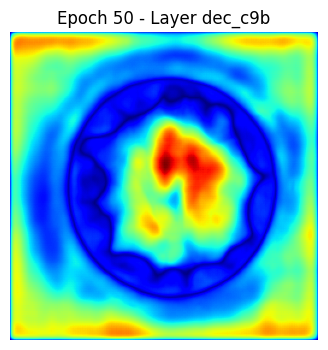

100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 239ms/step - accuracy: 0.8731 - dice_coefficient: 0.9613 - iou_metric: 0.9256 - loss: 0.0608 - val_accuracy: 0.8662 - val_dice_coefficient: 0.8269 - val_iou_metric: 0.7090 - val_loss: 0.4336
Epoch 51/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 231ms/step - accuracy: 0.8735 - dice_coefficient: 0.9634 - iou_metric: 0.9293 - loss: 0.0576 - val_accuracy: 0.8648 - val_dice_coefficient: 0.8276 - val_iou_metric: 0.7103 - val_loss: 0.4313
Epoch 52/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 219ms/step - accuracy: 0.8742 - dice_coefficient: 0.9649 - iou_metric: 0.9323 - loss: 0.0547 - val_accuracy: 0.8672 - val_dice_coefficient: 0.8256 - val_iou_metric: 0.7073 - val_loss: 0.4510
Epoch 53/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 0.8740 - dice_coefficient: 0.9649 - iou_metric: 0.9322 - loss: 0.0551 - val_accuracy: 0.8663 - val_dice_coefficient: 0.8266 - val_iou_metric: 0.7087 - val_loss: 0.4518
Epoch 54/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 232ms/step - accura

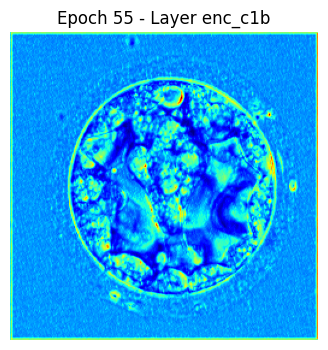

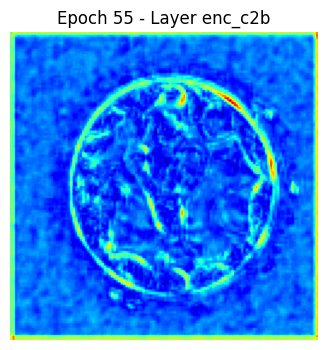

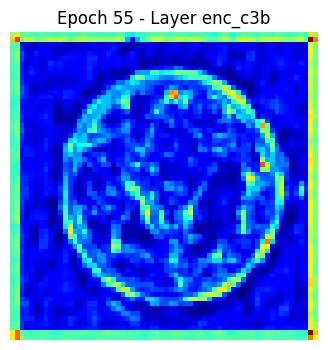

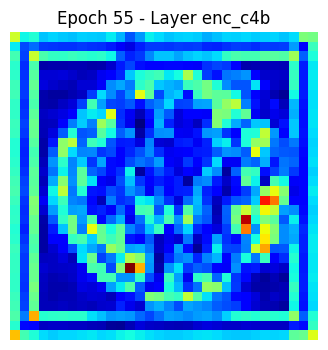

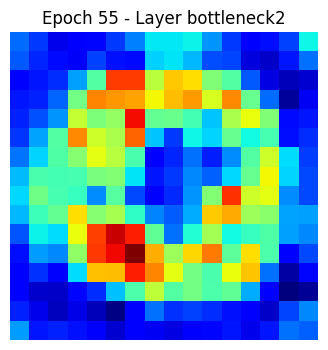

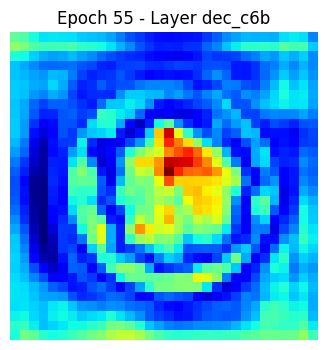

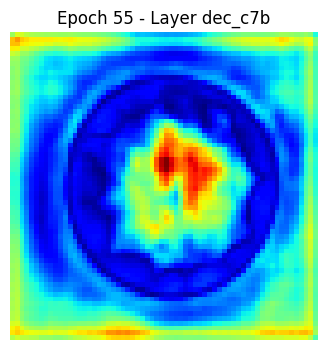

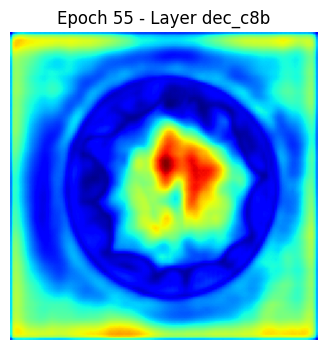

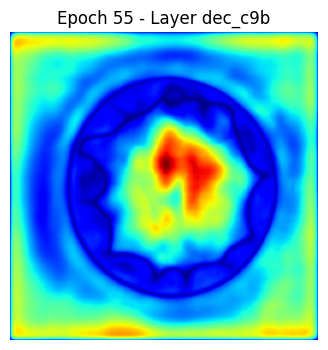

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 226ms/step - accuracy: 0.8743 - dice_coefficient: 0.9648 - iou_metric: 0.9319 - loss: 0.0551 - val_accuracy: 0.8668 - val_dice_coefficient: 0.8252 - val_iou_metric: 0.7067 - val_loss: 0.4342
Epoch 56/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 230ms/step - accuracy: 0.8745 - dice_coefficient: 0.9657 - iou_metric: 0.9337 - loss: 0.0537 - val_accuracy: 0.8659 - val_dice_coefficient: 0.8282 - val_iou_metric: 0.7111 - val_loss: 0.4381
Epoch 57/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 231ms/step - accuracy: 0.8742 - dice_coefficient: 0.9673 - iou_metric: 0.9367 - loss: 0.0511 - val_accuracy: 0.8661 - val_dice_coefficient: 0.8295 - val_iou_metric: 0.7130 - val_loss: 0.4370
Epoch 58/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 0.8739 - dice_coefficient: 0.9686 - iou_metric: 0.9391 - loss: 0.0492 - val_accuracy: 0.8660 - val_dice_coefficient: 0.8291 - val_iou_metric: 0.7124 - val_loss: 0.4415
Epoch 59/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 219ms/step - accura

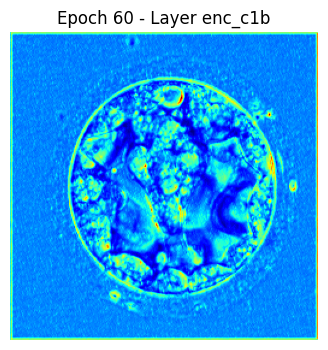

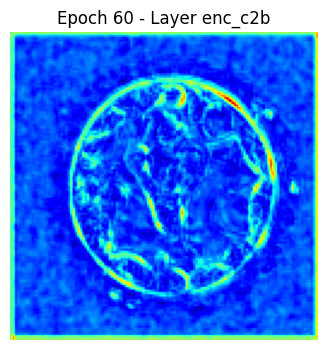

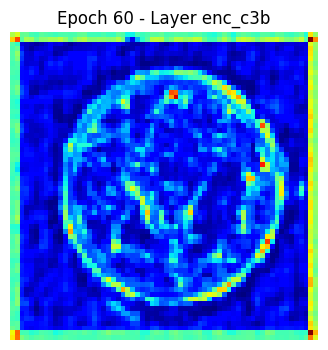

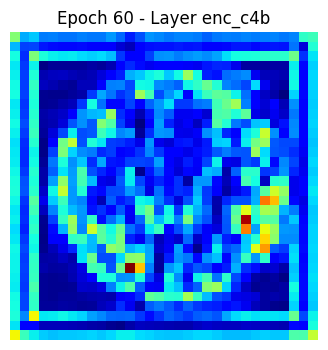

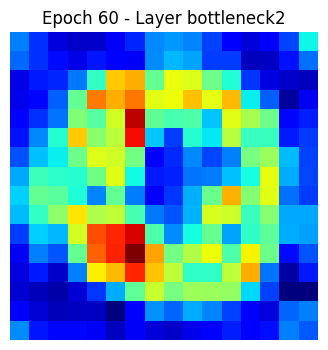

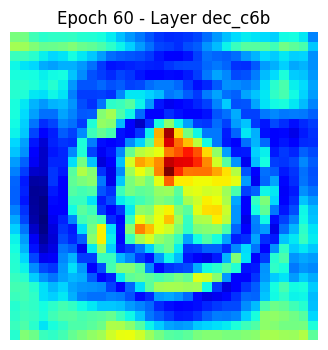

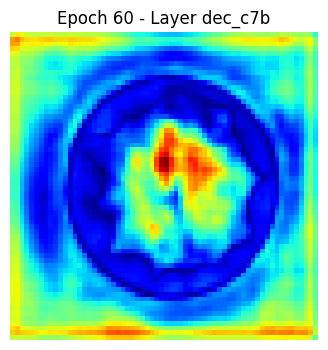

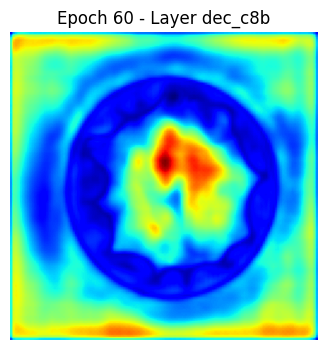

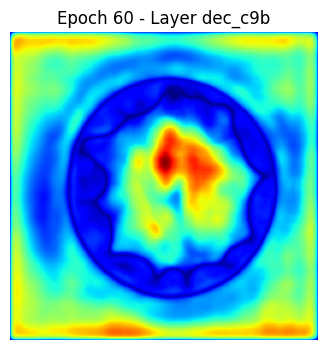

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 226ms/step - accuracy: 0.8742 - dice_coefficient: 0.9699 - iou_metric: 0.9415 - loss: 0.0471 - val_accuracy: 0.8667 - val_dice_coefficient: 0.8281 - val_iou_metric: 0.7111 - val_loss: 0.4619
Epoch 61/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 0.8736 - dice_coefficient: 0.9701 - iou_metric: 0.9420 - loss: 0.0468 - val_accuracy: 0.8674 - val_dice_coefficient: 0.8274 - val_iou_metric: 0.7099 - val_loss: 0.4643
Epoch 62/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 0.8745 - dice_coefficient: 0.9701 - iou_metric: 0.9419 - loss: 0.0469 - val_accuracy: 0.8674 - val_dice_coefficient: 0.8282 - val_iou_metric: 0.7113 - val_loss: 0.4797
Epoch 63/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 231ms/step - accuracy: 0.8747 - dice_coefficient: 0.9708 - iou_metric: 0.9434 - loss: 0.0456 - val_accuracy: 0.8654 - val_dice_coefficient: 0.8301 - val_iou_metric: 0.7138 - val_loss: 0.4601
Epoch 64/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accura

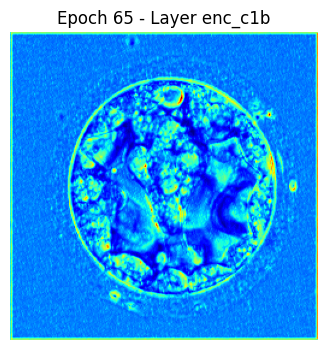

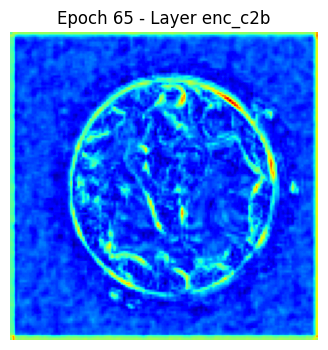

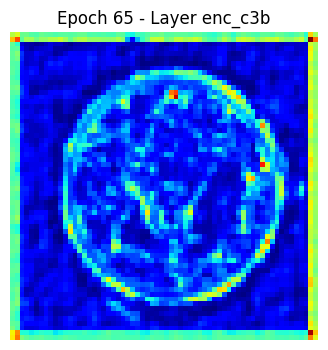

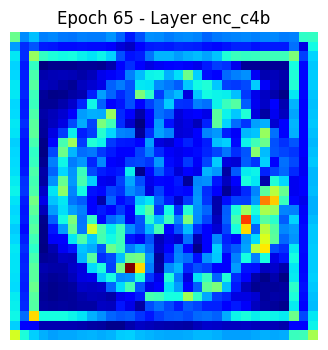

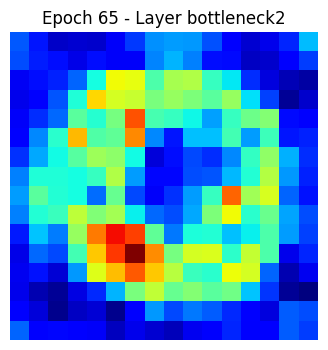

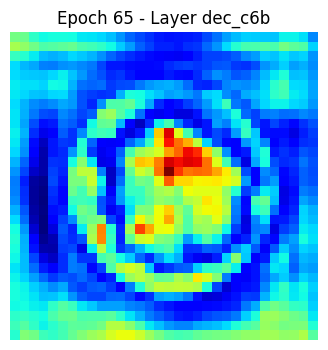

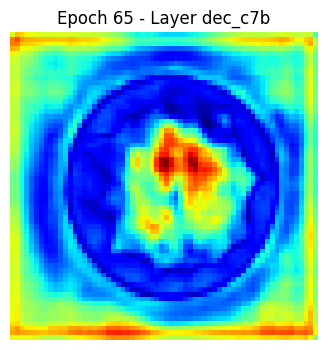

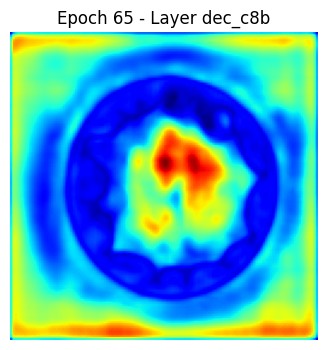

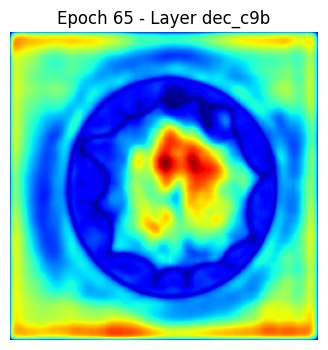

100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 243ms/step - accuracy: 0.8749 - dice_coefficient: 0.9713 - iou_metric: 0.9441 - loss: 0.0449 - val_accuracy: 0.8655 - val_dice_coefficient: 0.8302 - val_iou_metric: 0.7139 - val_loss: 0.4614
Epoch 66/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 219ms/step - accuracy: 0.8741 - dice_coefficient: 0.9713 - iou_metric: 0.9442 - loss: 0.0450 - val_accuracy: 0.8667 - val_dice_coefficient: 0.8291 - val_iou_metric: 0.7124 - val_loss: 0.4622
Epoch 67/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 231ms/step - accuracy: 0.8744 - dice_coefficient: 0.9723 - iou_metric: 0.9460 - loss: 0.0434 - val_accuracy: 0.8660 - val_dice_coefficient: 0.8308 - val_iou_metric: 0.7150 - val_loss: 0.4667
Epoch 68/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 231ms/step - accuracy: 0.8738 - dice_coefficient: 0.9727 - iou_metric: 0.9469 - loss: 0.0427 - val_accuracy: 0.8665 - val_dice_coefficient: 0.8309 - val_iou_metric: 0.7152 - val_loss: 0.4837
Epoch 69/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 219ms/step - accura

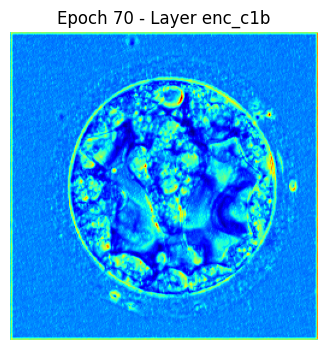

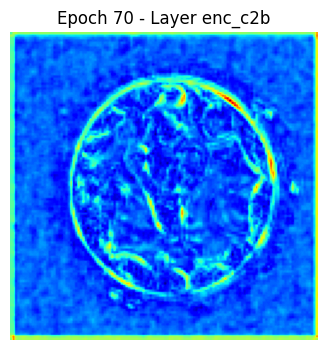

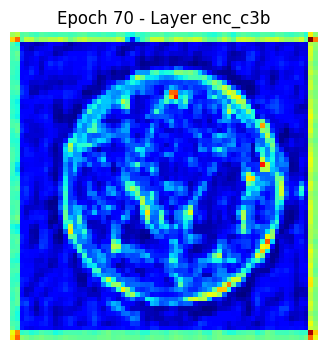

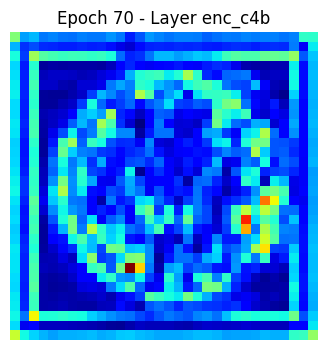

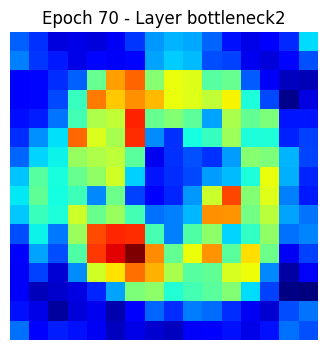

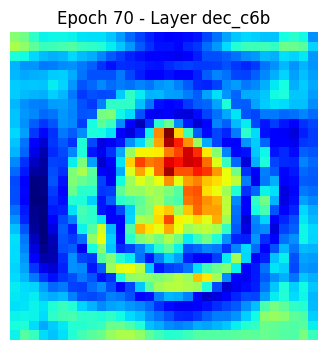

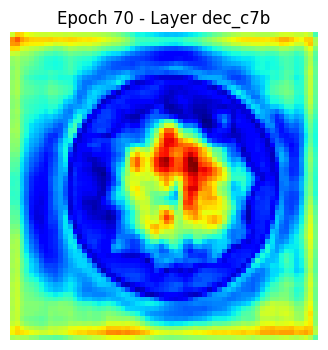

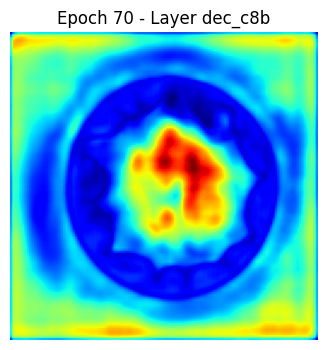

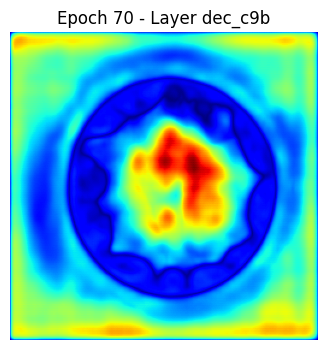

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 226ms/step - accuracy: 0.8743 - dice_coefficient: 0.9724 - iou_metric: 0.9463 - loss: 0.0434 - val_accuracy: 0.8665 - val_dice_coefficient: 0.8299 - val_iou_metric: 0.7136 - val_loss: 0.4807
Epoch 71/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 219ms/step - accuracy: 0.8741 - dice_coefficient: 0.9730 - iou_metric: 0.9474 - loss: 0.0424 - val_accuracy: 0.8666 - val_dice_coefficient: 0.8302 - val_iou_metric: 0.7142 - val_loss: 0.4696
Epoch 72/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 0.8746 - dice_coefficient: 0.9734 - iou_metric: 0.9482 - loss: 0.0415 - val_accuracy: 0.8674 - val_dice_coefficient: 0.8280 - val_iou_metric: 0.7109 - val_loss: 0.4879
Epoch 73/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 0.8747 - dice_coefficient: 0.9740 - iou_metric: 0.9493 - loss: 0.0406 - val_accuracy: 0.8669 - val_dice_coefficient: 0.8292 - val_iou_metric: 0.7126 - val_loss: 0.4819
Epoch 74/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accura

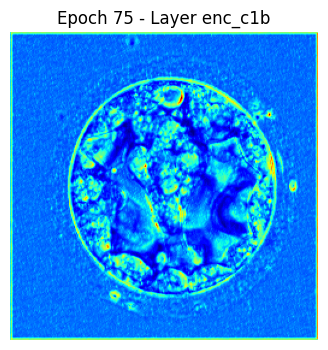

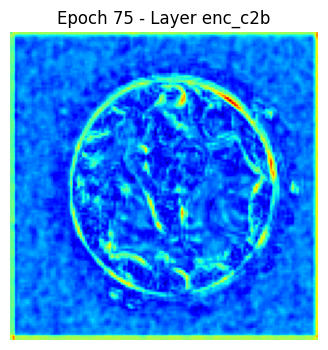

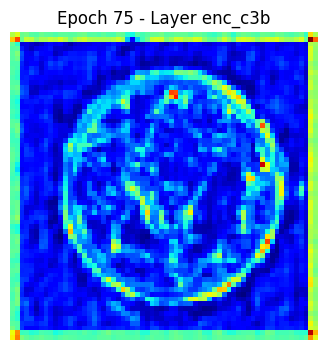

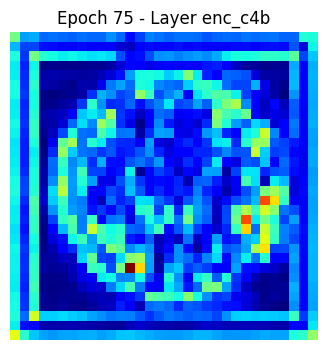

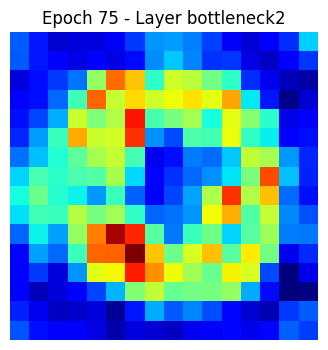

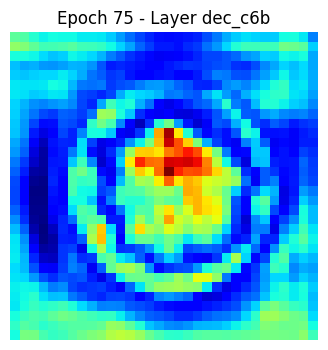

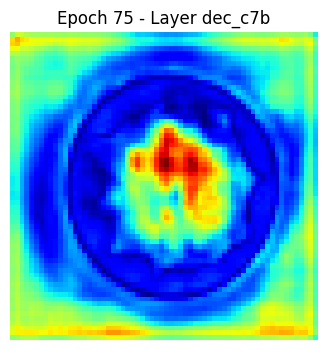

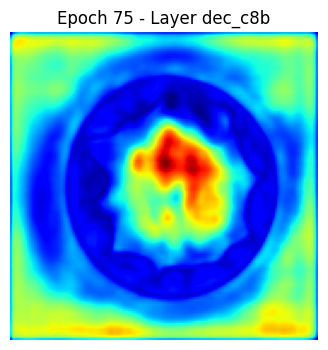

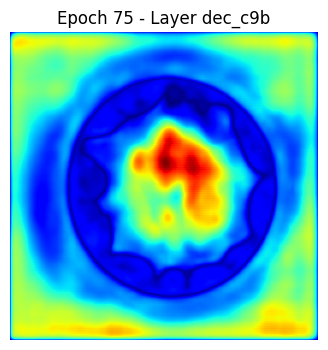

100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 239ms/step - accuracy: 0.8749 - dice_coefficient: 0.9743 - iou_metric: 0.9498 - loss: 0.0401 - val_accuracy: 0.8665 - val_dice_coefficient: 0.8327 - val_iou_metric: 0.7176 - val_loss: 0.4774
Epoch 76/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 0.8753 - dice_coefficient: 0.9744 - iou_metric: 0.9501 - loss: 0.0399 - val_accuracy: 0.8662 - val_dice_coefficient: 0.8316 - val_iou_metric: 0.7162 - val_loss: 0.4811
Epoch 77/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 0.8743 - dice_coefficient: 0.9740 - iou_metric: 0.9494 - loss: 0.0407 - val_accuracy: 0.8660 - val_dice_coefficient: 0.8316 - val_iou_metric: 0.7162 - val_loss: 0.4906
Epoch 78/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 219ms/step - accuracy: 0.8753 - dice_coefficient: 0.9741 - iou_metric: 0.9496 - loss: 0.0403 - val_accuracy: 0.8660 - val_dice_coefficient: 0.8314 - val_iou_metric: 0.7160 - val_loss: 0.4898
Epoch 79/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accura

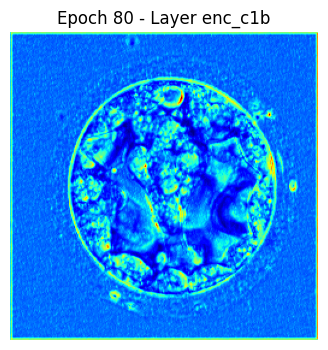

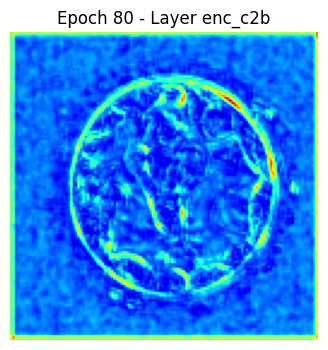

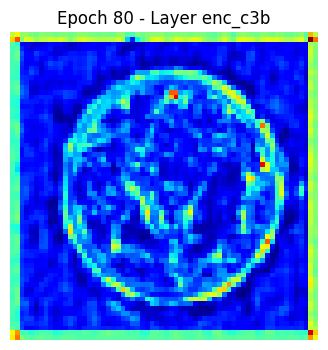

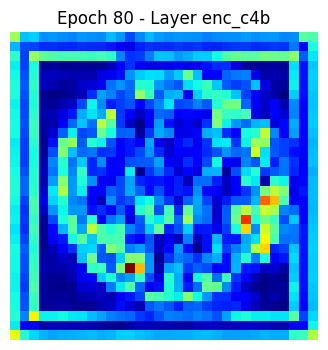

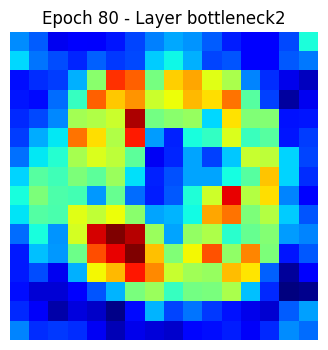

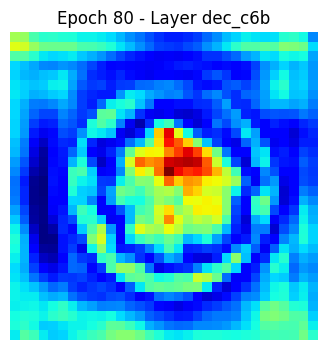

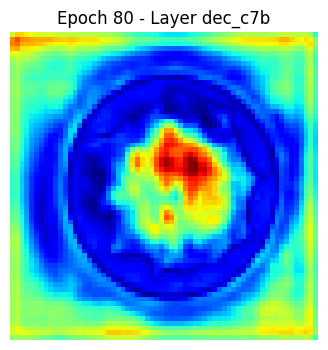

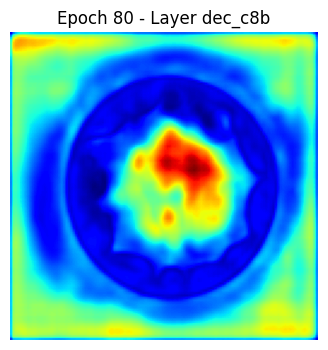

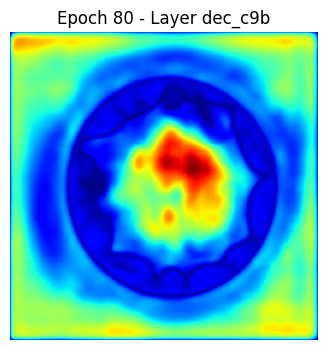

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 226ms/step - accuracy: 0.8747 - dice_coefficient: 0.9754 - iou_metric: 0.9519 - loss: 0.0386 - val_accuracy: 0.8672 - val_dice_coefficient: 0.8283 - val_iou_metric: 0.7116 - val_loss: 0.5103
Epoch 81/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 0.8744 - dice_coefficient: 0.9755 - iou_metric: 0.9521 - loss: 0.0383 - val_accuracy: 0.8662 - val_dice_coefficient: 0.8311 - val_iou_metric: 0.7154 - val_loss: 0.4919
Epoch 82/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 0.8745 - dice_coefficient: 0.9750 - iou_metric: 0.9512 - loss: 0.0392 - val_accuracy: 0.8663 - val_dice_coefficient: 0.8311 - val_iou_metric: 0.7155 - val_loss: 0.4919
Epoch 83/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 219ms/step - accuracy: 0.8743 - dice_coefficient: 0.9752 - iou_metric: 0.9516 - loss: 0.0389 - val_accuracy: 0.8665 - val_dice_coefficient: 0.8314 - val_iou_metric: 0.7159 - val_loss: 0.5025
Epoch 84/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accura

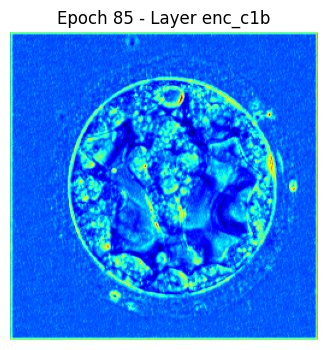

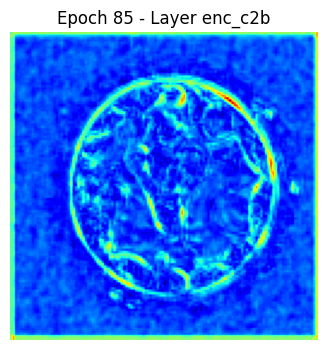

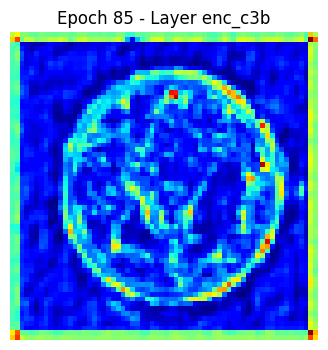

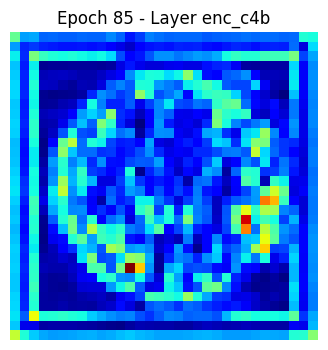

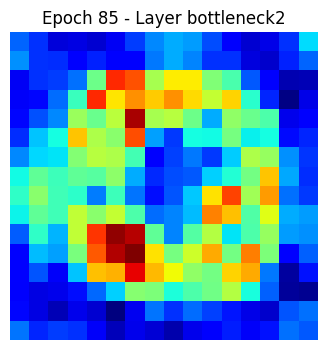

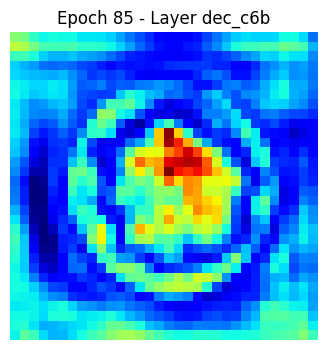

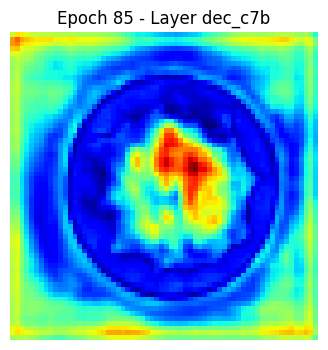

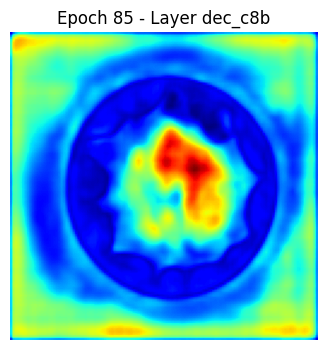

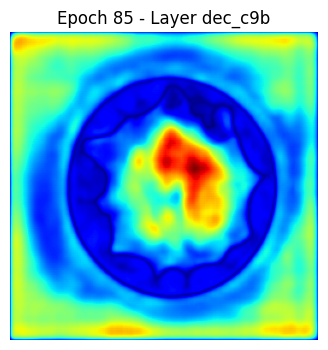

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 226ms/step - accuracy: 0.8753 - dice_coefficient: 0.9758 - iou_metric: 0.9528 - loss: 0.0377 - val_accuracy: 0.8664 - val_dice_coefficient: 0.8320 - val_iou_metric: 0.7166 - val_loss: 0.5052


Model: "UNet_with_CAB"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c1a (Conv2D)    │ (None, 256, 256,  │        640 │ input_layer[0][0] │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c1b (Conv2D)    │ (None, 256, 256,  │     36,928 │ enc_c1a[0][0]     │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1               │ (None, 128, 128,  │          0 │ enc_c1b[0][0]     │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c2a (Conv2D)    │ (None, 128, 128,  │     73,856 │ pool1[0][0]       │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c2b (Conv2D)    │ (None, 128, 128,  │    147,584 │ enc_c2a[0][0]     │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool2               │ (None, 64, 64,    │          0 │ enc_c2b[0][0]     │
│ (MaxPooling2D)      │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c3a (Conv2D)    │ (None, 64, 64,    │    295,168 │ pool2[0][0]       │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c3b (Conv2D)    │ (None, 64, 64,    │    590,080 │ enc_c3a[0][0]     │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool3               │ (None, 32, 32,    │          0 │ enc_c3b[0][0]     │
│ (MaxPooling2D)      │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c4a (Conv2D)    │ (None, 32, 32,    │  1,180,160 │ pool3[0][0]       │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c4b (Conv2D)    │ (None, 32, 32,    │  2,359,808 │ enc_c4a[0][0]     │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool4               │ (None, 16, 16,    │          0 │ enc_c4b[0][0]     │
│ (MaxPooling2D)      │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bottleneck1         │ (None, 16, 16,    │  4,719,616 │ pool4[0][0]       │
│ (Conv2D)            │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bottleneck2         │ (None, 16, 16,    │  9,438,208 │ bottleneck1[0][0] │
│ (Conv2D)            │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ CAB                 │ [(None, 256, 256, │      9,920 │ enc_c1b[0][0],    │
│ (ChannelAttentionB… │ 64), (None, 128,  │            │ enc_c2b[0][0],    │
│                     │ 128, 128), (None, │            │ enc_c3b[0][0],    │
│                     │ 64, 64, 256),     │            │ enc_c4b[0][0],  

 Total params: 93,121,541 (355.23 MB)

 Trainable params: 31,040,513 (118.41 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 62,081,028 (236.82 MB)

GFLOPs calculation not available, use tensorflow profiler for exact computation.
Training time for fold 1: 1987.35s

--- Fold 2 ---
Epoch 1/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 45s 289ms/step - accuracy: 0.8748 - dice_coefficient: 0.1851 - iou_metric: 0.1031 - loss: 1.2733 - val_accuracy: 0.8268 - val_dice_coefficient: 0.5594 - val_iou_metric: 0.3893 - val_loss: 0.6382
Epoch 2/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 220ms/step - accuracy: 0.8163 - dice_coefficient: 0.5728 - iou_metric: 0.4038 - loss: 0.6603 - val_accuracy: 0.8392 - val_dice_coefficient: 0.6105 - val_iou_metric: 0.4405 - val_loss: 0.5575
Epoch 3/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 221ms/step - accuracy: 0.8305 - dice_coefficient: 0.6509 - iou_metric: 0.4831 - loss: 0.5442 - val_accuracy: 0.8426 - val_dice_coefficient: 0.6833 - val_iou_metric: 0.5208 - val_loss: 0.4857
Epoch 4/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 220ms/step - accuracy: 0.8407 - dice_coefficient: 0.7086 - iou_metric: 0.5498 - loss: 0.4643 - val_accuracy: 0.8576

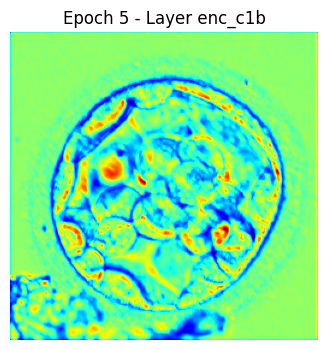

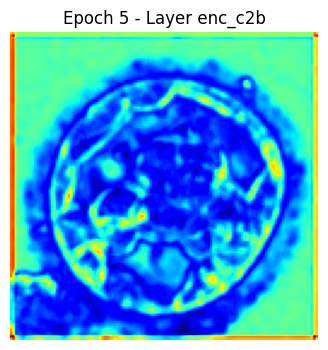

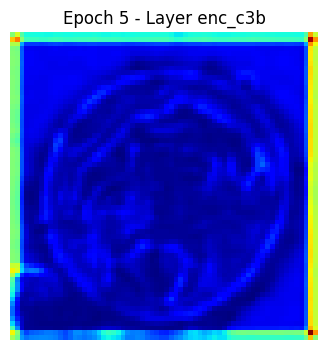

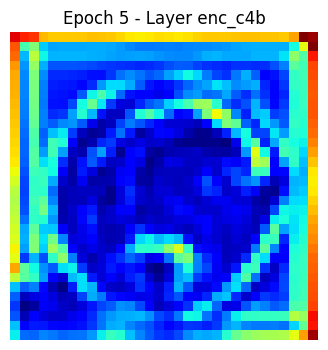

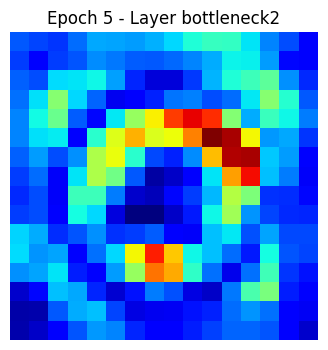

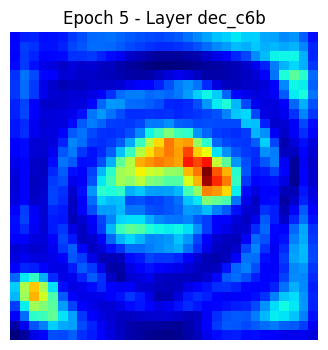

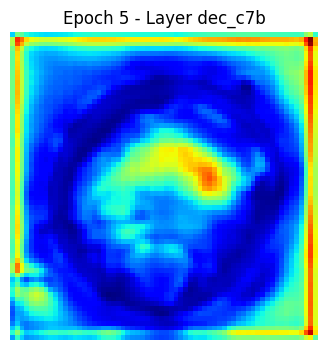

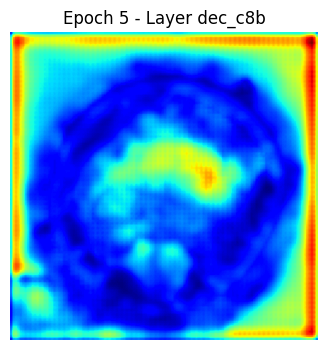

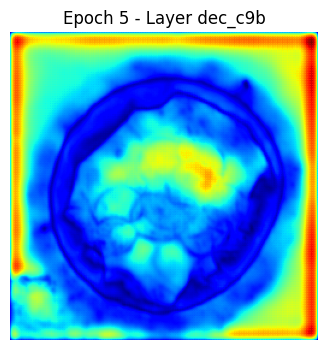

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 226ms/step - accuracy: 0.8473 - dice_coefficient: 0.7416 - iou_metric: 0.5904 - loss: 0.4077 - val_accuracy: 0.8603 - val_dice_coefficient: 0.6898 - val_iou_metric: 0.5290 - val_loss: 0.4427
Epoch 6/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 220ms/step - accuracy: 0.8483 - dice_coefficient: 0.7466 - iou_metric: 0.5968 - loss: 0.4012 - val_accuracy: 0.8594 - val_dice_coefficient: 0.7228 - val_iou_metric: 0.5689 - val_loss: 0.4002
Epoch 7/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 219ms/step - accuracy: 0.8508 - dice_coefficient: 0.7657 - iou_metric: 0.6215 - loss: 0.3708 - val_accuracy: 0.8594 - val_dice_coefficient: 0.7688 - val_iou_metric: 0.6281 - val_loss: 0.3635
Epoch 8/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 0.8522 - dice_coefficient: 0.7793 - iou_metric: 0.6392 - loss: 0.3535 - val_accuracy: 0.8603 - val_dice_coefficient: 0.7635 - val_iou_metric: 0.6209 - val_loss: 0.3562
Epoch 9/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 220ms/step - accuracy: 

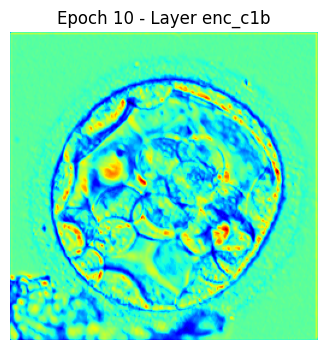

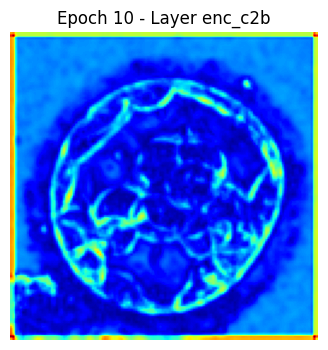

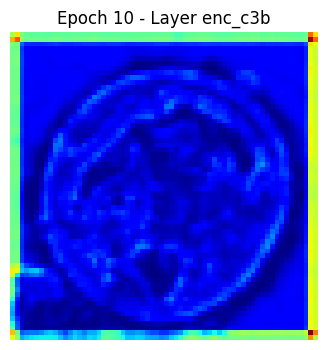

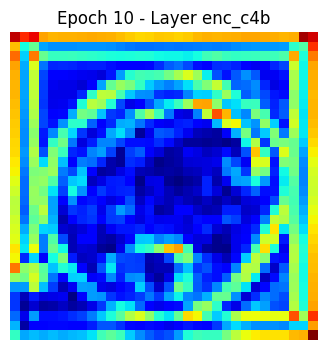

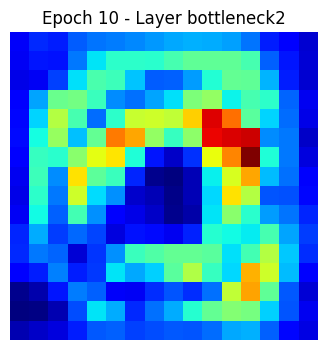

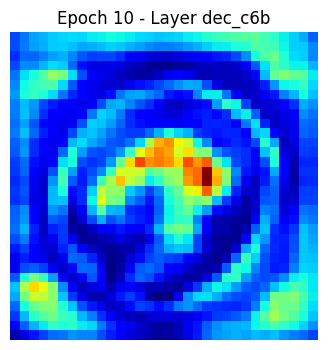

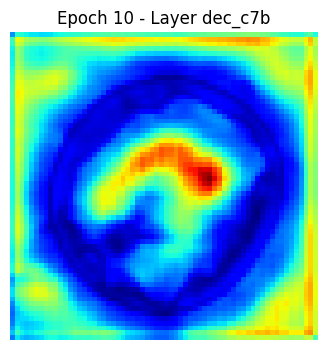

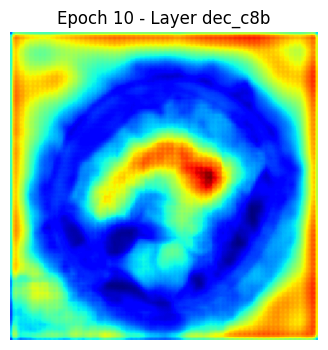

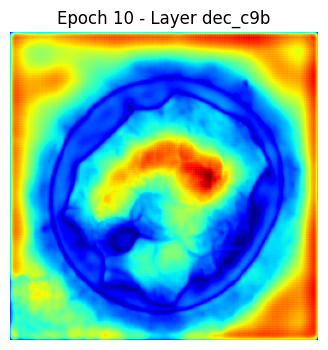

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8537 - dice_coefficient: 0.7954 - iou_metric: 0.6614 - loss: 0.3243 - val_accuracy: 0.8605 - val_dice_coefficient: 0.7843 - val_iou_metric: 0.6491 - val_loss: 0.3353
Epoch 11/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 219ms/step - accuracy: 0.8548 - dice_coefficient: 0.8052 - iou_metric: 0.6749 - loss: 0.3088 - val_accuracy: 0.8641 - val_dice_coefficient: 0.7831 - val_iou_metric: 0.6476 - val_loss: 0.3375
Epoch 12/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 220ms/step - accuracy: 0.8569 - dice_coefficient: 0.8106 - iou_metric: 0.6824 - loss: 0.3003 - val_accuracy: 0.8604 - val_dice_coefficient: 0.7889 - val_iou_metric: 0.6553 - val_loss: 0.3219
Epoch 13/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 219ms/step - accuracy: 0.8577 - dice_coefficient: 0.8207 - iou_metric: 0.6966 - loss: 0.2850 - val_accuracy: 0.8649 - val_dice_coefficient: 0.7819 - val_iou_metric: 0.6460 - val_loss: 0.3290
Epoch 14/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 220ms/step - accura

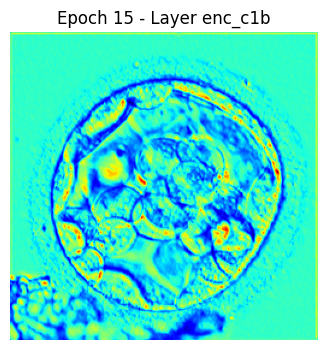

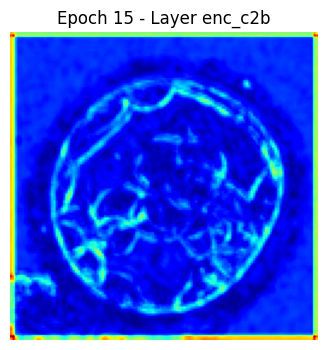

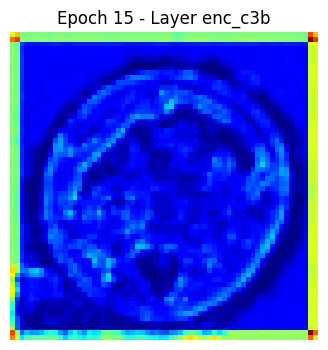

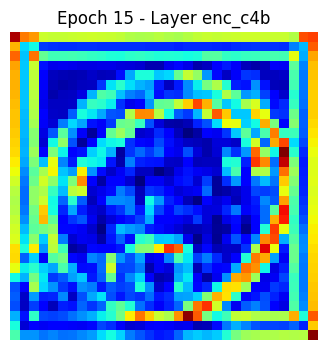

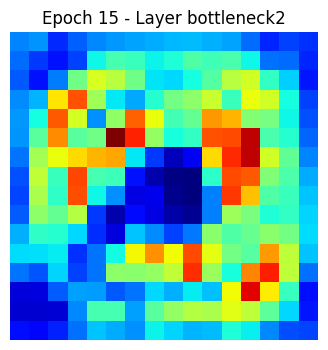

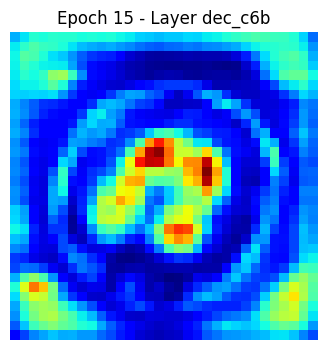

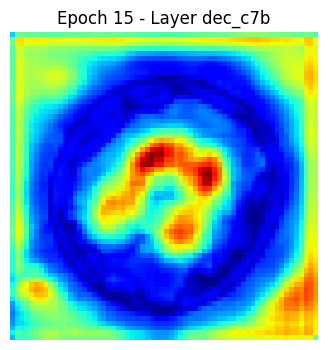

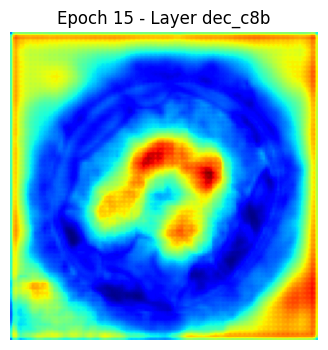

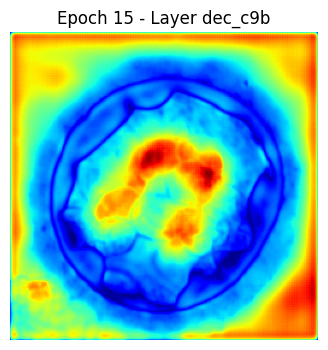

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 226ms/step - accuracy: 0.8600 - dice_coefficient: 0.8400 - iou_metric: 0.7249 - loss: 0.2553 - val_accuracy: 0.8651 - val_dice_coefficient: 0.7954 - val_iou_metric: 0.6647 - val_loss: 0.3165
Epoch 16/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 0.8605 - dice_coefficient: 0.8445 - iou_metric: 0.7316 - loss: 0.2486 - val_accuracy: 0.8632 - val_dice_coefficient: 0.8006 - val_iou_metric: 0.6720 - val_loss: 0.3141
Epoch 17/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 219ms/step - accuracy: 0.8621 - dice_coefficient: 0.8525 - iou_metric: 0.7440 - loss: 0.2372 - val_accuracy: 0.8656 - val_dice_coefficient: 0.8104 - val_iou_metric: 0.6864 - val_loss: 0.3289
Epoch 18/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 0.8638 - dice_coefficient: 0.8575 - iou_metric: 0.7514 - loss: 0.2279 - val_accuracy: 0.8628 - val_dice_coefficient: 0.7869 - val_iou_metric: 0.6530 - val_loss: 0.3216
Epoch 19/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accura

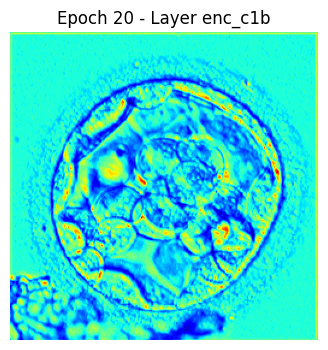

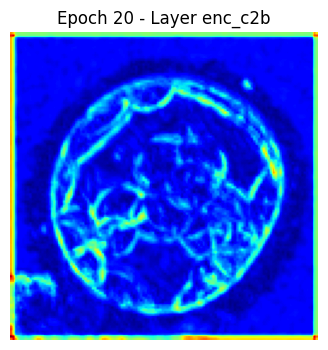

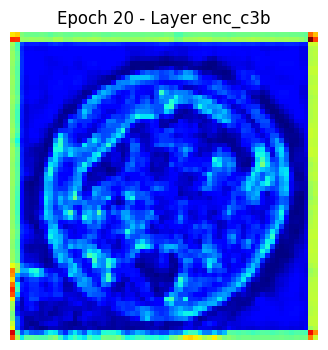

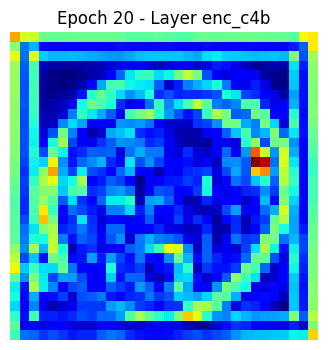

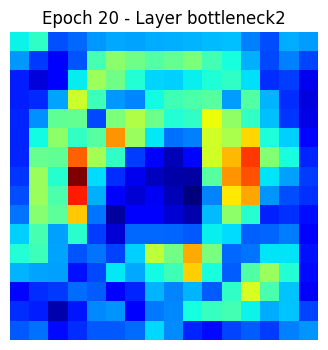

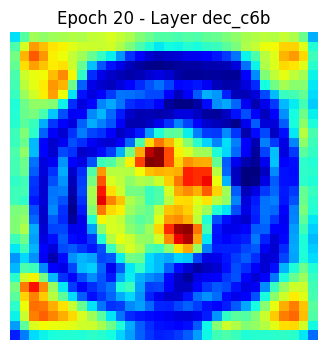

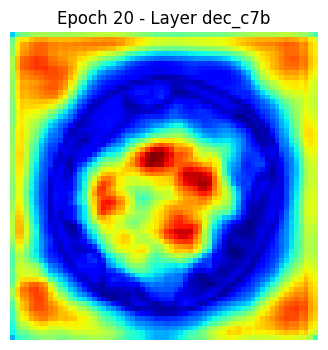

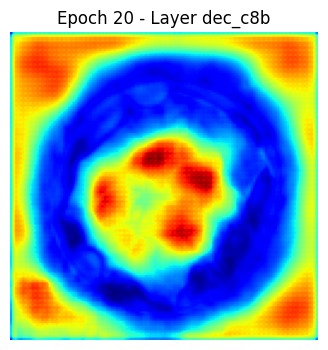

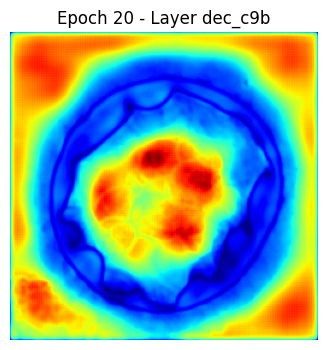

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 226ms/step - accuracy: 0.8651 - dice_coefficient: 0.8725 - iou_metric: 0.7747 - loss: 0.2050 - val_accuracy: 0.8669 - val_dice_coefficient: 0.8025 - val_iou_metric: 0.6747 - val_loss: 0.3254
Epoch 21/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 219ms/step - accuracy: 0.8653 - dice_coefficient: 0.8783 - iou_metric: 0.7837 - loss: 0.1957 - val_accuracy: 0.8661 - val_dice_coefficient: 0.8242 - val_iou_metric: 0.7061 - val_loss: 0.3130
Epoch 22/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 0.8658 - dice_coefficient: 0.8831 - iou_metric: 0.7912 - loss: 0.1886 - val_accuracy: 0.8639 - val_dice_coefficient: 0.8089 - val_iou_metric: 0.6840 - val_loss: 0.3337
Epoch 23/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 0.8667 - dice_coefficient: 0.8927 - iou_metric: 0.8067 - loss: 0.1723 - val_accuracy: 0.8634 - val_dice_coefficient: 0.8014 - val_iou_metric: 0.6730 - val_loss: 0.3310
Epoch 24/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accura

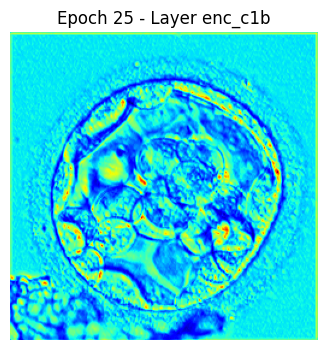

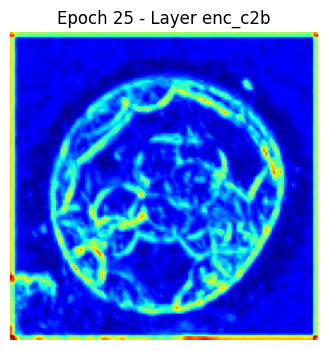

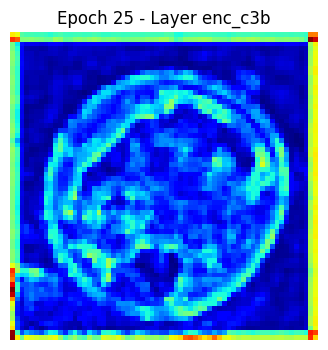

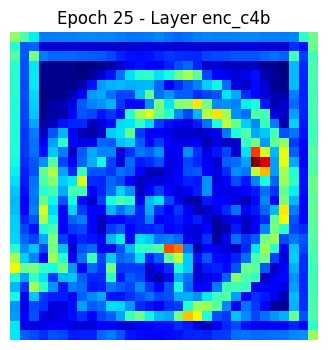

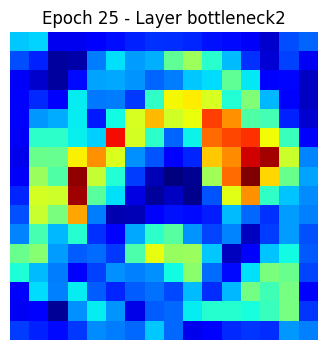

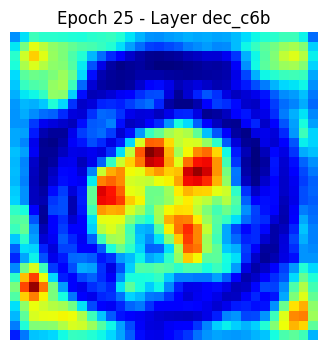

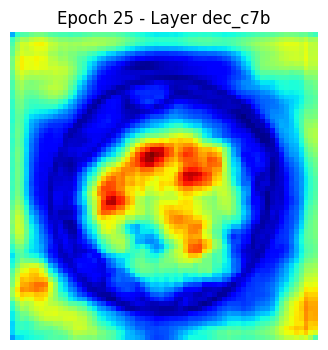

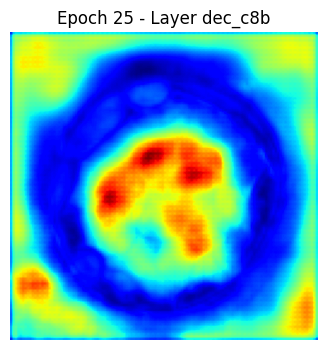

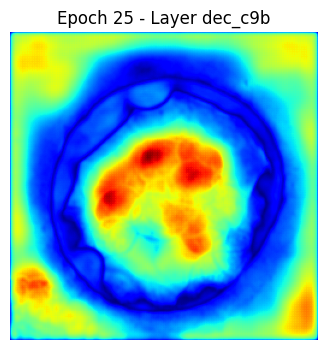

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 226ms/step - accuracy: 0.8691 - dice_coefficient: 0.8994 - iou_metric: 0.8176 - loss: 0.1607 - val_accuracy: 0.8645 - val_dice_coefficient: 0.7681 - val_iou_metric: 0.6278 - val_loss: 0.3932
Epoch 26/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 219ms/step - accuracy: 0.8689 - dice_coefficient: 0.8982 - iou_metric: 0.8161 - loss: 0.1612 - val_accuracy: 0.8638 - val_dice_coefficient: 0.8175 - val_iou_metric: 0.6961 - val_loss: 0.3315
Epoch 27/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 0.8690 - dice_coefficient: 0.9031 - iou_metric: 0.8236 - loss: 0.1548 - val_accuracy: 0.8607 - val_dice_coefficient: 0.8128 - val_iou_metric: 0.6892 - val_loss: 0.3311
Epoch 28/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 0.8697 - dice_coefficient: 0.9075 - iou_metric: 0.8311 - loss: 0.1469 - val_accuracy: 0.8601 - val_dice_coefficient: 0.8214 - val_iou_metric: 0.7013 - val_loss: 0.3364
Epoch 29/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accura

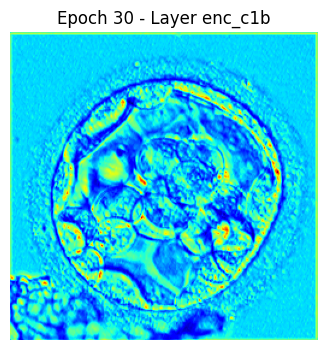

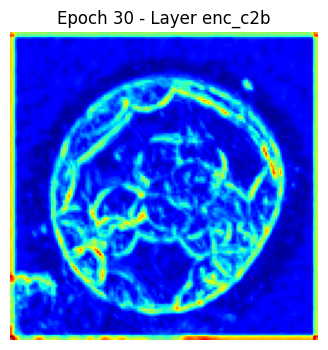

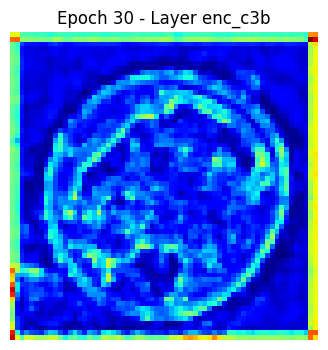

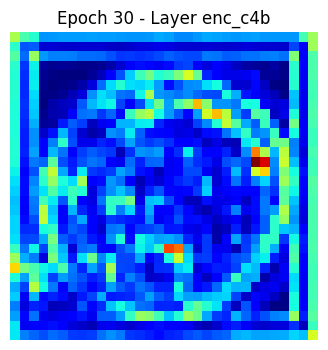

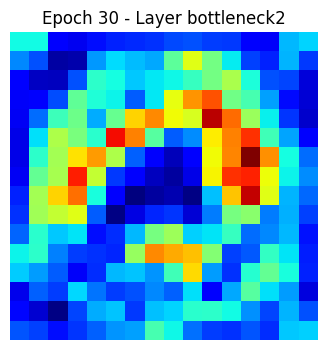

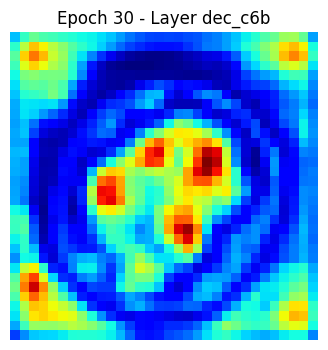

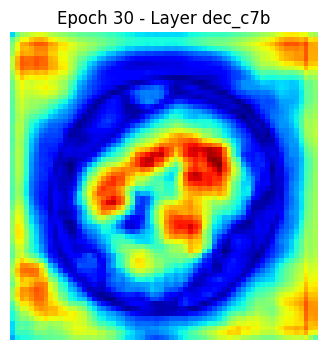

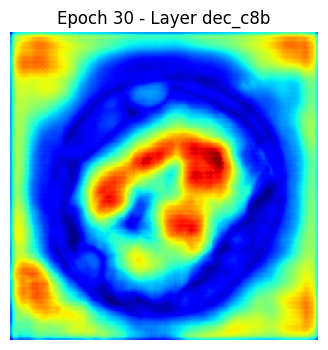

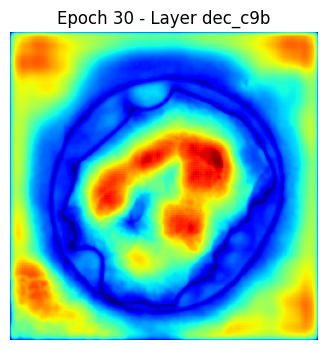

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 226ms/step - accuracy: 0.8696 - dice_coefficient: 0.9116 - iou_metric: 0.8379 - loss: 0.1400 - val_accuracy: 0.8661 - val_dice_coefficient: 0.8129 - val_iou_metric: 0.6896 - val_loss: 0.3333
Epoch 31/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 0.8711 - dice_coefficient: 0.9179 - iou_metric: 0.8486 - loss: 0.1303 - val_accuracy: 0.8680 - val_dice_coefficient: 0.8032 - val_iou_metric: 0.6765 - val_loss: 0.3544


Model: "UNet_with_CAB"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c1a (Conv2D)    │ (None, 256, 256,  │        640 │ input_layer[0][0] │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c1b (Conv2D)    │ (None, 256, 256,  │     36,928 │ enc_c1a[0][0]     │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1               │ (None, 128, 128,  │          0 │ enc_c1b[0][0]     │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c2a (Conv2D)    │ (None, 128, 128,  │     73,856 │ pool1[0][0]       │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c2b (Conv2D)    │ (None, 128, 128,  │    147,584 │ enc_c2a[0][0]     │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool2               │ (None, 64, 64,    │          0 │ enc_c2b[0][0]     │
│ (MaxPooling2D)      │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c3a (Conv2D)    │ (None, 64, 64,    │    295,168 │ pool2[0][0]       │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c3b (Conv2D)    │ (None, 64, 64,    │    590,080 │ enc_c3a[0][0]     │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool3               │ (None, 32, 32,    │          0 │ enc_c3b[0][0]     │
│ (MaxPooling2D)      │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c4a (Conv2D)    │ (None, 32, 32,    │  1,180,160 │ pool3[0][0]       │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c4b (Conv2D)    │ (None, 32, 32,    │  2,359,808 │ enc_c4a[0][0]     │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool4               │ (None, 16, 16,    │          0 │ enc_c4b[0][0]     │
│ (MaxPooling2D)      │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bottleneck1         │ (None, 16, 16,    │  4,719,616 │ pool4[0][0]       │
│ (Conv2D)            │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bottleneck2         │ (None, 16, 16,    │  9,438,208 │ bottleneck1[0][0] │
│ (Conv2D)            │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ CAB                 │ [(None, 256, 256, │      9,920 │ enc_c1b[0][0],    │
│ (ChannelAttentionB… │ 64), (None, 128,  │            │ enc_c2b[0][0],    │
│                     │ 128, 128), (None, │            │ enc_c3b[0][0],    │
│                     │ 64, 64, 256),     │            │ enc_c4b[0][0],  

 Total params: 93,121,541 (355.23 MB)

 Trainable params: 31,040,513 (118.41 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 62,081,028 (236.82 MB)

GFLOPs calculation not available, use tensorflow profiler for exact computation.
Training time for fold 2: 709.77s

--- Fold 3 ---
Epoch 1/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 46s 296ms/step - accuracy: 0.8740 - dice_coefficient: 0.1937 - iou_metric: 0.1086 - loss: 1.2863 - val_accuracy: 0.8340 - val_dice_coefficient: 0.5377 - val_iou_metric: 0.3692 - val_loss: 0.6427
Epoch 2/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 220ms/step - accuracy: 0.8228 - dice_coefficient: 0.5811 - iou_metric: 0.4122 - loss: 0.6375 - val_accuracy: 0.8430 - val_dice_coefficient: 0.6333 - val_iou_metric: 0.4653 - val_loss: 0.5332
Epoch 3/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 222ms/step - accuracy: 0.8346 - dice_coefficient: 0.6559 - iou_metric: 0.4895 - loss: 0.5361 - val_accuracy: 0.8325 - val_dice_coefficient: 0.6829 - val_iou_metric: 0.5208 - val_loss: 0.4952
Epoch 4/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 220ms/step - accuracy: 0.8390 - dice_coefficient: 0.7043 - iou_metric: 0.5446 - loss: 0.4657 - val_accuracy: 0.8554 

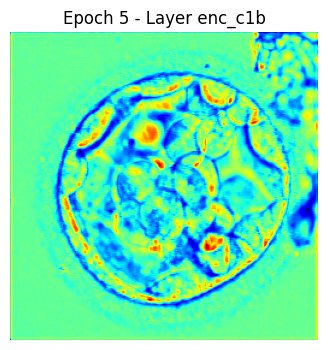

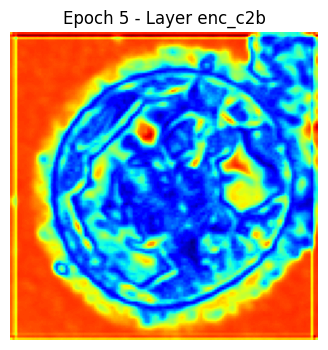

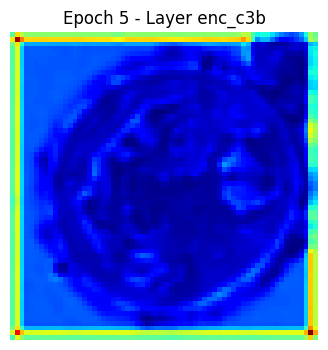

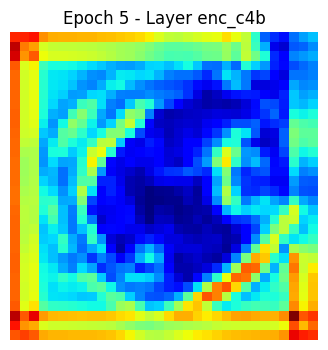

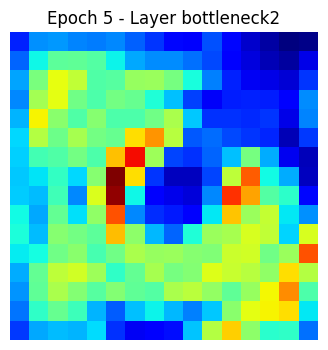

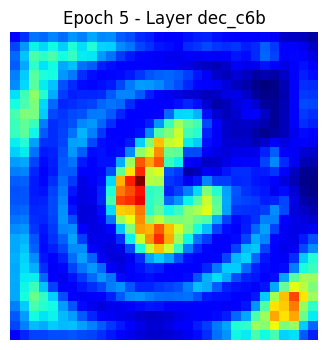

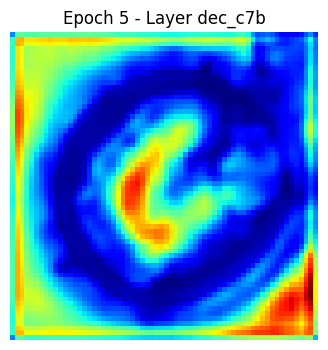

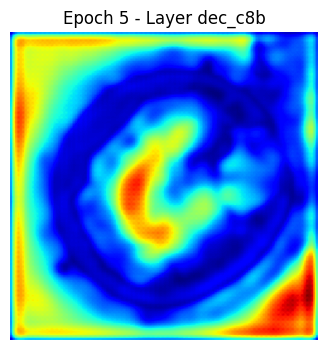

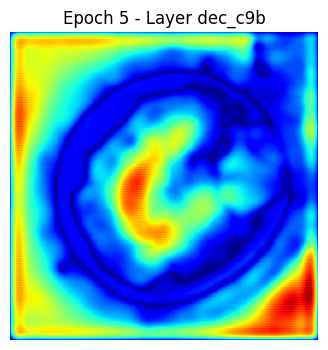

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accuracy: 0.8450 - dice_coefficient: 0.7346 - iou_metric: 0.5816 - loss: 0.4173 - val_accuracy: 0.8535 - val_dice_coefficient: 0.7642 - val_iou_metric: 0.6218 - val_loss: 0.4212
Epoch 6/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 0.8465 - dice_coefficient: 0.7556 - iou_metric: 0.6083 - loss: 0.3914 - val_accuracy: 0.8572 - val_dice_coefficient: 0.7500 - val_iou_metric: 0.6034 - val_loss: 0.3825
Epoch 7/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 0.8517 - dice_coefficient: 0.7771 - iou_metric: 0.6365 - loss: 0.3535 - val_accuracy: 0.8567 - val_dice_coefficient: 0.7296 - val_iou_metric: 0.5773 - val_loss: 0.3938
Epoch 8/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 0.8525 - dice_coefficient: 0.7844 - iou_metric: 0.6462 - loss: 0.3405 - val_accuracy: 0.8594 - val_dice_coefficient: 0.7639 - val_iou_metric: 0.6215 - val_loss: 0.3596
Epoch 9/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 220ms/step - accuracy: 

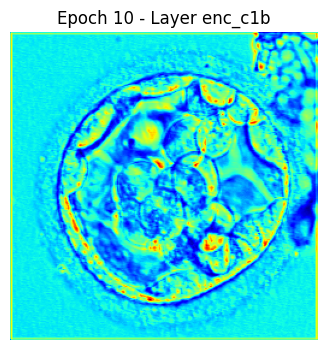

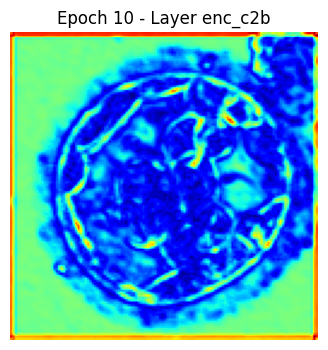

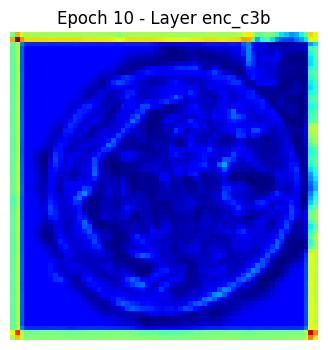

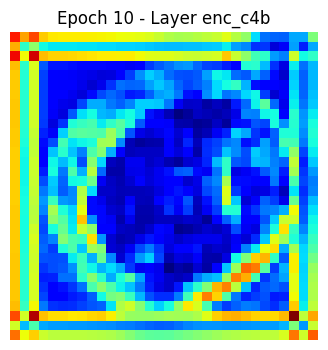

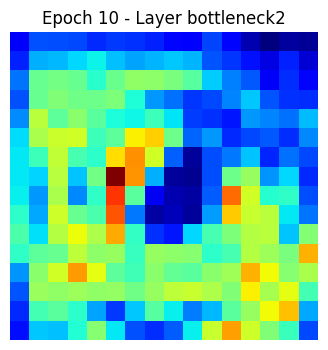

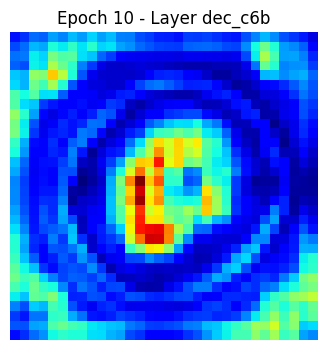

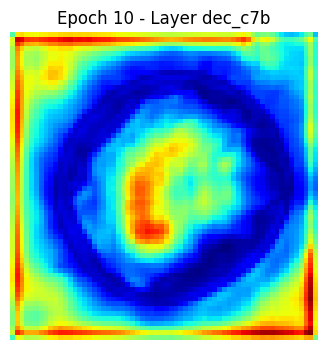

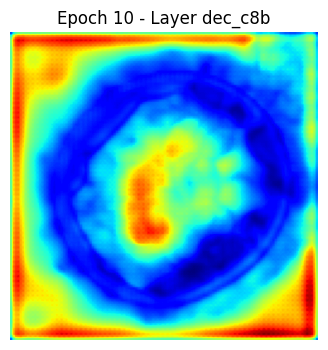

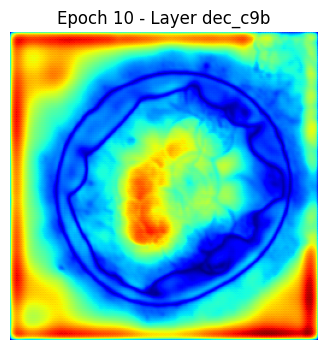

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 226ms/step - accuracy: 0.8531 - dice_coefficient: 0.8022 - iou_metric: 0.6708 - loss: 0.3169 - val_accuracy: 0.8611 - val_dice_coefficient: 0.7652 - val_iou_metric: 0.6233 - val_loss: 0.3502
Epoch 11/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 219ms/step - accuracy: 0.8552 - dice_coefficient: 0.8099 - iou_metric: 0.6813 - loss: 0.2995 - val_accuracy: 0.8639 - val_dice_coefficient: 0.7855 - val_iou_metric: 0.6505 - val_loss: 0.3301
Epoch 12/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 0.8553 - dice_coefficient: 0.8232 - iou_metric: 0.7004 - loss: 0.2850 - val_accuracy: 0.8641 - val_dice_coefficient: 0.7692 - val_iou_metric: 0.6285 - val_loss: 0.3411
Epoch 13/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 219ms/step - accuracy: 0.8562 - dice_coefficient: 0.8228 - iou_metric: 0.7000 - loss: 0.2819 - val_accuracy: 0.8623 - val_dice_coefficient: 0.7911 - val_iou_metric: 0.6583 - val_loss: 0.3201
Epoch 14/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accura

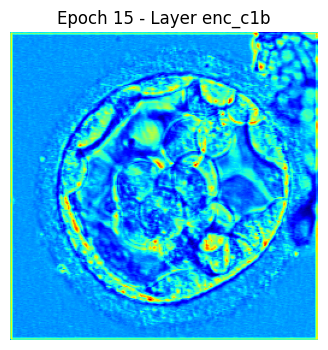

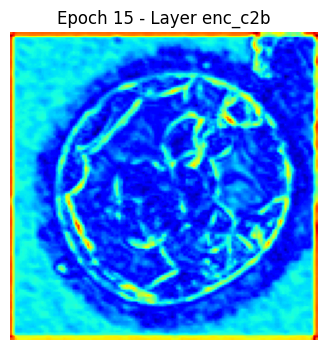

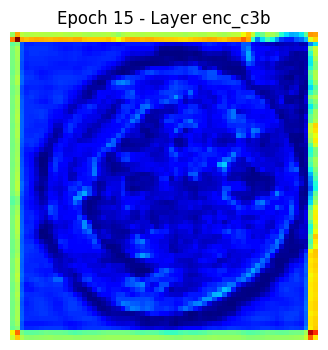

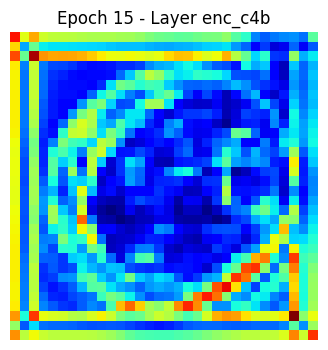

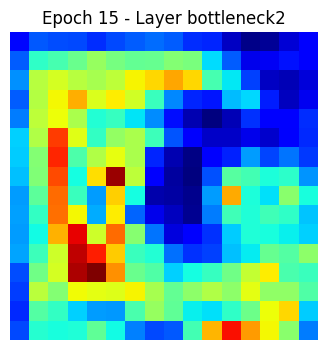

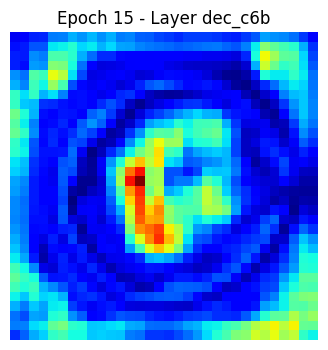

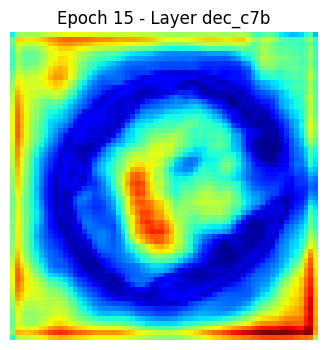

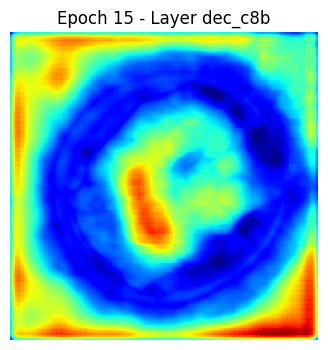

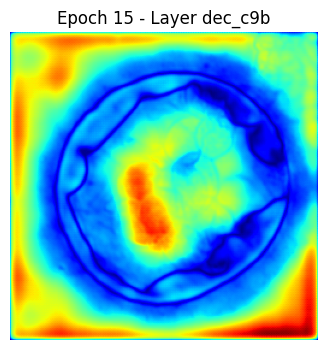

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accuracy: 0.8583 - dice_coefficient: 0.8352 - iou_metric: 0.7180 - loss: 0.2626 - val_accuracy: 0.8616 - val_dice_coefficient: 0.8014 - val_iou_metric: 0.6724 - val_loss: 0.3138
Epoch 16/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 0.8591 - dice_coefficient: 0.8427 - iou_metric: 0.7290 - loss: 0.2514 - val_accuracy: 0.8674 - val_dice_coefficient: 0.7912 - val_iou_metric: 0.6584 - val_loss: 0.3192
Epoch 17/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 219ms/step - accuracy: 0.8599 - dice_coefficient: 0.8436 - iou_metric: 0.7307 - loss: 0.2504 - val_accuracy: 0.8670 - val_dice_coefficient: 0.8052 - val_iou_metric: 0.6782 - val_loss: 0.3198
Epoch 18/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 0.8610 - dice_coefficient: 0.8536 - iou_metric: 0.7454 - loss: 0.2357 - val_accuracy: 0.8692 - val_dice_coefficient: 0.7891 - val_iou_metric: 0.6556 - val_loss: 0.3355
Epoch 19/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accura

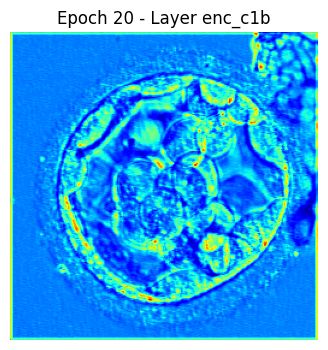

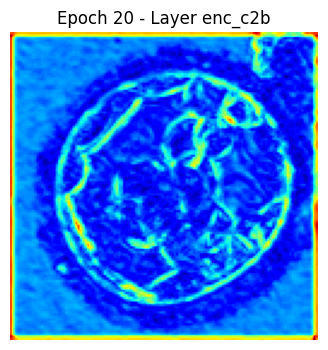

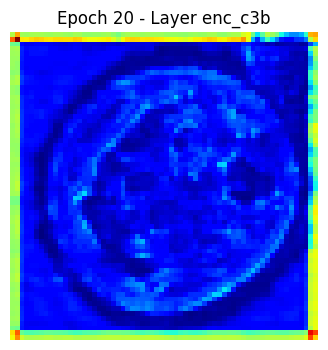

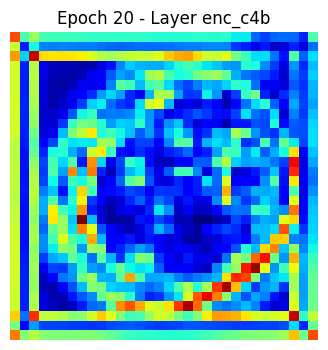

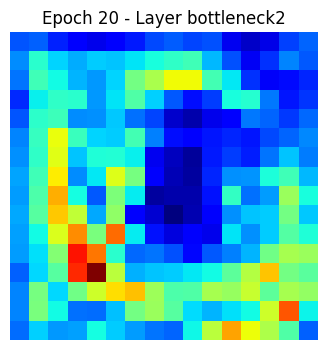

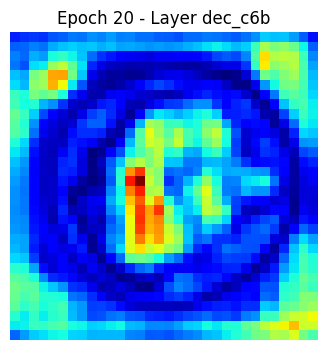

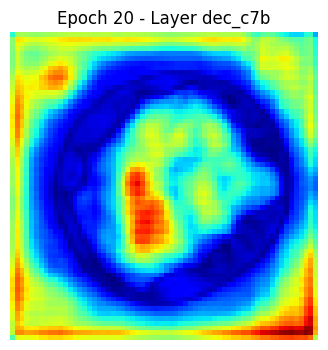

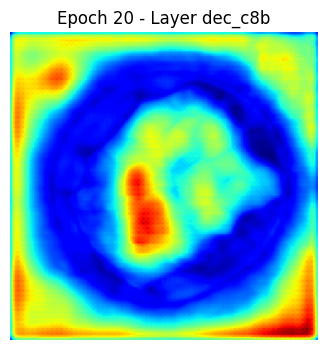

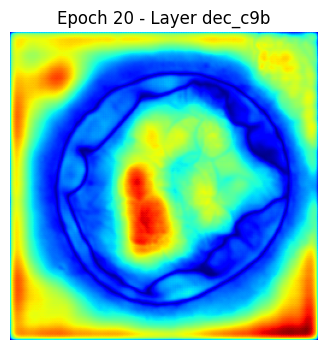

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accuracy: 0.8633 - dice_coefficient: 0.8661 - iou_metric: 0.7647 - loss: 0.2126 - val_accuracy: 0.8668 - val_dice_coefficient: 0.8099 - val_iou_metric: 0.6844 - val_loss: 0.3110
Epoch 21/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 219ms/step - accuracy: 0.8642 - dice_coefficient: 0.8714 - iou_metric: 0.7728 - loss: 0.2049 - val_accuracy: 0.8662 - val_dice_coefficient: 0.8175 - val_iou_metric: 0.6959 - val_loss: 0.3105
Epoch 22/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 0.8638 - dice_coefficient: 0.8784 - iou_metric: 0.7839 - loss: 0.1961 - val_accuracy: 0.8562 - val_dice_coefficient: 0.7166 - val_iou_metric: 0.5615 - val_loss: 0.4598
Epoch 23/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 0.8624 - dice_coefficient: 0.8661 - iou_metric: 0.7648 - loss: 0.2167 - val_accuracy: 0.8650 - val_dice_coefficient: 0.7999 - val_iou_metric: 0.6699 - val_loss: 0.3322
Epoch 24/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accura

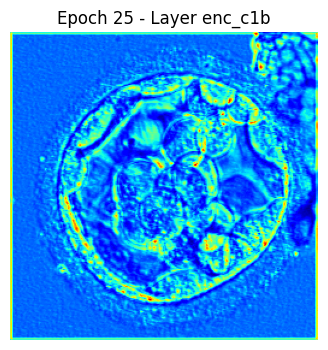

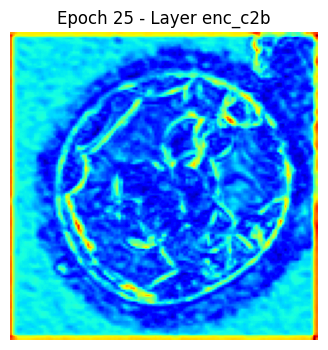

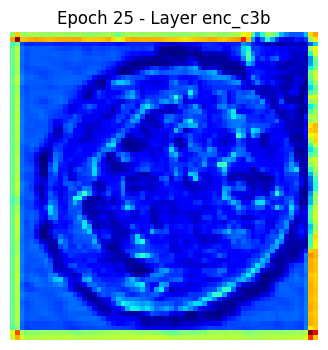

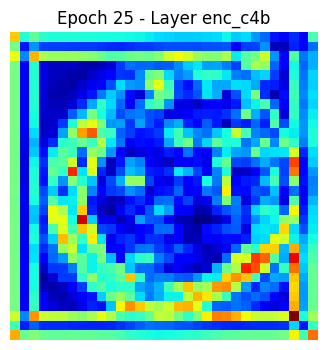

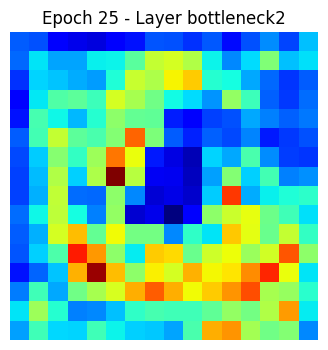

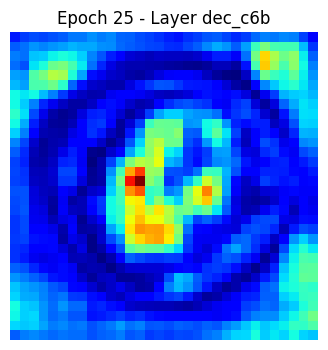

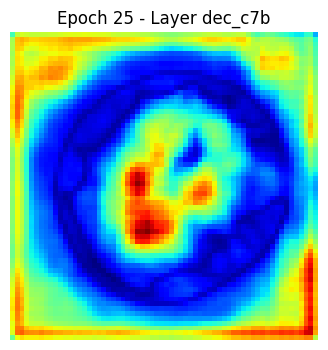

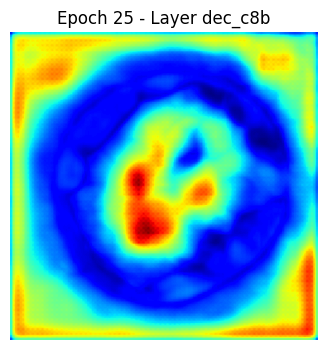

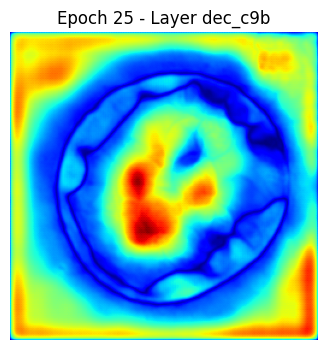

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accuracy: 0.8671 - dice_coefficient: 0.8927 - iou_metric: 0.8071 - loss: 0.1722 - val_accuracy: 0.8654 - val_dice_coefficient: 0.8207 - val_iou_metric: 0.6998 - val_loss: 0.3296
Epoch 26/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 0.8667 - dice_coefficient: 0.8981 - iou_metric: 0.8156 - loss: 0.1655 - val_accuracy: 0.8650 - val_dice_coefficient: 0.7938 - val_iou_metric: 0.6614 - val_loss: 0.3469
Epoch 27/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 0.8672 - dice_coefficient: 0.8947 - iou_metric: 0.8100 - loss: 0.1689 - val_accuracy: 0.8692 - val_dice_coefficient: 0.7834 - val_iou_metric: 0.6474 - val_loss: 0.3669
Epoch 28/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 0.8678 - dice_coefficient: 0.8986 - iou_metric: 0.8167 - loss: 0.1629 - val_accuracy: 0.8658 - val_dice_coefficient: 0.8089 - val_iou_metric: 0.6827 - val_loss: 0.3262
Epoch 29/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accura

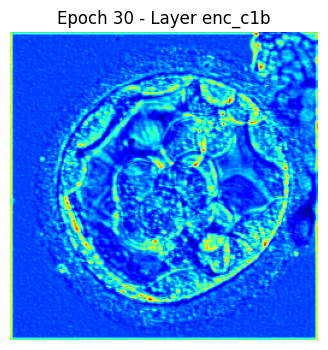

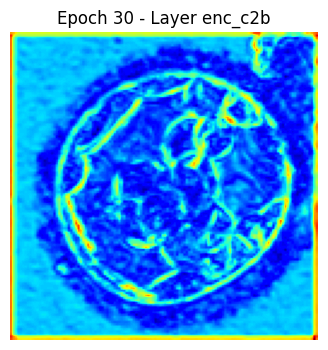

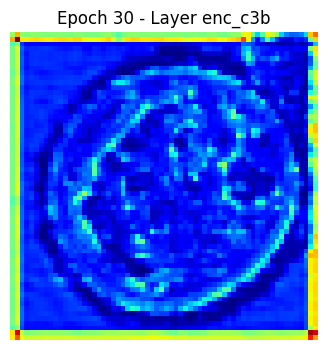

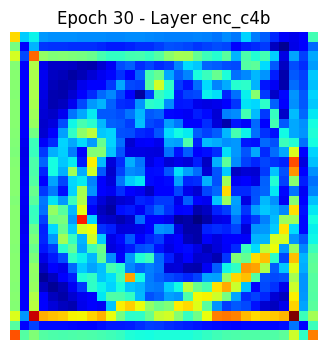

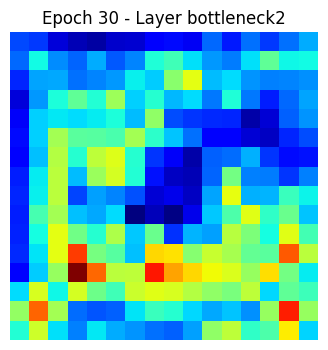

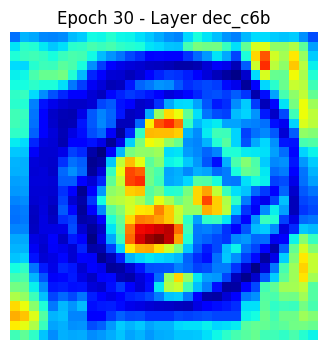

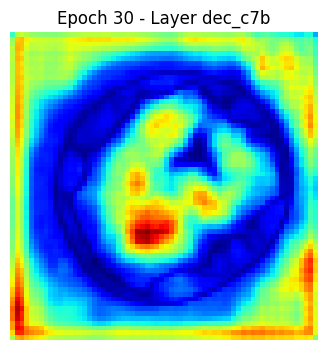

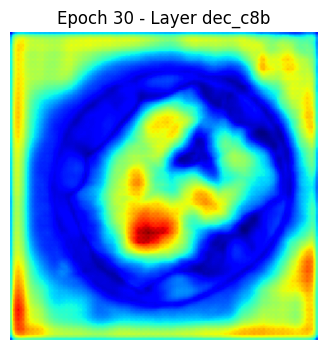

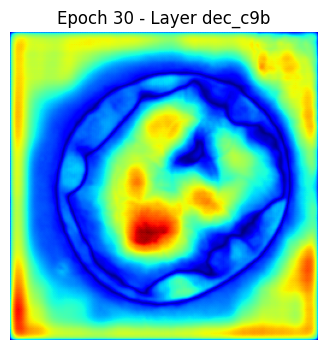

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 231ms/step - accuracy: 0.8679 - dice_coefficient: 0.9068 - iou_metric: 0.8300 - loss: 0.1487 - val_accuracy: 0.8641 - val_dice_coefficient: 0.8203 - val_iou_metric: 0.6989 - val_loss: 0.3370
Epoch 31/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 0.8694 - dice_coefficient: 0.9102 - iou_metric: 0.8357 - loss: 0.1440 - val_accuracy: 0.8671 - val_dice_coefficient: 0.7943 - val_iou_metric: 0.6622 - val_loss: 0.3670
Epoch 32/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 0.8682 - dice_coefficient: 0.9093 - iou_metric: 0.8342 - loss: 0.1454 - val_accuracy: 0.8660 - val_dice_coefficient: 0.8065 - val_iou_metric: 0.6796 - val_loss: 0.3345
Epoch 33/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 0.8685 - dice_coefficient: 0.9127 - iou_metric: 0.8398 - loss: 0.1397 - val_accuracy: 0.8696 - val_dice_coefficient: 0.8077 - val_iou_metric: 0.6811 - val_loss: 0.3444
Epoch 34/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 41s 218ms/step - accura

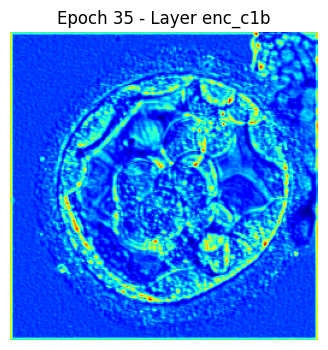

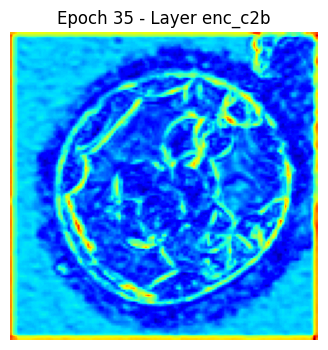

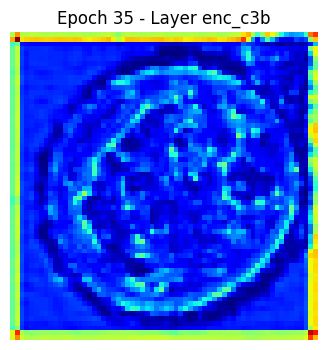

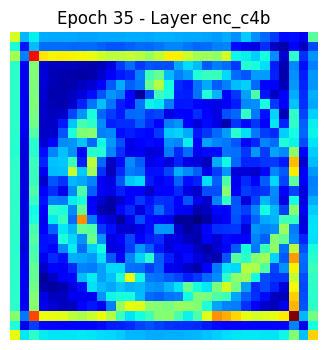

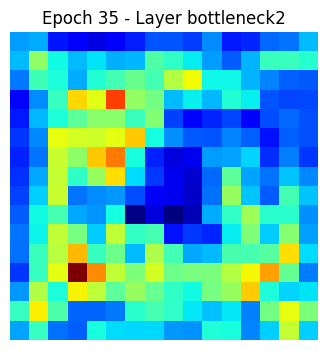

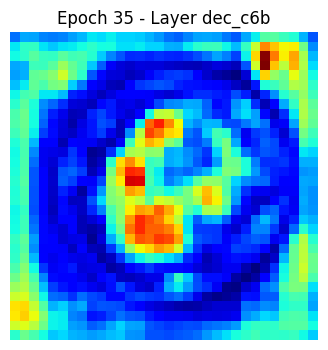

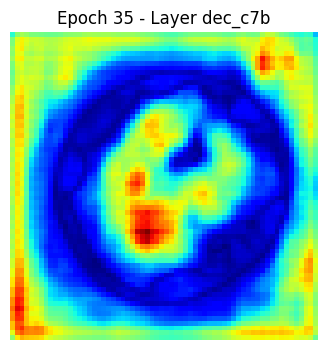

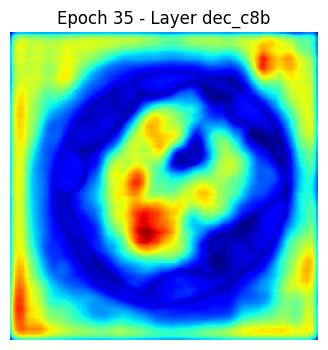

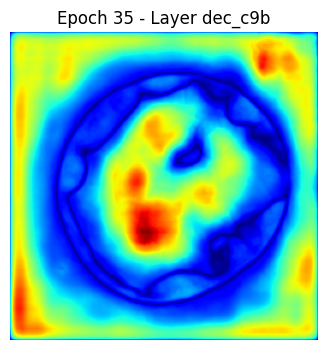

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 226ms/step - accuracy: 0.8700 - dice_coefficient: 0.9203 - iou_metric: 0.8526 - loss: 0.1262 - val_accuracy: 0.8703 - val_dice_coefficient: 0.8133 - val_iou_metric: 0.6894 - val_loss: 0.3524


Model: "UNet_with_CAB"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c1a (Conv2D)    │ (None, 256, 256,  │        640 │ input_layer[0][0] │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c1b (Conv2D)    │ (None, 256, 256,  │     36,928 │ enc_c1a[0][0]     │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1               │ (None, 128, 128,  │          0 │ enc_c1b[0][0]     │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c2a (Conv2D)    │ (None, 128, 128,  │     73,856 │ pool1[0][0]       │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c2b (Conv2D)    │ (None, 128, 128,  │    147,584 │ enc_c2a[0][0]     │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool2               │ (None, 64, 64,    │          0 │ enc_c2b[0][0]     │
│ (MaxPooling2D)      │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c3a (Conv2D)    │ (None, 64, 64,    │    295,168 │ pool2[0][0]       │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c3b (Conv2D)    │ (None, 64, 64,    │    590,080 │ enc_c3a[0][0]     │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool3               │ (None, 32, 32,    │          0 │ enc_c3b[0][0]     │
│ (MaxPooling2D)      │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c4a (Conv2D)    │ (None, 32, 32,    │  1,180,160 │ pool3[0][0]       │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c4b (Conv2D)    │ (None, 32, 32,    │  2,359,808 │ enc_c4a[0][0]     │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool4               │ (None, 16, 16,    │          0 │ enc_c4b[0][0]     │
│ (MaxPooling2D)      │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bottleneck1         │ (None, 16, 16,    │  4,719,616 │ pool4[0][0]       │
│ (Conv2D)            │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bottleneck2         │ (None, 16, 16,    │  9,438,208 │ bottleneck1[0][0] │
│ (Conv2D)            │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ CAB                 │ [(None, 256, 256, │      9,920 │ enc_c1b[0][0],    │
│ (ChannelAttentionB… │ 64), (None, 128,  │            │ enc_c2b[0][0],    │
│                     │ 128, 128), (None, │            │ enc_c3b[0][0],    │
│                     │ 64, 64, 256),     │            │ enc_c4b[0][0],  

 Total params: 93,121,541 (355.23 MB)

 Trainable params: 31,040,513 (118.41 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 62,081,028 (236.82 MB)

GFLOPs calculation not available, use tensorflow profiler for exact computation.
Training time for fold 3: 818.20s

--- Fold 4 ---
Epoch 1/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 45s 289ms/step - accuracy: 0.8609 - dice_coefficient: 0.1824 - iou_metric: 0.1012 - loss: 1.2874 - val_accuracy: 0.7744 - val_dice_coefficient: 0.4762 - val_iou_metric: 0.3140 - val_loss: 0.7675
Epoch 2/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 221ms/step - accuracy: 0.7907 - dice_coefficient: 0.4944 - iou_metric: 0.3298 - loss: 0.7712 - val_accuracy: 0.8331 - val_dice_coefficient: 0.5700 - val_iou_metric: 0.4010 - val_loss: 0.6116
Epoch 3/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 221ms/step - accuracy: 0.8232 - dice_coefficient: 0.6198 - iou_metric: 0.4508 - loss: 0.5922 - val_accuracy: 0.8424 - val_dice_coefficient: 0.6437 - val_iou_metric: 0.4783 - val_loss: 0.5664
Epoch 4/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 220ms/step - accuracy: 0.8337 - dice_coefficient: 0.6648 - iou_metric: 0.4993 - loss: 0.5293 - val_accuracy: 0.8363 

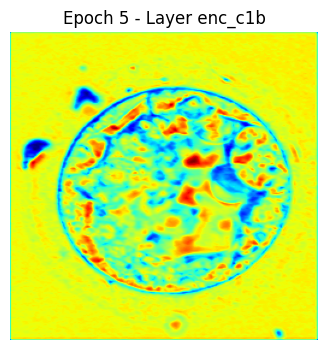

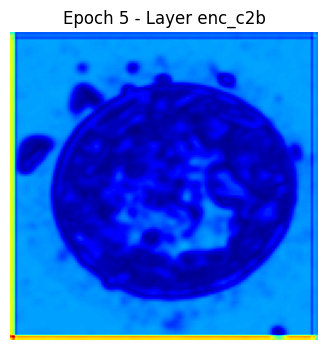

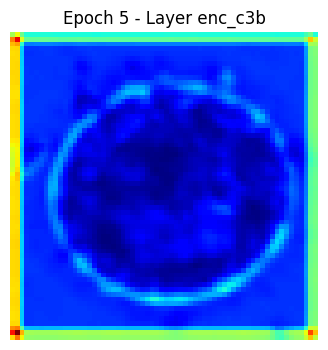

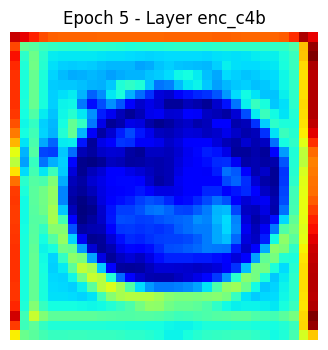

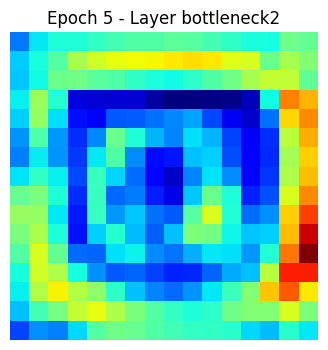

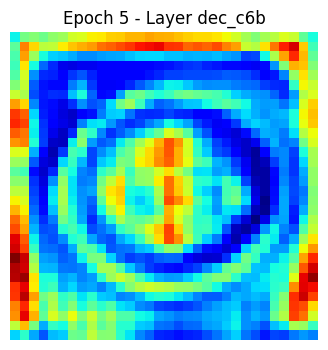

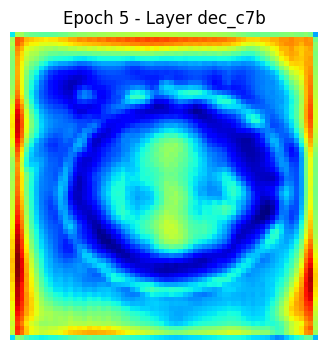

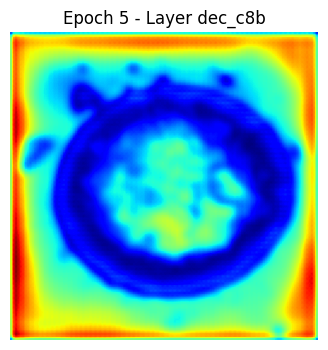

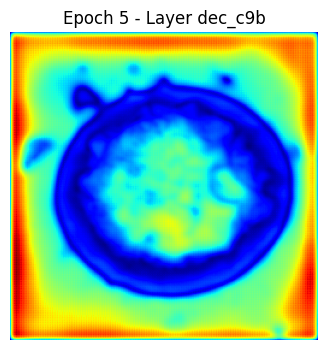

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accuracy: 0.8425 - dice_coefficient: 0.7270 - iou_metric: 0.5721 - loss: 0.4313 - val_accuracy: 0.8601 - val_dice_coefficient: 0.7132 - val_iou_metric: 0.5600 - val_loss: 0.4351
Epoch 6/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 220ms/step - accuracy: 0.8460 - dice_coefficient: 0.7495 - iou_metric: 0.6001 - loss: 0.3955 - val_accuracy: 0.8547 - val_dice_coefficient: 0.7466 - val_iou_metric: 0.6013 - val_loss: 0.3930
Epoch 7/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 220ms/step - accuracy: 0.8489 - dice_coefficient: 0.7736 - iou_metric: 0.6317 - loss: 0.3595 - val_accuracy: 0.8584 - val_dice_coefficient: 0.7510 - val_iou_metric: 0.6075 - val_loss: 0.3772
Epoch 8/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 219ms/step - accuracy: 0.8516 - dice_coefficient: 0.7833 - iou_metric: 0.6445 - loss: 0.3422 - val_accuracy: 0.8576 - val_dice_coefficient: 0.7657 - val_iou_metric: 0.6268 - val_loss: 0.3709
Epoch 9/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 

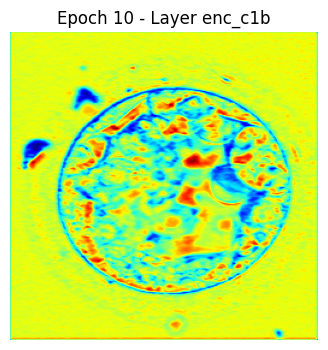

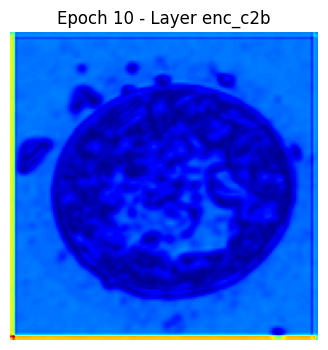

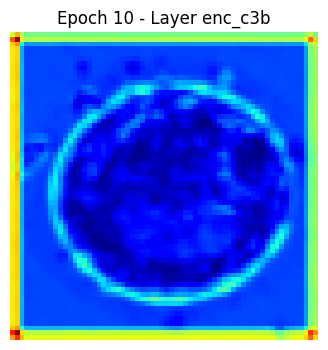

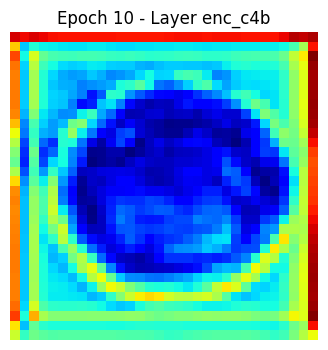

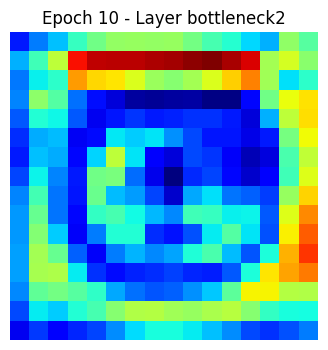

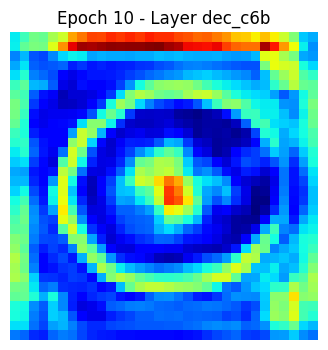

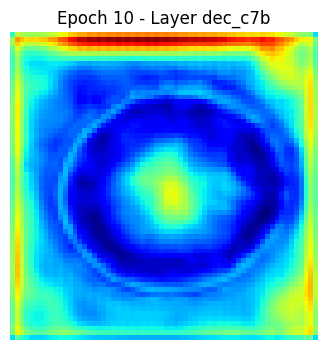

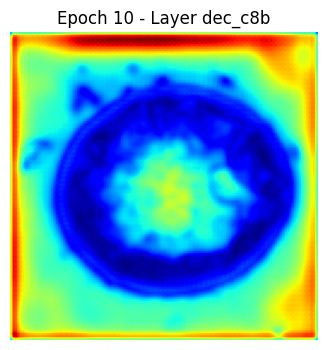

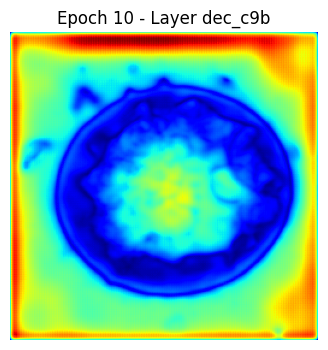

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accuracy: 0.8538 - dice_coefficient: 0.7954 - iou_metric: 0.6614 - loss: 0.3245 - val_accuracy: 0.8626 - val_dice_coefficient: 0.7731 - val_iou_metric: 0.6375 - val_loss: 0.3528
Epoch 11/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 0.8560 - dice_coefficient: 0.8137 - iou_metric: 0.6866 - loss: 0.2966 - val_accuracy: 0.8641 - val_dice_coefficient: 0.7685 - val_iou_metric: 0.6312 - val_loss: 0.3479
Epoch 12/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 219ms/step - accuracy: 0.8567 - dice_coefficient: 0.8124 - iou_metric: 0.6852 - loss: 0.2982 - val_accuracy: 0.8660 - val_dice_coefficient: 0.7837 - val_iou_metric: 0.6524 - val_loss: 0.3459
Epoch 13/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 219ms/step - accuracy: 0.8577 - dice_coefficient: 0.8251 - iou_metric: 0.7031 - loss: 0.2809 - val_accuracy: 0.8647 - val_dice_coefficient: 0.7910 - val_iou_metric: 0.6619 - val_loss: 0.3287
Epoch 14/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accura

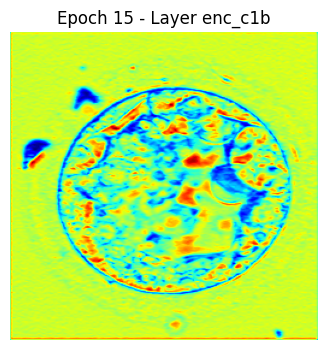

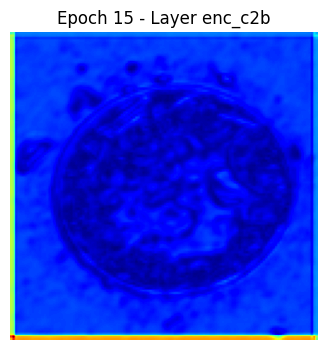

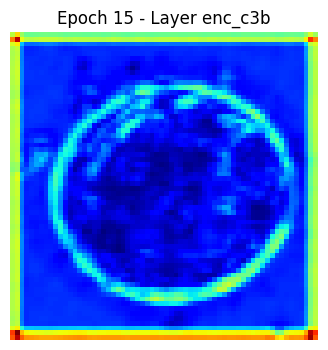

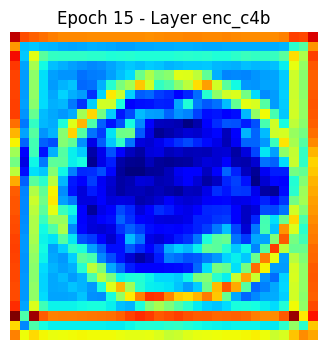

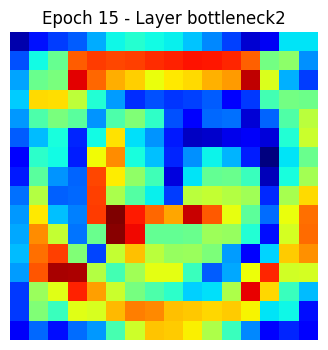

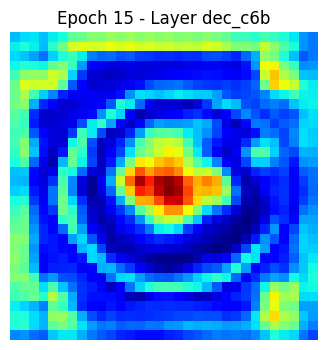

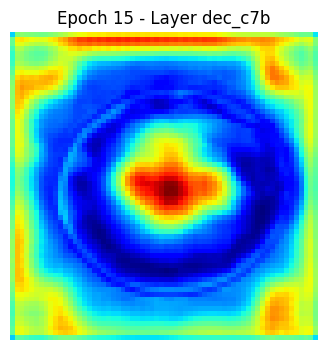

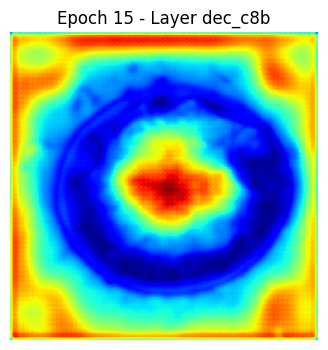

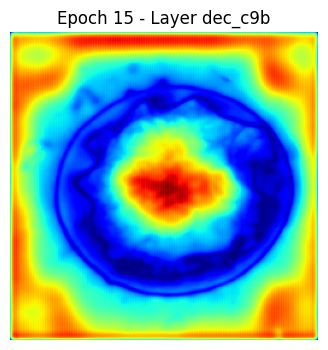

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 233ms/step - accuracy: 0.8587 - dice_coefficient: 0.8289 - iou_metric: 0.7087 - loss: 0.2715 - val_accuracy: 0.8686 - val_dice_coefficient: 0.7955 - val_iou_metric: 0.6693 - val_loss: 0.3283
Epoch 16/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 0.8600 - dice_coefficient: 0.8430 - iou_metric: 0.7295 - loss: 0.2535 - val_accuracy: 0.8674 - val_dice_coefficient: 0.7929 - val_iou_metric: 0.6646 - val_loss: 0.3218
Epoch 17/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 219ms/step - accuracy: 0.8601 - dice_coefficient: 0.8451 - iou_metric: 0.7327 - loss: 0.2479 - val_accuracy: 0.8650 - val_dice_coefficient: 0.8036 - val_iou_metric: 0.6795 - val_loss: 0.3056
Epoch 18/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 0.8605 - dice_coefficient: 0.8541 - iou_metric: 0.7460 - loss: 0.2350 - val_accuracy: 0.8717 - val_dice_coefficient: 0.7616 - val_iou_metric: 0.6230 - val_loss: 0.3689
Epoch 19/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accura

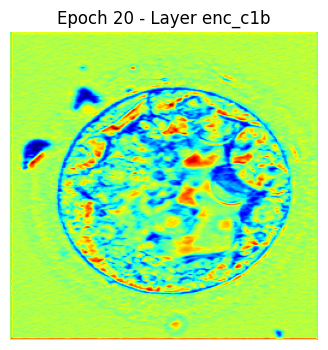

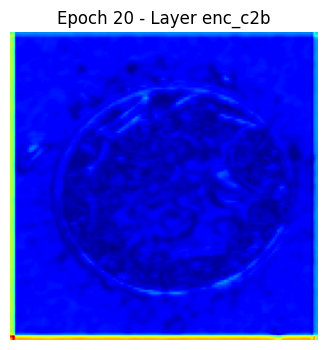

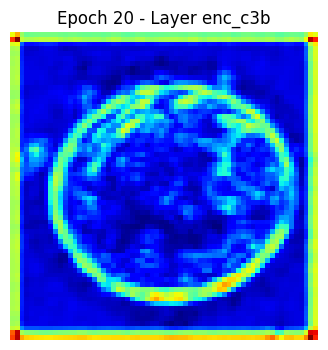

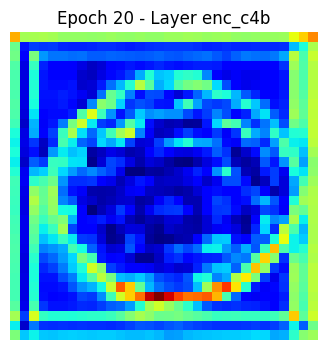

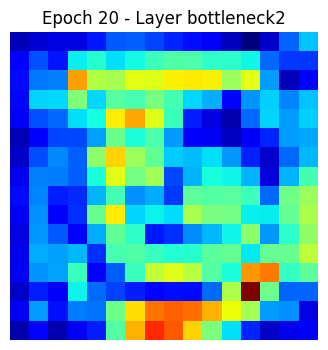

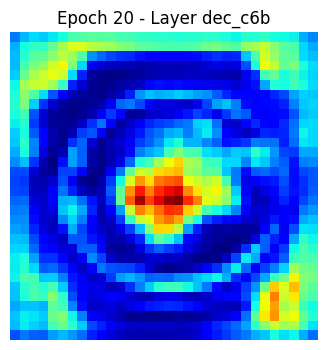

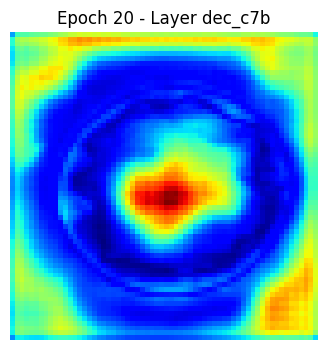

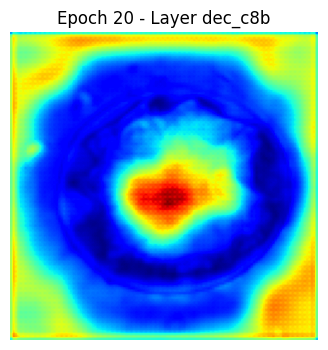

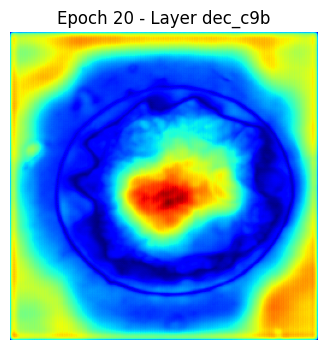

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 226ms/step - accuracy: 0.8636 - dice_coefficient: 0.8628 - iou_metric: 0.7594 - loss: 0.2185 - val_accuracy: 0.8690 - val_dice_coefficient: 0.7954 - val_iou_metric: 0.6683 - val_loss: 0.3130
Epoch 21/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 219ms/step - accuracy: 0.8637 - dice_coefficient: 0.8654 - iou_metric: 0.7638 - loss: 0.2140 - val_accuracy: 0.8684 - val_dice_coefficient: 0.8106 - val_iou_metric: 0.6896 - val_loss: 0.3281
Epoch 22/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 0.8647 - dice_coefficient: 0.8774 - iou_metric: 0.7823 - loss: 0.1992 - val_accuracy: 0.8639 - val_dice_coefficient: 0.8001 - val_iou_metric: 0.6748 - val_loss: 0.3213
Epoch 23/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 219ms/step - accuracy: 0.8653 - dice_coefficient: 0.8784 - iou_metric: 0.7839 - loss: 0.1953 - val_accuracy: 0.8649 - val_dice_coefficient: 0.8056 - val_iou_metric: 0.6823 - val_loss: 0.3148
Epoch 24/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 219ms/step - accura

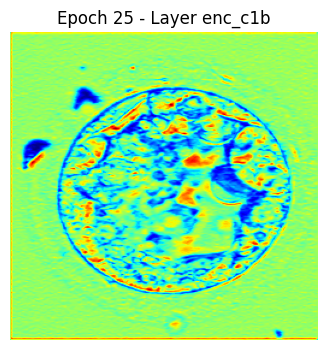

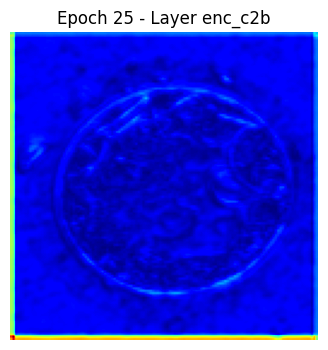

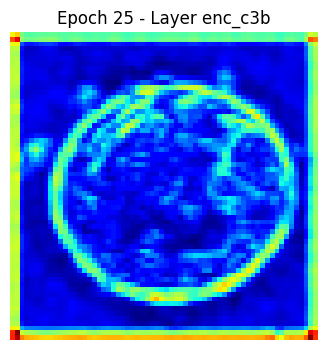

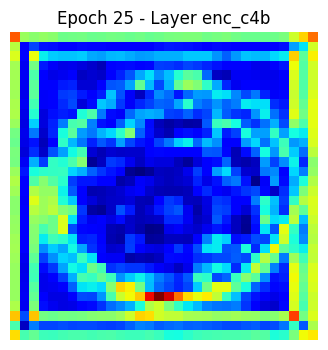

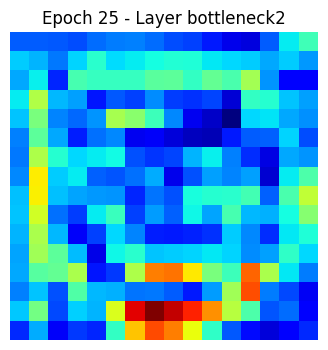

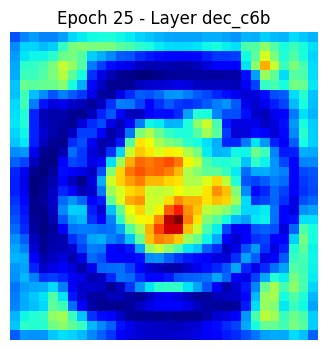

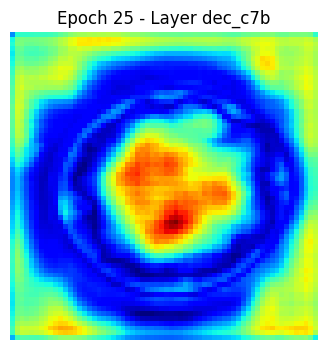

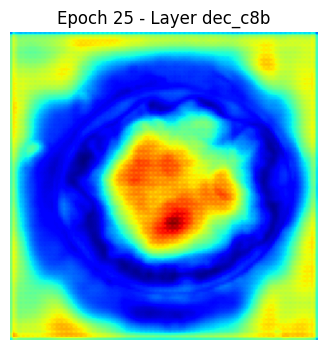

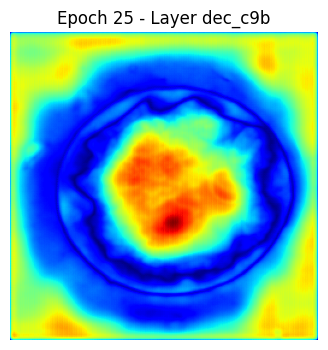

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 226ms/step - accuracy: 0.8671 - dice_coefficient: 0.8916 - iou_metric: 0.8051 - loss: 0.1739 - val_accuracy: 0.8663 - val_dice_coefficient: 0.8082 - val_iou_metric: 0.6855 - val_loss: 0.3248
Epoch 26/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 0.8671 - dice_coefficient: 0.8943 - iou_metric: 0.8095 - loss: 0.1696 - val_accuracy: 0.8683 - val_dice_coefficient: 0.7791 - val_iou_metric: 0.6469 - val_loss: 0.3882
Epoch 27/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 0.8664 - dice_coefficient: 0.8870 - iou_metric: 0.7976 - loss: 0.1804 - val_accuracy: 0.8618 - val_dice_coefficient: 0.8057 - val_iou_metric: 0.6815 - val_loss: 0.3428
Epoch 28/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 0.8671 - dice_coefficient: 0.8975 - iou_metric: 0.8145 - loss: 0.1638 - val_accuracy: 0.8677 - val_dice_coefficient: 0.8107 - val_iou_metric: 0.6895 - val_loss: 0.3187
Epoch 29/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accura

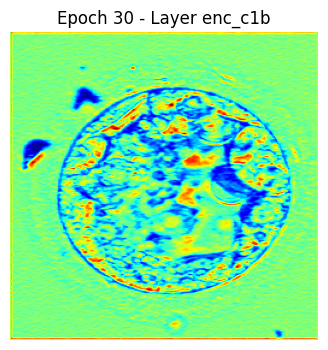

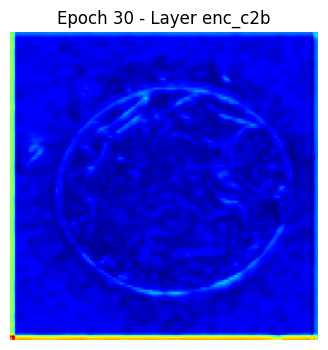

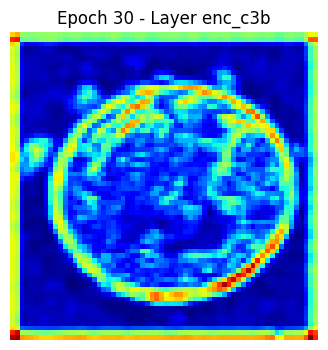

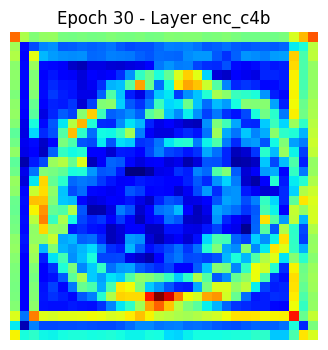

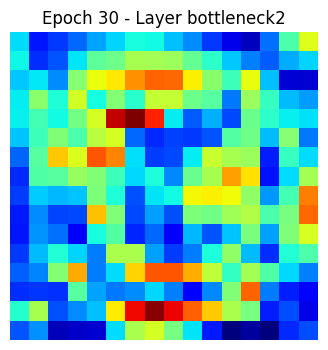

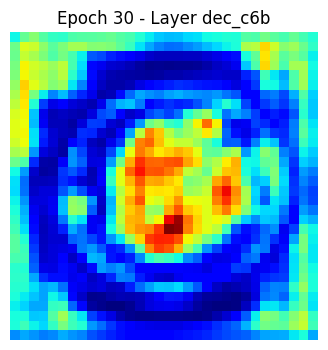

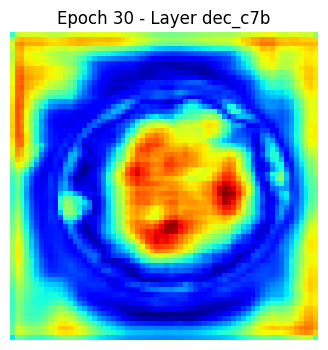

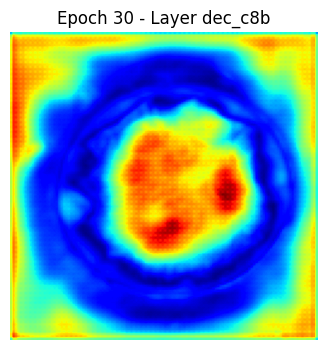

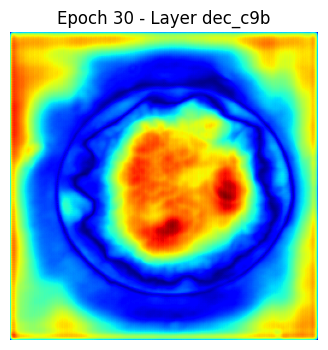

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 226ms/step - accuracy: 0.8682 - dice_coefficient: 0.9065 - iou_metric: 0.8294 - loss: 0.1503 - val_accuracy: 0.8648 - val_dice_coefficient: 0.7983 - val_iou_metric: 0.6711 - val_loss: 0.3453
Epoch 31/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 0.8691 - dice_coefficient: 0.9061 - iou_metric: 0.8288 - loss: 0.1492 - val_accuracy: 0.8668 - val_dice_coefficient: 0.7793 - val_iou_metric: 0.6452 - val_loss: 0.3785
Epoch 32/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 0.8680 - dice_coefficient: 0.9049 - iou_metric: 0.8269 - loss: 0.1512 - val_accuracy: 0.8645 - val_dice_coefficient: 0.8124 - val_iou_metric: 0.6909 - val_loss: 0.3451
Epoch 33/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 0.8697 - dice_coefficient: 0.9106 - iou_metric: 0.8364 - loss: 0.1420 - val_accuracy: 0.8629 - val_dice_coefficient: 0.7999 - val_iou_metric: 0.6741 - val_loss: 0.3433
Epoch 34/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accura

Model: "UNet_with_CAB"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c1a (Conv2D)    │ (None, 256, 256,  │        640 │ input_layer[0][0] │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c1b (Conv2D)    │ (None, 256, 256,  │     36,928 │ enc_c1a[0][0]     │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1               │ (None, 128, 128,  │          0 │ enc_c1b[0][0]     │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c2a (Conv2D)    │ (None, 128, 128,  │     73,856 │ pool1[0][0]       │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c2b (Conv2D)    │ (None, 128, 128,  │    147,584 │ enc_c2a[0][0]     │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool2               │ (None, 64, 64,    │          0 │ enc_c2b[0][0]     │
│ (MaxPooling2D)      │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c3a (Conv2D)    │ (None, 64, 64,    │    295,168 │ pool2[0][0]       │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c3b (Conv2D)    │ (None, 64, 64,    │    590,080 │ enc_c3a[0][0]     │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool3               │ (None, 32, 32,    │          0 │ enc_c3b[0][0]     │
│ (MaxPooling2D)      │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c4a (Conv2D)    │ (None, 32, 32,    │  1,180,160 │ pool3[0][0]       │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c4b (Conv2D)    │ (None, 32, 32,    │  2,359,808 │ enc_c4a[0][0]     │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool4               │ (None, 16, 16,    │          0 │ enc_c4b[0][0]     │
│ (MaxPooling2D)      │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bottleneck1         │ (None, 16, 16,    │  4,719,616 │ pool4[0][0]       │
│ (Conv2D)            │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bottleneck2         │ (None, 16, 16,    │  9,438,208 │ bottleneck1[0][0] │
│ (Conv2D)            │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ CAB                 │ [(None, 256, 256, │      9,920 │ enc_c1b[0][0],    │
│ (ChannelAttentionB… │ 64), (None, 128,  │            │ enc_c2b[0][0],    │
│                     │ 128, 128), (None, │            │ enc_c3b[0][0],    │
│                     │ 64, 64, 256),     │            │ enc_c4b[0][0],  

 Total params: 93,121,541 (355.23 MB)

 Trainable params: 31,040,513 (118.41 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 62,081,028 (236.82 MB)

GFLOPs calculation not available, use tensorflow profiler for exact computation.
Training time for fold 4: 776.05s

--- Fold 5 ---
Epoch 1/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 45s 288ms/step - accuracy: 0.8713 - dice_coefficient: 0.1960 - iou_metric: 0.1106 - loss: 1.2739 - val_accuracy: 0.8757 - val_dice_coefficient: 0.3339 - val_iou_metric: 0.2016 - val_loss: 0.9038
Epoch 2/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 220ms/step - accuracy: 0.8191 - dice_coefficient: 0.4701 - iou_metric: 0.3109 - loss: 0.7454 - val_accuracy: 0.8506 - val_dice_coefficient: 0.6135 - val_iou_metric: 0.4436 - val_loss: 0.5673
Epoch 3/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 220ms/step - accuracy: 0.8335 - dice_coefficient: 0.6658 - iou_metric: 0.4999 - loss: 0.5234 - val_accuracy: 0.8503 - val_dice_coefficient: 0.6618 - val_iou_metric: 0.4956 - val_loss: 0.4882
Epoch 4/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 220ms/step - accuracy: 0.8416 - dice_coefficient: 0.7114 - iou_metric: 0.5529 - loss: 0.4544 - val_accuracy: 0.8552 

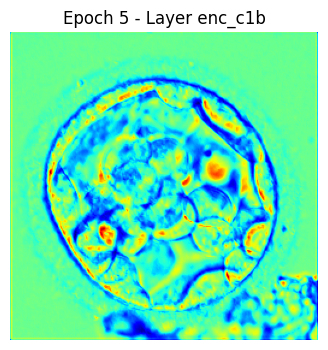

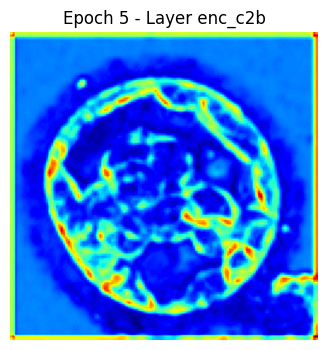

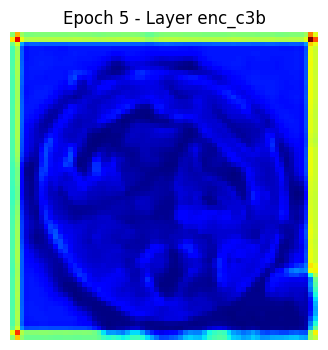

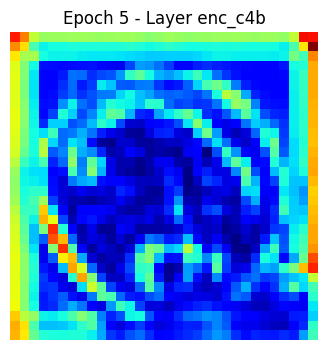

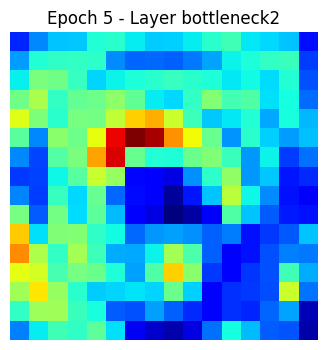

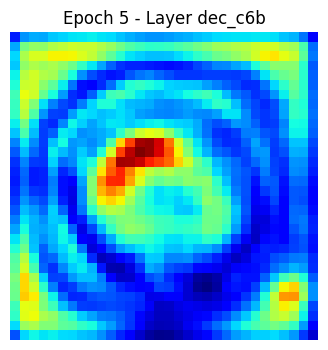

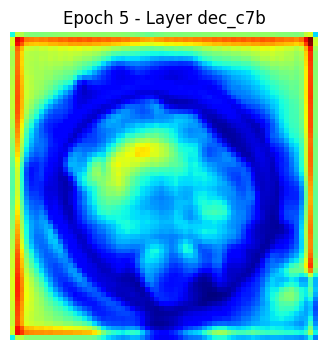

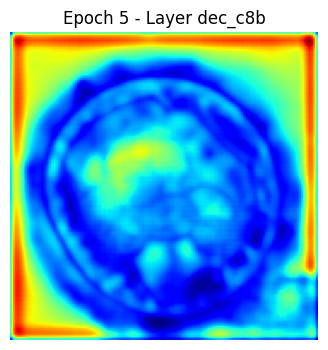

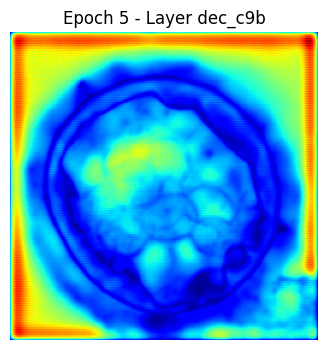

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accuracy: 0.8437 - dice_coefficient: 0.7428 - iou_metric: 0.5917 - loss: 0.4113 - val_accuracy: 0.8584 - val_dice_coefficient: 0.7424 - val_iou_metric: 0.5919 - val_loss: 0.4022
Epoch 6/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 0.8472 - dice_coefficient: 0.7561 - iou_metric: 0.6087 - loss: 0.3869 - val_accuracy: 0.8621 - val_dice_coefficient: 0.6972 - val_iou_metric: 0.5366 - val_loss: 0.4292
Epoch 7/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 0.8495 - dice_coefficient: 0.7697 - iou_metric: 0.6266 - loss: 0.3652 - val_accuracy: 0.8550 - val_dice_coefficient: 0.7301 - val_iou_metric: 0.5765 - val_loss: 0.3966
Epoch 8/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 219ms/step - accuracy: 0.8518 - dice_coefficient: 0.7819 - iou_metric: 0.6431 - loss: 0.3472 - val_accuracy: 0.8577 - val_dice_coefficient: 0.7605 - val_iou_metric: 0.6156 - val_loss: 0.3661
Epoch 9/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 219ms/step - accuracy: 

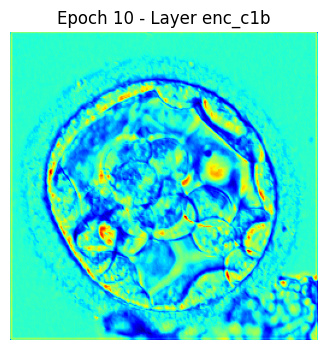

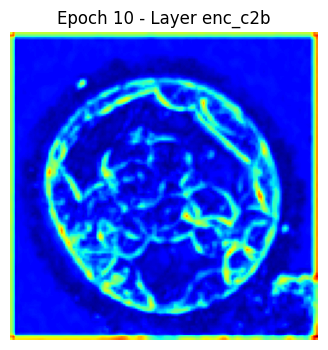

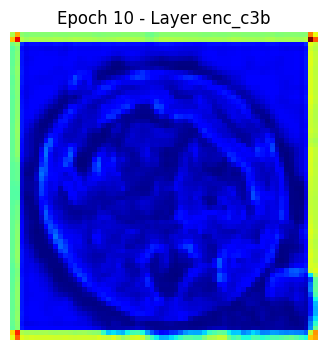

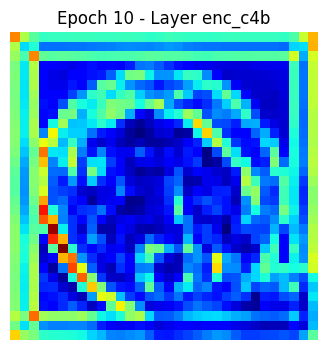

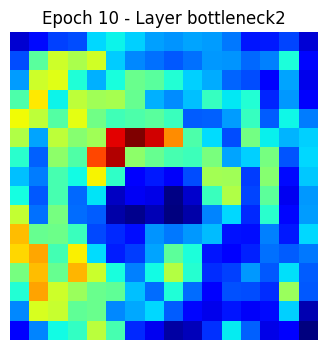

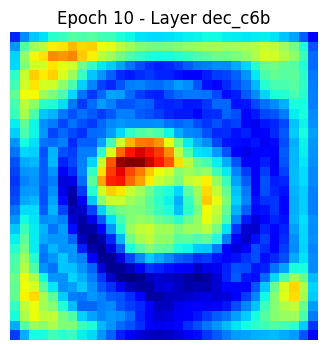

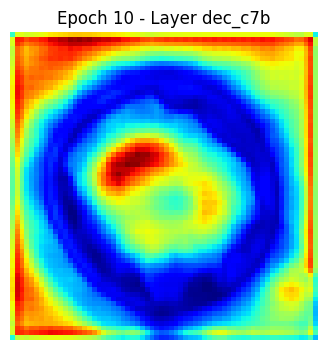

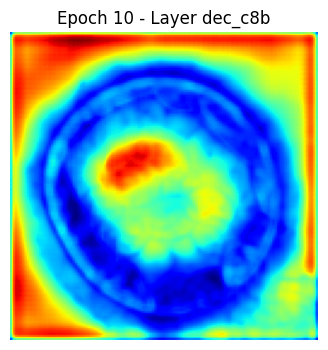

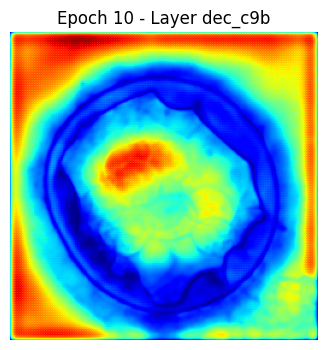

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 226ms/step - accuracy: 0.8536 - dice_coefficient: 0.8083 - iou_metric: 0.6793 - loss: 0.3077 - val_accuracy: 0.8631 - val_dice_coefficient: 0.7801 - val_iou_metric: 0.6418 - val_loss: 0.3418
Epoch 11/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 0.8542 - dice_coefficient: 0.8172 - iou_metric: 0.6917 - loss: 0.2947 - val_accuracy: 0.8629 - val_dice_coefficient: 0.7613 - val_iou_metric: 0.6168 - val_loss: 0.3638
Epoch 12/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 0.8557 - dice_coefficient: 0.8152 - iou_metric: 0.6892 - loss: 0.2935 - val_accuracy: 0.8578 - val_dice_coefficient: 0.7642 - val_iou_metric: 0.6204 - val_loss: 0.3583
Epoch 13/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 219ms/step - accuracy: 0.8558 - dice_coefficient: 0.8186 - iou_metric: 0.6942 - loss: 0.2857 - val_accuracy: 0.8650 - val_dice_coefficient: 0.7957 - val_iou_metric: 0.6633 - val_loss: 0.3266
Epoch 14/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accura

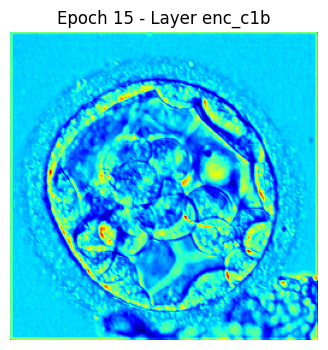

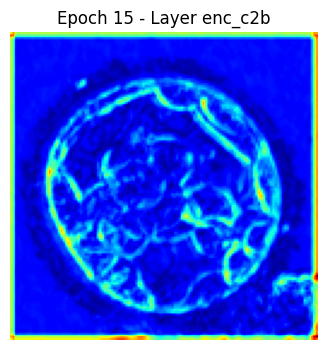

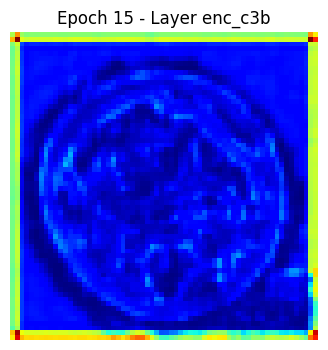

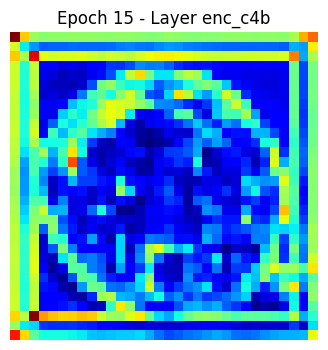

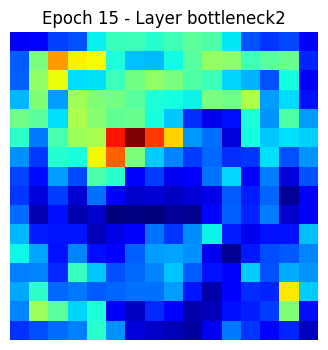

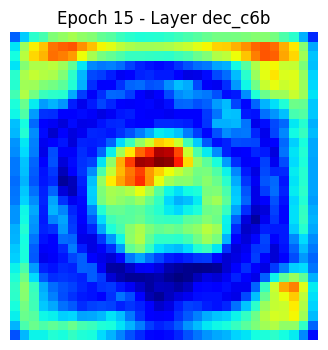

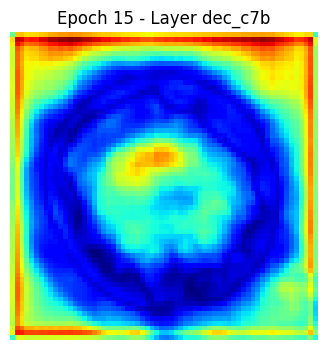

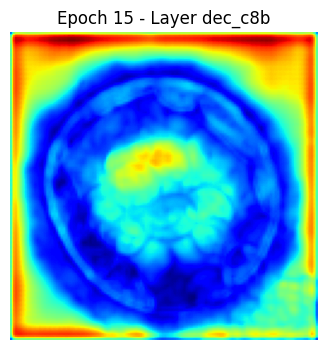

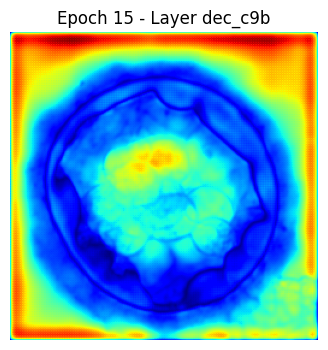

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 226ms/step - accuracy: 0.8586 - dice_coefficient: 0.8364 - iou_metric: 0.7198 - loss: 0.2597 - val_accuracy: 0.8614 - val_dice_coefficient: 0.7933 - val_iou_metric: 0.6599 - val_loss: 0.3230
Epoch 16/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 219ms/step - accuracy: 0.8596 - dice_coefficient: 0.8474 - iou_metric: 0.7363 - loss: 0.2443 - val_accuracy: 0.8647 - val_dice_coefficient: 0.8016 - val_iou_metric: 0.6717 - val_loss: 0.3214
Epoch 17/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 219ms/step - accuracy: 0.8607 - dice_coefficient: 0.8574 - iou_metric: 0.7512 - loss: 0.2277 - val_accuracy: 0.8622 - val_dice_coefficient: 0.8027 - val_iou_metric: 0.6728 - val_loss: 0.3149
Epoch 18/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 219ms/step - accuracy: 0.8620 - dice_coefficient: 0.8656 - iou_metric: 0.7638 - loss: 0.2158 - val_accuracy: 0.8624 - val_dice_coefficient: 0.8079 - val_iou_metric: 0.6805 - val_loss: 0.3100
Epoch 19/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accura

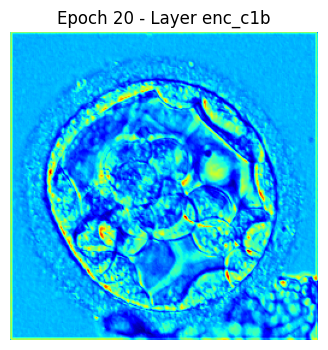

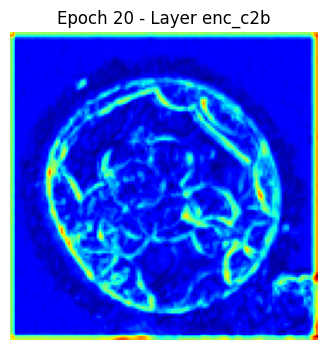

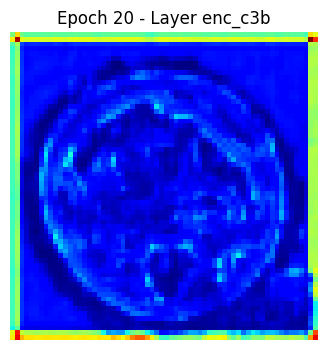

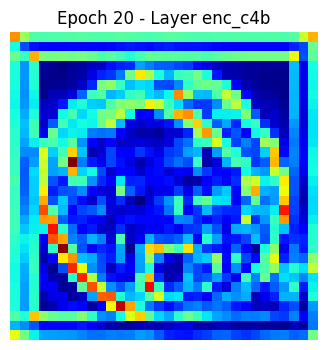

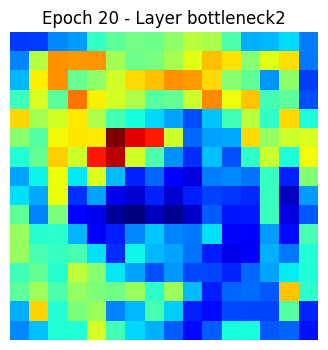

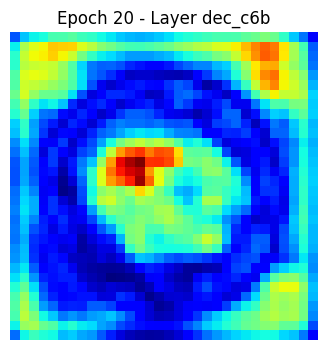

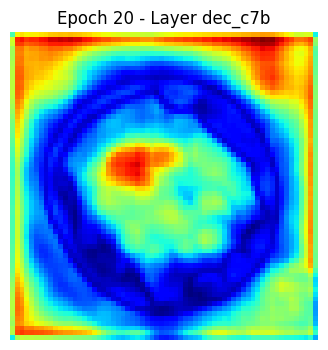

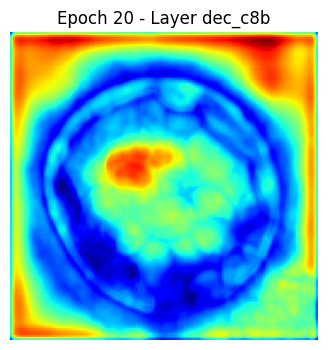

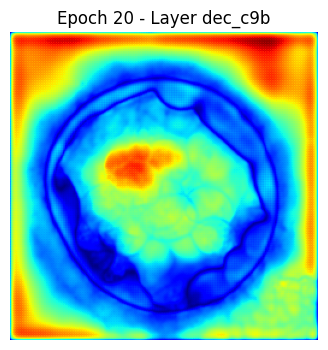

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 226ms/step - accuracy: 0.8630 - dice_coefficient: 0.8700 - iou_metric: 0.7707 - loss: 0.2077 - val_accuracy: 0.8661 - val_dice_coefficient: 0.8064 - val_iou_metric: 0.6789 - val_loss: 0.3186
Epoch 21/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 0.8647 - dice_coefficient: 0.8816 - iou_metric: 0.7889 - loss: 0.1904 - val_accuracy: 0.8640 - val_dice_coefficient: 0.7760 - val_iou_metric: 0.6366 - val_loss: 0.3566
Epoch 22/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 0.8652 - dice_coefficient: 0.8824 - iou_metric: 0.7902 - loss: 0.1882 - val_accuracy: 0.8644 - val_dice_coefficient: 0.7878 - val_iou_metric: 0.6528 - val_loss: 0.3427
Epoch 23/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 0.8659 - dice_coefficient: 0.8914 - iou_metric: 0.8045 - loss: 0.1746 - val_accuracy: 0.8636 - val_dice_coefficient: 0.8066 - val_iou_metric: 0.6785 - val_loss: 0.3182
Epoch 24/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accura

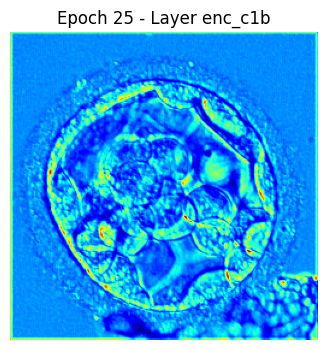

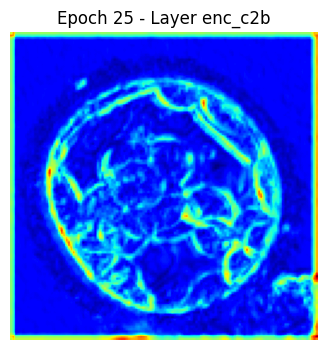

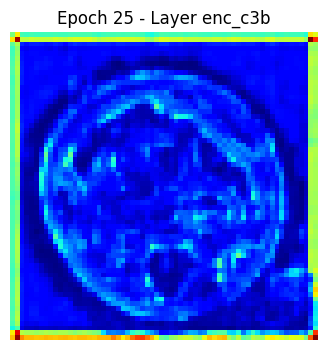

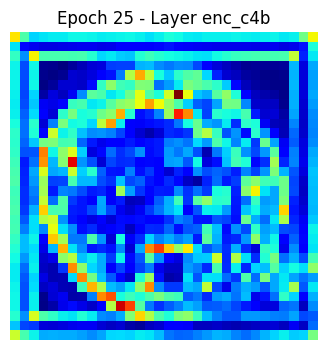

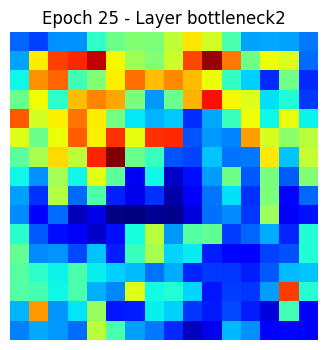

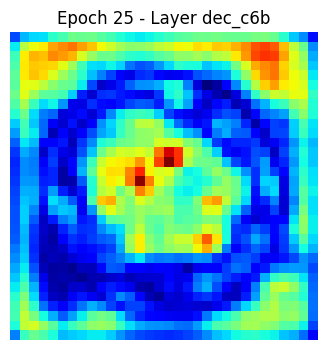

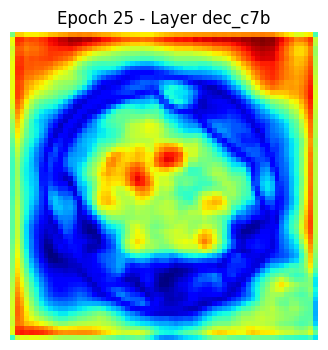

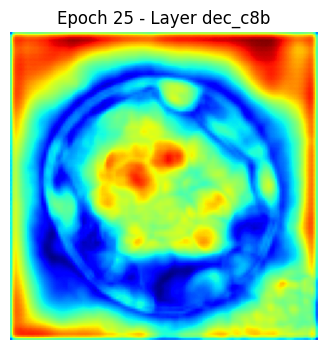

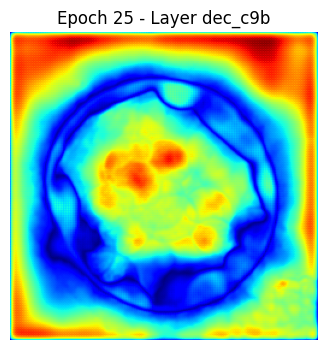

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 226ms/step - accuracy: 0.8668 - dice_coefficient: 0.8963 - iou_metric: 0.8129 - loss: 0.1665 - val_accuracy: 0.8574 - val_dice_coefficient: 0.7844 - val_iou_metric: 0.6479 - val_loss: 0.3846
Epoch 26/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 0.8663 - dice_coefficient: 0.8991 - iou_metric: 0.8173 - loss: 0.1618 - val_accuracy: 0.8635 - val_dice_coefficient: 0.7909 - val_iou_metric: 0.6570 - val_loss: 0.3661
Epoch 27/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 0.8675 - dice_coefficient: 0.9062 - iou_metric: 0.8291 - loss: 0.1497 - val_accuracy: 0.8674 - val_dice_coefficient: 0.8007 - val_iou_metric: 0.6710 - val_loss: 0.3555
Epoch 28/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 218ms/step - accuracy: 0.8680 - dice_coefficient: 0.9117 - iou_metric: 0.8381 - loss: 0.1411 - val_accuracy: 0.8661 - val_dice_coefficient: 0.7994 - val_iou_metric: 0.6691 - val_loss: 0.3642


Model: "UNet_with_CAB"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c1a (Conv2D)    │ (None, 256, 256,  │        640 │ input_layer[0][0] │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c1b (Conv2D)    │ (None, 256, 256,  │     36,928 │ enc_c1a[0][0]     │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1               │ (None, 128, 128,  │          0 │ enc_c1b[0][0]     │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c2a (Conv2D)    │ (None, 128, 128,  │     73,856 │ pool1[0][0]       │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c2b (Conv2D)    │ (None, 128, 128,  │    147,584 │ enc_c2a[0][0]     │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool2               │ (None, 64, 64,    │          0 │ enc_c2b[0][0]     │
│ (MaxPooling2D)      │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c3a (Conv2D)    │ (None, 64, 64,    │    295,168 │ pool2[0][0]       │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c3b (Conv2D)    │ (None, 64, 64,    │    590,080 │ enc_c3a[0][0]     │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool3               │ (None, 32, 32,    │          0 │ enc_c3b[0][0]     │
│ (MaxPooling2D)      │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c4a (Conv2D)    │ (None, 32, 32,    │  1,180,160 │ pool3[0][0]       │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c4b (Conv2D)    │ (None, 32, 32,    │  2,359,808 │ enc_c4a[0][0]     │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool4               │ (None, 16, 16,    │          0 │ enc_c4b[0][0]     │
│ (MaxPooling2D)      │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bottleneck1         │ (None, 16, 16,    │  4,719,616 │ pool4[0][0]       │
│ (Conv2D)            │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bottleneck2         │ (None, 16, 16,    │  9,438,208 │ bottleneck1[0][0] │
│ (Conv2D)            │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ CAB                 │ [(None, 256, 256, │      9,920 │ enc_c1b[0][0],    │
│ (ChannelAttentionB… │ 64), (None, 128,  │            │ enc_c2b[0][0],    │
│                     │ 128, 128), (None, │            │ enc_c3b[0][0],    │
│                     │ 64, 64, 256),     │            │ enc_c4b[0][0],  

 Total params: 93,121,541 (355.23 MB)

 Trainable params: 31,040,513 (118.41 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 62,081,028 (236.82 MB)

GFLOPs calculation not available, use tensorflow profiler for exact computation.
Training time for fold 5: 641.64s


In [9]:
# -------------------------
# Training loop with K-Fold
# -------------------------
EPOCHS = 300
BATCH_SIZE = 8

early_stopping = EarlyStopping(
    monitor='val_dice_coefficient',
    patience=10,
    mode='max',
    restore_best_weights=True
)

checkpoint = ModelCheckpoint(
    "best_model.h5",
    monitor='val_dice_coefficient',
    save_best_only=True,
    mode='max'
)

image_paths = np.array(sorted(glob.glob(os.path.join(TRAIN_IMAGES_DIR, "*.bmp"))))
mask_paths  = np.array(sorted(glob.glob(os.path.join(TRAIN_MASKS_DIR, "*.bmp"))))

kfold = KFold(n_splits=5, shuffle=True, random_state=42)
fold_num = 1

for train_idx, val_idx in kfold.split(image_paths):
    print(f"\n--- Fold {fold_num} ---")

    train_images, train_masks = image_paths[train_idx], mask_paths[train_idx]
    val_images, val_masks = image_paths[val_idx], mask_paths[val_idx]

    # -------------------------
    # Dataset creation
    # -------------------------
    def dataset_from_paths(images, masks, shuffle=True):
        dataset = tf.data.Dataset.from_tensor_slices((images, masks))
        dataset = dataset.map(load_image, num_parallel_calls=tf.data.AUTOTUNE)
        if shuffle:
            dataset = dataset.shuffle(100)
        return dataset.batch(BATCH_SIZE).prefetch(tf.data.AUTOTUNE)

    train_dataset = dataset_from_paths(train_images, train_masks)
    val_dataset = dataset_from_paths(val_images, val_masks, shuffle=False)
        # -------------------------
    # Build model
    # -------------------------
    model = unet_with_channel_attention(input_shape=(256,256,1))
    model.compile(
        optimizer=tf.keras.optimizers.Adam(learning_rate=1e-4),
        loss=bce_dice_loss,
        metrics=['accuracy', dice_coefficient, iou_metric]
    )
        # -------------------------
    # Feature extractor for attention visualization
    # -------------------------
    layer_names = [
       'enc_c1b', 'enc_c2b', 'enc_c3b', 'enc_c4b', 'bottleneck2',
       'dec_c6b', 'dec_c7b', 'dec_c8b', 'dec_c9b'
    ]
    intermediate_outputs = [model.get_layer(name).output for name in layer_names]
    feature_model = tf.keras.Model(inputs=model.input, outputs=intermediate_outputs)

    # Sample image for attention visualization
    sample_image = load_only_image(val_images[0])
    sample_image = tf.expand_dims(sample_image, axis=0)  # Add batch dimension
        # -------------------------
    # Custom callback for attention maps
    # -------------------------
    class AttentionMapLogger(tf.keras.callbacks.Callback):
        def __init__(self, sample_image, every_n_epochs=5):
            super().__init__()
            self.sample_image = sample_image
            self.every_n_epochs = every_n_epochs

        def on_epoch_end(self, epoch, logs=None):
            if (epoch + 1) % self.every_n_epochs == 0:
                attention_features = feature_model(self.sample_image, training=False)
                for i, fmap in enumerate(attention_features):
                    fmap_mean = tf.reduce_mean(fmap, axis=-1)  # average over channels
                    fmap_img = tf.squeeze(fmap_mean).numpy()
                    plt.figure(figsize=(4,4))
                    plt.imshow(fmap_img, cmap='jet')
                    plt.title(f"Epoch {epoch+1} - Layer {layer_names[i]}")
                    plt.axis('off')
                    plt.show()

    attention_logger = AttentionMapLogger(sample_image, every_n_epochs=5)

    # -------------------------
    # Train
    # -------------------------
    start_time = time.time()
    history = model.fit(
        train_dataset,
        validation_data=val_dataset,
        epochs=EPOCHS,
        callbacks=[early_stopping, checkpoint, attention_logger]
    )
    end_time = time.time()
        # -------------------------
    # Model summary, GFLOPs, training time
    # -------------------------
    model.summary()
    try:
        from tensorflow.python.profiler import model_analyzer
        from tensorflow.python.profiler.option_builder import ProfileOptionBuilder
        profile = model_analyzer.profile(
            model, options=ProfileOptionBuilder.float_operation()
        )
        print(f"GFLOPs: {profile.total_float_ops / 1e9}")
    except:
        print("GFLOPs calculation not available, use tensorflow profiler for exact computation.")

    print(f"Training time for fold {fold_num}: {end_time - start_time:.2f}s")
    fold_num += 1




In [10]:
# -------------------------
# Load best model
# -------------------------
model = unet_with_channel_attention(input_shape=(256, 256, 1))
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=1e-4),
              loss=bce_dice_loss,
              metrics=['accuracy', dice_coefficient, iou_metric])

model.load_weights("best_model.h5")


# -------------------------
# Evaluate on test set
# -------------------------
results = model.evaluate(test_dataset)
print("\nTest Results:")
for name, value in zip(model.metrics_names, results):
    print(f"{name}: {value:.4f}")

25/25 ━━━━━━━━━━━━━━━━━━━━ 4s 15ms/step - accuracy: 0.9615 - dice_coefficient: 0.8380 - iou_metric: 0.7248 - loss: 0.4578

Test Results:
loss: 0.3910
compile_metrics: 0.9665


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


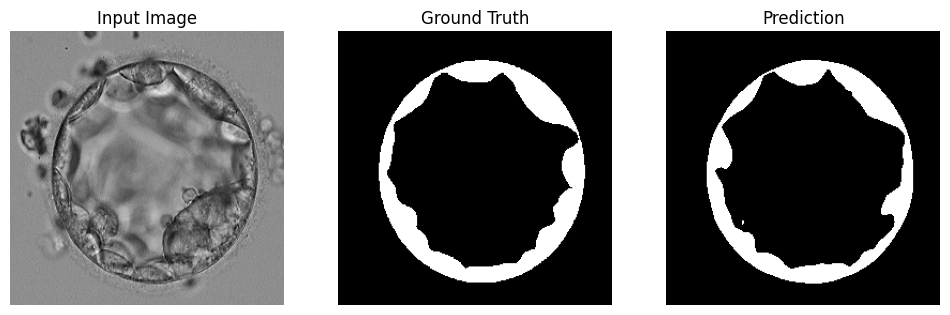

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


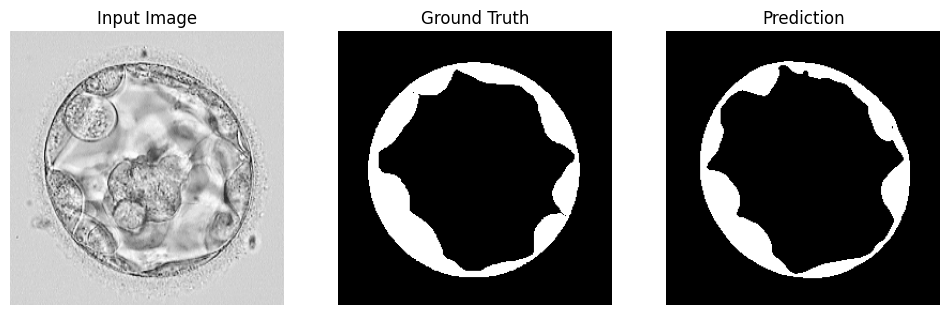

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step


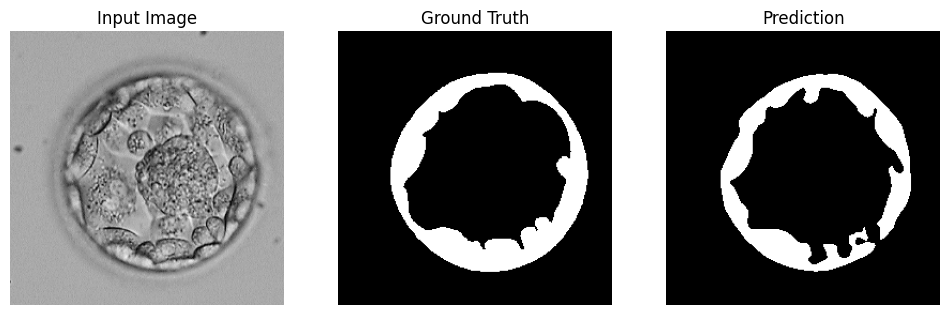

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step


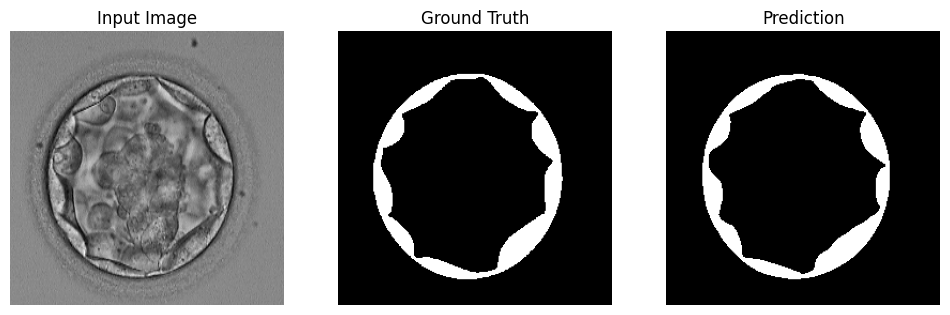

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step


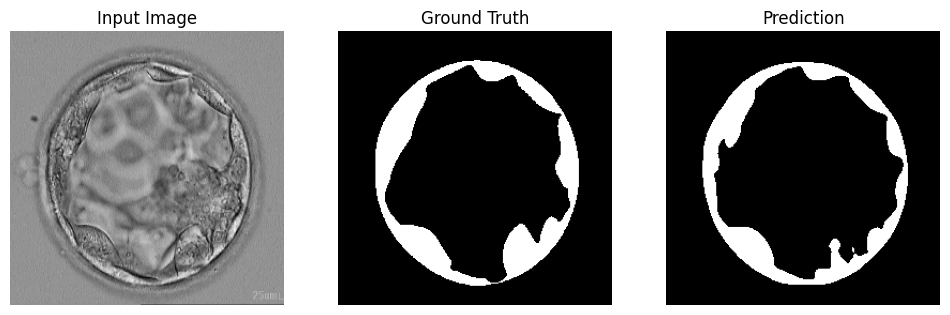

In [11]:
def display_predictions(model, dataset, num_samples=5):
    for batch_idx, (images, masks) in enumerate(dataset.take(num_samples)):
        preds = model.predict(images)
        preds = (preds > 0.5).astype("float32")  # Binarize predictions

        for i in range(len(images)):
            plt.figure(figsize=(12, 4))

            plt.subplot(1, 3, 1)
            plt.title("Input Image")
            plt.imshow(images[i].numpy().squeeze(), cmap="gray")
            plt.axis("off")

            plt.subplot(1, 3, 2)
            plt.title("Ground Truth")
            plt.imshow(masks[i].numpy().squeeze(), cmap="gray")
            plt.axis("off")

            plt.subplot(1, 3, 3)
            plt.title("Prediction")
            plt.imshow(preds[i].squeeze(), cmap="gray")
            plt.axis("off")

            plt.show()


display_predictions(model, test_dataset, num_samples=5)